In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install pythainlp
!pip install attacut

!pip install emoji

!pip install gensim
!pip install python-Levenshtein

In [3]:
# !pip install tensorflow deepcut
# !pip install lekcut

In [4]:
import pandas as pd

In [5]:
# imort necessary module
import numpy as np
import pandas as pd
import itertools

import emoji
import re
import string

import pythainlp
import attacut

from random import choice
from collections import Counter

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

from pythainlp.corpus import thai_stopwords, thai_words, thai_syllables, thai_family_names, thai_female_names, thai_male_names
from pythainlp.corpus.ttc import word_freqs
from pythainlp.util import normalize
from pythainlp.tokenize import Tokenizer, word_tokenize
from pythainlp.spell import spell, correct

import gensim
from gensim import corpora
from gensim.models import TfidfModel, LsiModel, LdaModel
from gensim.models.coherencemodel import CoherenceModel

In [6]:
!pip install pyLDAvis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 25.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.0/298.0 KB 23.0 MB/s eta 0:00:00
  Attempting uninstall: joblib
    Found existing installation: joblib 1.1.1
    Uninstalling joblib-1.1.1:
      Successfully uninstalled joblib-1.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pandas-profiling 3.2.0 requires joblib~=1.1.0, but you have joblib 1.2.0 which is incompatible.


In [7]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

pyLDAvis.enable_notebook()

In [8]:
# show all data
pd.set_option("display.max_colwidth", -1)
pd.set_option('display.max_rows', None)

<ipython-input-8-96087f8f06a9>:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option("display.max_colwidth", -1)


In [ ]:
# Set plot option
# Retina display
%config InlineBackend.figure_format = 'retina'

# Thai font
matplotlib.font_manager.fontManager.addfont('/content/THSarabunNew.ttf')
matplotlib.rc('font', family = 'TH Sarabun New', size = 20)

# Clean

## Import

In [ ]:
df_filtered1_bigram1_trigram1 = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/dataset_filtered1_bigram_trigram.csv')
df_keep = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/dataset_keep.csv')

In [ ]:
print("there're {} tweets left".format(df_filtered1_bigram1_trigram1.shape[0]))
print("there're {} tweets ready".format(df_keep.shape[0]))
print("total    {} tweets".format(df_filtered1_bigram1_trigram1.shape[0] + df_keep.shape[0]))

there're 20857 tweets left
there're 20057 tweets ready
total    40914 tweets


In [ ]:
print("there're {} tweets left".format(df_filtered1_bigram1_trigram1.shape[0]))
print("there're {} tweets ready".format(df_keep.shape[0]))
print("total    {} tweets".format(df_filtered1_bigram1_trigram1.shape[0] + df_keep.shape[0]))

there're 20857 tweets left
there're 20048 tweets ready
total    40905 tweets


In [ ]:
df = pd.concat([df_filtered1_bigram1_trigram1, df_keep], ignore_index=True)

In [ ]:
df.shape[0]

40312

In [ ]:
df.shape[0]

43344

In [ ]:
df.shape[0]

40129

In [ ]:
df.shape[0]

40914

In [ ]:
df.shape[0]

40905

In [ ]:
df.provider.value_counts()

lineman       28000
grab          9244 
shopeefood    1274 
robinhood     1219 
foodpanda     868  
Name: provider, dtype: int64

In [ ]:
df.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/dataset_merge.csv', index=False)

## Clean Irrelevant Tweets (SKIP THIS PROCESS)

In [ ]:
def display_tweet_by_query(query, df):
    print('{} tweets'.format(df['clenedText'].str.contains(query, case=False).sum()))
    print(df[df['clenedText'].str.contains(query, case=False)]['clenedText'])

def drop_tweets_by_word_from_list(df, wordlist):
    num_deleted_tweet = 0
    for word in wordlist:
        print("{} : {} tweets".format(word, df['clenedText'].str.contains(word, case=False).sum()))
        num_deleted_tweet += df['clenedText'].str.contains(word, case=False).sum()
        df = df[~df['clenedText'].str.contains(word, case=False)]
    print('-----------------------------------------')
    print("total deleted tweets from this list : {}".format(num_deleted_tweet))
    print('-----------------------------------------')
    return df

In [ ]:
def compute_ngram(text_tokens, n):
    tokens = []
    if len(text_tokens) >= n:
        for i in range(len(text_tokens)):
            token_list = []
            if i == len(text_tokens) - (n-1):
                break
            for j in range(n):
                if i+j >= len(text_tokens):
                    break
                if text_tokens[i+j] == ' ':
                    continue
                else: token_list.append(text_tokens[i+j])
            ngram = ' '.join(token_list) + ', ' + ''.join(token_list)
            tokens.append(ngram)
        return tokens
    else:
        print(text_tokens)
        return "this tweet's shorter than n_gram"

In [ ]:
def keep_tweets_by_wordlist(df_origi, df_append, query_list):
    num_keep_tweets = 0
    for word in query_list:
        print("{} : {} tweets".format(word, str(df_origi['clenedText'].str.contains(word, case=False).sum())))
        num_keep_tweets += df_origi['clenedText'].str.contains(word, case=False).sum()
        df_append = df_append.append(df_origi[df_origi['clenedText'].str.contains(word, case=False)], ignore_index=True)
        df_origi.drop(df_origi[df_origi['clenedText'].str.contains(word, case=False)].index, inplace=True)
    print('-----------------------------------------')
    print("total appened tweets from this query list : {}".format(num_keep_tweets))
    print("total appened tweets : {}".format(df_append.shape[0]))
    print("remain tweets : {}".format(df_origi.shape[0]))
    print('-----------------------------------------')
    return df_origi, df_append

### only one word

In [ ]:
df['tokens'] = df['clenedText'].apply(lambda x: pythainlp.word_tokenize(x, engine='newmm', keep_whitespace=False))

In [ ]:
list_of_word = df['tokens'].explode().to_list()
freq_ = Counter(list_of_word)
freq_.most_common()

[('ไลน์', 7599),
 ('แมน', 7516),
 ('ไม่', 4876),
 ('มา', 3453),
 ('ไป', 3033),
 ('แล้ว', 3003),
 ('สั่ง', 2884),
 ('เลย', 2716),
 ('จะ', 2670),
 ('ได้', 2642),
 ('ก็', 2613),
 ('ส่ง', 2278),
 ('มี', 2250),
 ('ให้', 2101),
 ('แต่', 2028),
 ('กุ', 2003),
 ('มาก', 1997),
 ('ที่', 1925),
 ('grab', 1836),
 ('คือ', 1724),
 ('พี่', 1644),
 ('ว่า', 1642),
 ('#', 1627),
 ('ละ', 1583),
 ('ใน', 1559),
 ('นะ', 1449),
 ('ร้าน', 1431),
 ('Grab', 1424),
 ('ๆ', 1291),
 ('ค่า', 1276),
 ('กด', 1270),
 ('กิน', 1261),
 ('กู', 1186),
 ('มัน', 1154),
 ('เป็น', 1124),
 ('อะ', 1054),
 ('ของ', 1052),
 ('รับ', 1042),
 ('กับ', 1038),
 ('อยาก', 988),
 ('คน', 987),
 ('อยู่', 936),
 ('บาท', 936),
 ('ต้อง', 895),
 ('ใช้', 882),
 ('อีก', 876),
 ('ข้าว', 849),
 ('นี่', 823),
 ('เรา', 809),
 ('งง', 808),
 ('แบบ', 807),
 ('กว่า', 795),
 ('ยัง', 770),
 ('นี้', 763),
 ('กก', 752),
 ('ลด', 735),
 ('รอ', 731),
 ('หิว', 697),
 ('อะไร', 681),
 ('แก', 676),
 ('บอก', 672),
 ('ด้วย', 668),
 ('โค้ด', 654),
 ('วันนี้', 634),
 ('ออ

In [ ]:
df = drop_tweets_by_word_from_list(df, ['เพลง', 'กรรมการ', 'เย็ด', 'driver'])

เพลง : 63 tweets
กรรมการ : 18 tweets
เย็ด : 9 tweets
-----------------------------------------
total deleted tweets from this list : 90
-----------------------------------------


### Bigram

In [ ]:
list_bigram = df['clenedText'].apply(lambda x: pythainlp.word_tokenize(x, engine='newmm', keep_whitespace=False)).apply(lambda x: compute_ngram(x, 2)).explode().to_list()
freq_bigram = Counter(list_bigram)
freq_bigram.most_common()

[('ไลน์ แมน, ไลน์แมน', 7449),
 ('ค่า ส่ง, ค่าส่ง', 752),
 ('พี่ ไลน์, พี่ไลน์', 668),
 ('ไม่ ได้, ไม่ได้', 514),
 ('มา ส่ง, มาส่ง', 457),
 ('อยาก กิน, อยากกิน', 394),
 ('ไม่ มี, ไม่มี', 342),
 ('ก็ ไม่, ก็ไม่', 334),
 ('แมน มา, แมนมา', 321),
 ('ยัง ไม่, ยังไม่', 319),
 ('สั่ง ข้าว, สั่งข้าว', 317),
 ('แมน ไม่, แมนไม่', 311),
 ('โทร มา, โทรมา', 306),
 ('กก กก, กกกก', 301),
 ('แมน มี, แมนมี', 300),
 ('ใน ไลน์, ในไลน์', 292),
 ('รับ ออเดอร์, รับออเดอร์', 286),
 ('ไม่ รับ, ไม่รับ', 268),
 ('line man, lineman', 267),
 ('สั่ง ไลน์, สั่งไลน์', 254),
 ('ไม่ รู้, ไม่รู้', 251),
 ('บอ กว่า, บอกว่า', 226),
 ('จะ สั่ง, จะสั่ง', 219),
 ('แม่ ง, แม่ง', 215),
 ('โค้ด ลด, โค้ดลด', 214),
 ('ไม่ เคย, ไม่เคย', 205),
 ('แอ ป, แอป', 198),
 ('กด สั่ง, กดสั่ง', 186),
 ('ได้ เลย, ได้เลย', 177),
 ('สั่ง grab, สั่งgrab', 177),
 ('แมน ก็, แมนก็', 176),
 ('ไป ไหน, ไปไหน', 175),
 ('แมน ล่ม, แมนล่ม', 175),
 ('กับ ไลน์, กับไลน์', 173),
 ('จะ ได้, จะได้', 170),
 ('ไป แล้ว, ไปแล้ว', 167),
 ('สต ก, สตก', 166),
 ('แมน ร

In [ ]:
display_tweet_by_query('gt', df)

113 tweets
663      สถิติเข้าไลน์แมนบ่อยสุดตอนไหน =&gt; หลังเที่ยงคืน                                                                                                                                                                                                                                                      
767      &gt;สั่งไลน์แมน &gt;คนมาส่งใส่ชุดฟู้ดแพนด้า &gt;??????????                                                                                                                                                                                                                                             
1122     วงใน —-&gt; ไลน์แมน ?55555                                                                                                                                                                                                                                                                             
3615     อีก 1 รุ่น เอาไว้กดงาน #ไลน์แมน และ #Robinhoon #Realme GT NEO 2 ส

In [ ]:
bigram_misc = [
    'ไถไลน์', 'นัดกอด', 'ฝนตก'
]

In [ ]:
df = drop_tweets_by_word_from_list(df, bigram_misc)

ไถไลน์ : 53 tweets
นัดกอด : 6 tweets
-----------------------------------------
total deleted tweets from this list : 59
-----------------------------------------


### Trigram

In [ ]:
list_trigram = df['clenedText'].apply(lambda x: pythainlp.word_tokenize(x, engine='newmm', keep_whitespace=False)).apply(lambda x: compute_ngram(x, 3)).explode().to_list()
freq_trigram = Counter(list_trigram)
freq_trigram.most_common()

['ความผิด', 'Grab']
['เอาเลย', 'มั้ย']
['รัก', 'นะคะ']


[('พี่ ไลน์ แมน, พี่ไลน์แมน', 668),
 ('ไลน์ แมน มา, ไลน์แมนมา', 314),
 ('ไลน์ แมน ไม่, ไลน์แมนไม่', 307),
 ('ไลน์ แมน มี, ไลน์แมนมี', 299),
 ('ใน ไลน์ แมน, ในไลน์แมน', 278),
 ('สั่ง ไลน์ แมน, สั่งไลน์แมน', 254),
 ('ไลน์ แมน ก็, ไลน์แมนก็', 175),
 ('ไลน์ แมน ล่ม, ไลน์แมนล่ม', 175),
 ('กับ ไลน์ แมน, กับไลน์แมน', 171),
 ('ไลน์ แมน รับ, ไลน์แมนรับ', 163),
 ('แมน ไม่ รับ, แมนไม่รับ', 146),
 ('ไลน์ แมน ไป, ไลน์แมนไป', 140),
 ('ไลน์ แมน จะ, ไลน์แมนจะ', 135),
 ('ไลน์ แมน โทร, ไลน์แมนโทร', 125),
 ('แมน มา ส่ง, แมนมาส่ง', 122),
 ('กด ไลน์ แมน, กดไลน์แมน', 117),
 ('ไลน์ แมน คือ, ไลน์แมนคือ', 112),
 ('แต่ ไลน์ แมน, แต่ไลน์แมน', 110),
 ('แมน โทร มา, แมนโทรมา', 105),
 ('ไลน์ แมน ที่, ไลน์แมนที่', 103),
 ('ส่ง ไลน์ แมน, ส่งไลน์แมน', 103),
 ('ว่า ไลน์ แมน, ว่าไลน์แมน', 102),
 ('ไลน์ แมน มัน, ไลน์แมนมัน', 102),
 ('กก กก กก, กกกกกก', 100),
 ('มี ไลน์ แมน, มีไลน์แมน', 95),
 ('ไลน์ แมน ส่ง, ไลน์แมนส่ง', 94),
 ('ไลน์ แมน แล้ว, ไลน์แมนแล้ว', 92),
 ('ไลน์ แมน ได้, ไลน์แมนได้', 91),
 ('มี สต ก, มีสตก', 91),
 

In [ ]:
display_tweet_by_query('^(?!.*(ประทับใจ|นาน|หิว|ไว|พูดจา|น่ารัก|รถ|ไรเดอร์|แมพ|แผนที่|เพิ่ม|น้อย|vat|น่ากิน|รีวิว|ถูก|ล่ม|ค่าส่ง|เร็ว|แพง|ลด|ออเดอร์.*ผิด|ขั้นต่ำ|อัพ|หัก|ร้องไห้|แฮปปี้|จ่าย|ล็อคอิน|ล็อกเอ้าท์|เข้าสู่|คืนตัง|ธนาคาร|ผูกกับ)).*(ไลน์แมนมา[^ก]).*$', df)

<ipython-input-432-839b0d3433c2>:2: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  print('{} tweets'.format(df['clenedText'].str.contains(query, case=False).sum()))


174 tweets


<ipython-input-432-839b0d3433c2>:3: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  print(df[df['clenedText'].str.contains(query, case=False)]['clenedText'])


60       สั่งขนมจากไลน์แมนมาแต่เปรี้ยวคู่เลยค่ะ บอกก็ไม่เชื่อด้วยนะบอกซื้อมาจากห้างหมด                                                                                                                                                                                                           
87       มีผช.สั่งอะเมซอนแล้วให้ไลน์แมนมาส่งให้ เบื่อความสวยตัวเองว่ะ                                                                                                                                                                                                                            
123      ว่าแต่เมื่อเช้าใครส่งไลน์แมนมาวะ                                                                                                                                                                                                                                                        
126      เกิดมาพี่งเคยสั่งข้าวละออเด้อสลับ ร้านเดียวกัน สั่งสองกล่องเหมือนกัน ไลน์แมนมาส่งพร้อมกัน55555555555555 ละทีนี้ทำไงอะ กิน

In [ ]:
trigram_regex = [
    r'^(?!.*(ประทับใจ|นาน|หิว|ไว|พูดจา|น่ารัก|รถ|ไรเดอร์|แมพ|แผนที่|เพิ่ม|น้อย|vat|น่ากิน|รีวิว|ถูก|ล่ม|ค่าส่ง|เร็ว|แพง|ลด|ออเดอร์.*ผิด|ขั้นต่ำ|อัพ|หัก|ร้องไห้|แฮปปี้|จ่าย|ล็อคอิน|ล็อกเอ้าท์|เข้าสู่|คืนตัง|ธนาคาร|ผูกกับ)).*(พี่ไลน์แมน).*$',
    r'^(?!.*(ประทับใจ|นาน|หิว|ไว|พูดจา|น่ารัก|รถ|ไรเดอร์|แมพ|แผนที่|เพิ่ม|น้อย|vat|น่ากิน|รีวิว|ถูก|ล่ม|ค่าส่ง|เร็ว|แพง|ลด|ออเดอร์.*ผิด|ขั้นต่ำ|อัพ|หัก|ร้องไห้|แฮปปี้|จ่าย|ล็อคอิน|ล็อกเอ้าท์|เข้าสู่|คืนตัง|ธนาคาร|ผูกกับ)).*(ไลน์แมนมา[^ก]).*$'
]

In [ ]:
df = drop_tweets_by_word_from_list(df, trigram_regex)

<ipython-input-432-839b0d3433c2>:8: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  print("{} : {} tweets".format(word, df['clenedText'].str.contains(word, case=False).sum()))
<ipython-input-432-839b0d3433c2>:9: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  num_deleted_tweet += df['clenedText'].str.contains(word, case=False).sum()


^(?!.*(ประทับใจ|นาน|หิว|ไว|พูดจา|น่ารัก|รถ|ไรเดอร์|แมพ|แผนที่|เพิ่ม|น้อย|vat|น่ากิน|รีวิว|ถูก|ล่ม|ค่าส่ง|เร็ว|แพง|ลด|ออเดอร์.*ผิด|ขั้นต่ำ|อัพ|หัก|ร้องไห้|แฮปปี้|จ่าย|ล็อคอิน|ล็อกเอ้าท์|เข้าสู่|คืนตัง|ธนาคาร|ผูกกับ)).*(พี่ไลน์แมน).*$ : 419 tweets


<ipython-input-432-839b0d3433c2>:10: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  df = df[~df['clenedText'].str.contains(word, case=False)]


^(?!.*(ประทับใจ|นาน|หิว|ไว|พูดจา|น่ารัก|รถ|ไรเดอร์|แมพ|แผนที่|เพิ่ม|น้อย|vat|น่ากิน|รีวิว|ถูก|ล่ม|ค่าส่ง|เร็ว|แพง|ลด|ออเดอร์.*ผิด|ขั้นต่ำ|อัพ|หัก|ร้องไห้|แฮปปี้|จ่าย|ล็อคอิน|ล็อกเอ้าท์|เข้าสู่|คืนตัง|ธนาคาร|ผูกกับ)).*(ไลน์แมนมา[^ก]).*$ : 149 tweets
-----------------------------------------
total deleted tweets from this list : 568
-----------------------------------------


In [ ]:
df.shape[0]

11616

In [ ]:
df.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/Data/20220105_NoBannedContent_NoMentionTweet/dataset.csv', index=False)

### 4 Gram

In [ ]:
list_4gram = df_nodup_filtered1_bigram1_trigram1['clenedText'].apply(lambda x: pythainlp.word_tokenize(x, engine='newmm', keep_whitespace=False)).apply(lambda x: compute_ngram(x, 4)).explode().to_list()
freq_4gram = Counter(list_4gram)
freq_4gram.most_common()

['ไลน์', 'แมน', 'เป็นไร']
['ไลน์', 'แมน', 'ส่วนตัว']
['ไลน์', 'แมน', 'คุ้นๆ']
['ไลน์', 'แมน', '**']
['หมายถึง', 'ไลน์', 'แมน']
['ลาก่อน', 'ไลน์', 'แมน']
['รับบท', 'ไลน์', 'แมน']
['ชื่อย่อ', 'ไลน์', 'แมน']
['ความผิด', 'Grab']
['สั่ง', 'grab', 'ค่ะ']
['กางเกงใน', 'เข้า', 'grab']
['มอ', 'นิ่ง', 'ข้าวสาร']
['แย่มาก', 'grab', 'ล่ม']
['Grab', 'เมื่อเช้า', ':']
['อยาก', 'หาร', 'grab']
['ข้าวสาร', 'ทัก', 'คับ']
['เอาเลย', 'มั้ย']
['ชอบ', 'ป่าว', 'ครับ']
['สงสาร', 'grab', 'มากกว่า']
['ขอ', 'ได้', 'มั้ย']
['กี่', 'รอ', 'บดี']
['สั่ง', 'Grab', 'ฝนตก']
['grab', 'เปิด', 'มั้ย']
['พร้อม', 'มั้ย', 'ครับ']
['Grab', 'คือ', 'นิ่ง']
['พี่', 'GRAB', 'ด้วย']
['อยู่รอด', 'เพราะ', 'grab']
['สั่ง', 'grab', 'ตลอดไป']
['เบื่อ', 'เข้า', 'grab']
['คสพ', 'แบบ', 'grab']
['Grab', 'ล่ม', 'เหรอ']
['พรีเซนเตอร์', 'grab', 'เสมอมา']
['เหี้ย', 'มาก', '5555555๕5555555555555555555555555555555555555555555555555555555555']
['รัก', 'นะคะ']
['เลิกใช้', 'Grab', '55']
['วันหลัง', 'สั่ง', 'grab']
['ห่วยแตก', '#', 'shopeefood']


[('ไลน์ แมน มา ส่ง, ไลน์แมนมาส่ง', 99),
 ('ไลน์ แมน โทร มา, ไลน์แมนโทรมา', 55),
 ("this tweet's shorter than n_gram", 37),
 ('พี่ ไลน์ แมน มา, พี่ไลน์แมนมา', 33),
 ('เด ลิ เวอ รี่, เดลิเวอรี่', 32),
 ('แมน มา ส่ง ข้าว, แมนมาส่งข้าว', 31),
 ('สั่ง ข้าว ไลน์ แมน, สั่งข้าวไลน์แมน', 26),
 ('ไลน์ แมน จะ มา, ไลน์แมนจะมา', 25),
 ('ไลน์ แมน คน นี้, ไลน์แมนคนนี้', 23),
 ('กับ พี่ ไลน์ แมน, กับพี่ไลน์แมน', 23),
 ('โค้ด ลด ไลน์ แมน, โค้ดลดไลน์แมน', 22),
 ('กก กก กก กก, กกกกกกกก', 21),
 ('# GrabUnlimited ทาง หนี, #GrabUnlimitedทางหนี', 21),
 ('GrabUnlimited ทาง หนี ที, GrabUnlimitedทางหนีที', 21),
 ('ทาง หนี ที ลด, ทางหนีทีลด', 21),
 ('ให้ พี่ ไลน์ แมน, ให้พี่ไลน์แมน', 20),
 ('มา กก กก กก, มากกกกกก', 19),
 ('สต ก ไลน์ แมน, สตกไลน์แมน', 18),
 ('พี่ ไลน์ แมน จะ, พี่ไลน์แมนจะ', 18),
 ('รู้ ว่า ไลน์ แมน, รู้ว่าไลน์แมน', 17),
 ('แอ ป ไลน์ แมน, แอปไลน์แมน', 16),
 ('ไลน์ แมน แม่ ง, ไลน์แมนแม่ง', 16),
 ('แก รป ไลน์ แมน, แกรปไลน์แมน', 16),
 ('ไลน์ แมน คน เดิม, ไลน์แมนคนเดิม', 16),
 ('สงสาร พี่ ไลน์ แมน, สง

# Data Cleaning

## Concatenate two dataframe

In [ ]:
df_nodup_filtered1_bigram2_trigram2 = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/Data/20220105_NoBannedContent_NoMentionTweet/dataset_nodup_filtered1_bigram2_trigram2.csv')
df_keep = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/Data/20220105_NoBannedContent_NoMentionTweet/dataset_keep.csv')
print("there're {} tweets left".format(df_nodup_filtered1_bigram2_trigram2.shape[0]))
print("there're {} tweets ready".format(df_keep.shape[0]))

there're 7411 tweets left
there're 4441 tweets ready


In [ ]:
df = pd.concat([df_nodup_filtered1_bigram2_trigram2, df_keep], ignore_index=True)
print("total number of tweets : {}".format(df.shape[0]))

total number of tweets : 11852


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/dataset_merge')

In [ ]:
print("total number of tweets : {}".format(df.shape[0]))

total number of tweets : 40312


In [ ]:
tweets = df[['clenedText']].copy()

In [ ]:
df[df['clenedText'].str.contains('ผช')]

## Clean Text in Tweet

In [ ]:
# (\w)\1{2,} searches for any word character followed by two or more of the same character (\1{2,}). 
# then replaces the matched text with the first captured group (\1\1)
def remove_repeated_letter(text):
    return re.sub(r'(\w)\1{2,}', r'\1', text)
# problem : followed by 1++ of the same character ex. วันนี้, 'น' will be removed. FINAL = วันี้ (แบบ, )
#           followed by 2++ of the same character; if the tweet has the wrong spelling word, it'll not be removed ex. ไลน์แมน'น', มาก'ก', หิว'ว'

In [ ]:
def cleanText3(text):
    # newText = re.sub(emoji, '', str(text)) # remove emoji
    # newText = correct_sentence(text, misspelled_dict)
    # newText = remove_providers(newText, provider_words)
    newText = re.sub(r'#([a-zA-Z0-9ก-๙_]+)', '', text) # remove hashtag
    # newText = re.sub(r'[0-9]+', '', text) # remove number
    newText = newText.translate(str.maketrans('', '', string.punctuation)) # remove punctuation
    newText = remove_repeated_letter(newText) # remove repeated letter
    return newText

# def remove_providers(cleanTweet, provider_words):
#     for provider in provider_words:
#         pattern = provider
#         match_ = re.search(provider, cleanTweet)
#         if match_:
#             cleanTweet = re.sub(provider, '', cleanTweet)
#     return cleanTweet

In [ ]:
# text = 'วันนี้สั่ง Grab ใช้ส่วนลดเหลือ ฿100 กินสามมื้อ คุมแม่ต้องภูมิใจ 🥰'
# new_text = re.sub(r"[^a-zA-Z0-9ก-์\s]", "", text)
# new_text

In [ ]:
def get_tokens(tweet, engine='newmm'):
    cleanedTweet = cleanText3(tweet)
    tokens = word_tokenize(cleanedTweet, engine=engine, keep_whitespace=False)
    tokens = [normalize(token) for token in tokens]
    return tokens

In [ ]:
def remove_stopwords(tokens):
    stopwords = list(thai_stopwords())
    return [token for token in tokens if not token in stopwords] 

In [ ]:
def preprocess(tweet, engine):
    cleanedTweet = cleanText3(tweet)
    tokens = word_tokenize(cleanedTweet, engine=engine, keep_whitespace=False)
    tokens = [normalize(token) for token in tokens]
    tokens = remove_stopwords(tokens)
    # print('after normalize : {}'.format(tokens))
    # print('after filtered out stopwords : {}'.format(tokens))
    # tokens = [word for word in tokenText if not word in freqsResults] # remove frequency words
    return tokens

In [ ]:
def display_tweet_by_query(query, df):
    print(df[df['clenedText'].str.contains(query, case=False)]['clenedText'])
    print('{} tweets'.format(df['clenedText'].str.contains(query, case=False).sum()))

In [ ]:
def display_tweets_by_token(series, query_list):
    result = series.apply(lambda list_: all(token in list_ for token in query_list))
    print("{} tweets".format(result.sum()))
    print(series[result])

In [ ]:
def display_tweets_by_tokens(df, tokens_query):
    print("{} tweets".format(df.apply(lambda row: all(token in row['tokens'] for token in tokens_query), axis=1).sum()))
    print(df[df.apply(lambda row: all(token in row['tokens'] for token in tokens_query), axis=1)]['tokens'])

In [ ]:
def display_tokens_with_n_token_length(series, min=1):
    for tokens in series.to_list():
        n_length_token = []
        for token in tokens:
            if len(token) == min:
                n_length_token.append(token)
        if len(n_length_token) > 0:
            print('{} in {}'.format(n_length_token, tokens))

In [ ]:
def find_freq_by_n_token_length(series, min=1):
    n_length_token = []
    for tokens in series.to_list():
        for i, token in enumerate(tokens):
            if len(token) == min:
                n_length_token.append(token)
    freq = Counter(n_length_token)
    print("there're {} tokens with {} character(s)".format(len(list(set(n_length_token))), min))
    return freq

In [ ]:
sample = tweets.sample(n=1)
sample = sample['clenedText'].values[0]

tokens = word_tokenize(sample, engine='attacut', keep_whitespace=False)
print('original tweet: {}'.format(sample))
print(f"\nafter tokenize: {tokens}")
print('preprocessed : {}'.format(preprocess(sample, engine='attacut')))

original tweet: เรื่องตงกวันนี้คือจะสั่งข้าวข้าวไลน์แมน 165 บาท แบบพอเห็นยอดรวมเงินสั่งไม่ลง รู้สึกแพงจัง อห การ์ดใบเดียว300 รับค่ะ แจ้งเลขได้เลย ชีวิตน่าสงสารจัง

after tokenize: ['เรื่อง', 'ตงก', 'วัน', 'นี้', 'คือ', 'จะ', 'สั่ง', 'ข้าวข้าวไลน์แมน', '165', 'บาท', 'แบบ', 'พอ', 'เห็น', 'ยอด', 'รวม', 'เงิน', 'สั่ง', 'ไม่', 'ลง', 'รู้สึก', 'แพง', 'จัง', 'อห', 'การ์ด', 'ใบเดียว300', 'รับ', 'ค่ะ', 'แจ้ง', 'เลข', 'ได้', 'เลย', 'ชีวิต', 'น่า', 'สงสาร', 'จัง']
preprocessed : ['เรื่อง', 'ตงก', 'สั่ง', 'ข้าวข้าวไลน์แมน', '165', 'บาท', 'ยอด', 'เงิน', 'สั่ง', 'รู้สึก', 'แพง', 'อห', 'การ์ด', 'ใบเดียว300', 'แจ้ง', 'เลข', 'ชีวิต', 'สงสาร']


In [ ]:
words = tweets['clenedText'].apply(lambda x: pythainlp.word_tokenize(x, engine='attacut', keep_whitespace=False)).explode().to_list()
thai_stopwords_list = list(thai_stopwords()) ## thai_stopwords() is function
count = len(set(words) & set(thai_stopwords_list))
percent_stopword_in_tweet = round((count/len(thai_stopwords_list)) *100, 2)
stopword_in_tweet = set(thai_stopwords_list).intersection(set(words))
print('total stopword in thai_stopwords_list : {}'.format(len(thai_stopwords_list)))
print('total stopword appearing in tweet (unique counting) : {}'.format(count))
print('percent : {} %'.format(percent_stopword_in_tweet))
print(stopword_in_tweet)

In [ ]:
tokens = tweets['clenedText'].apply(lambda tweet: preprocess(tweet, engine='attacut'))
tokens_ = tokens.explode().to_list()
freq_ = Counter(tokens_)
freq_.most_common()

[('ไลน์แมน', 15536),
 ('สั่ง', 12731),
 ('คน', 6671),
 ('ร้าน', 6369),
 ('grab', 4808),
 ('กุ', 4350),
 ('ข้าว', 4191),
 ('กด', 3893),
 ('กิน', 3892),
 ('5', 3835),
 ('ค่า', 3648),
 ('Grab', 3476),
 ('หิว', 3404),
 ('ตอน', 3331),
 ('ไลน์', 3232),
 ('แมน', 3228),
 ('ทำ', 3199),
 ('อะ', 3048),
 ('เงิน', 2991),
 ('ลด', 2985),
 ('บ้าน', 2698),
 ('อาหาร', 2696),
 ('บาท', 2674),
 ('ดี', 2608),
 ('พี่', 2560),
 ('โทร', 2439),
 ('รอ', 2267),
 ('ขับ', 2047),
 ('งาน', 1946),
 ('เจอ', 1878),
 ('ซื้อ', 1848),
 ('รู้', 1839),
 ('ออเดอร์', 1809),
 ('งง', 1701),
 ('หา', 1695),
 ('โค้ด', 1626),
 ('เค้า', 1598),
 ('เหมือน', 1593),
 ('หน้า', 1577),
 ('ดู', 1566),
 ('ชั้น', 1481),
 ('รอบ', 1432),
 ('หรอ', 1424),
 ('ถาม', 1421),
 ('ยกเลิก', 1416),
 ('ตัว', 1394),
 ('เวลา', 1354),
 ('จ่าย', 1292),
 ('อ่ะ', 1278),
 ('รถ', 1264),
 ('พี่ไลน์แมน', 1263),
 ('คืน', 1244),
 ('ล่ม', 1225),
 ('โดน', 1169),
 ('ลูกค้า', 1168),
 ('food', 1155),
 ('man', 1108),
 ('ชอบ', 1063),
 ('ใส่', 1059),
 ('ราคา', 1030),
 ('1', 10

#### inspect token with only 1 character and removed

In [ ]:
freq = find_freq_by_n_token_length(tokens)
freq.most_common()

there're 202 tokens with 1 character(s)


[('5', 3835),
 ('1', 1016),
 ('2', 970),
 ('3', 598),
 ('฿', 418),
 ('…', 409),
 ('4', 308),
 ('“', 289),
 ('”', 196),
 ('6', 185),
 ('7', 134),
 ('0', 104),
 ('9', 100),
 ('’', 98),
 ('x', 93),
 ('‘', 86),
 ('น', 84),
 ('—', 72),
 ('8', 63),
 ('บ', 53),
 ('ม', 52),
 ('ด', 50),
 ('ก', 46),
 ('อ', 45),
 ('•', 44),
 ('ถ', 42),
 ('T', 32),
 ('ค', 27),
 ('–', 26),
 ('ป', 24),
 ('a', 23),
 ('I', 23),
 ('ร', 21),
 ('‼', 20),
 ('M', 19),
 ('\u2063', 19),
 ('G', 16),
 ('ย', 15),
 ('ಥ', 14),
 ('ส', 14),
 ('̣', 13),
 ('จ', 13),
 ('k', 13),
 ('B', 13),
 ('ท', 12),
 ('༎', 12),
 ('ຶ', 12),
 ('ง', 11),
 ('K', 11),
 ('พ', 11),
 ('y', 11),
 ('D', 10),
 ('ฟ', 10),
 ('n', 9),
 ('N', 9),
 ('A', 9),
 ('´', 9),
 ('s', 8),
 ('ธ', 8),
 ('ไ', 8),
 ('i', 8),
 ('u', 8),
 ('V', 8),
 ('C', 7),
 ('m', 7),
 ('เ', 7),
 ('ต', 7),
 ('ห', 6),
 ('‿', 6),
 ('ซ', 6),
 ('S', 6),
 ('˚', 6),
 ('g', 6),
 ('̆', 6),
 ('L', 6),
 ('×', 6),
 ('ล', 5),
 ('°', 5),
 ('˃', 5),
 ('p', 5),
 ('แ', 5),
 ('t', 5),
 ('Y', 4),
 ('ช', 4),
 ('

In [ ]:
display_tokens_with_n_token_length(tokens, 1)

In [ ]:
display_tweets_by_token(tokens, ['ป'])

24 tweets
1067     [ขำ, ไลน์แมน, ถึงไว, เอ๋อ, 5525252525, ป, สกส่ง, ไลน์แมน, หวาน, เยน, รัก, ง่ะ]                                                                                                            
2013     [ร, ป, ฟลป, กี่, ลูก, แกร๊ปฟุ้ด, ไลน์แมน ฟู้ดแพนด้า, ลูก, สั่ง, สงสาร, อ่ะ, อึดอัด, ดู, เค้า, นกฬ, เด้อ, สู, บ่อ, แม่นศลป, เด้อ]                                                          
2452     [แม่งเอ้ยย, เบอร์, ว่ะ, ไลน์แมน โรบินฮู้ด, แร, ป, แฟลช, สกล, พนง, ย้ำ, พี่, จังหวัด, กรุงเทพ, ย้ำ, 3, รอบ, ถ้วน, สั่ง, พัสดุ, โทรศัพท์, ป่ะ, อห, รอบ, เรื่อง, แล้ง]                       
8262     [ป, สกกลับ, บ้าน, รฟฟ, สาย, สี, แดง, ตอน, ห้า, ทุ่ม, กุล่ก, มืด, วัด, กุกะ, เสี่ยง, เจอผี, กด, ไลน์แมน, ค่า]                                                                              
9151     [ปทจ, พี่ไลน์แมนม้า, กก, อิแกร้บ ฟู้ด, ตก, กะ, ป๋อง, ป]                                                                                                                                   
10258    [

In [ ]:
display_tweets_by_token(tokens, ['ง']) # ง ก ป น ว ด ย *เด* อ ล using newmm algorithm

8 tweets
109      [ไลน์แมน, เดี๋ยวนี้, คน, ตัง, หรอ, ง, อะ]                                                                                                                                                          
758      [อาทิตย์, ง, องมี, ข้าว, ไลน์แมน ฮ่วย, งง, ติด]                                                                                                                                                    
11780    [ง, เจอ, เด่ว, สั่ง, อาหาร, คิดservice, 7, เหรอ, ง]                                                                                                                                                
16374    [เจอ, grab, คน, ง]                                                                                                                                                                                 
18731    [เ ป ง, ค, ง, จี, ง]                                                                                                                                              

In [ ]:
display_tweets_by_token(tokens, ['แม'])

11 tweets
6240     [แม, ค0, บาท, ไลน์, แมน]                                                                                                                              
9382     [เขิน, อะ, สั่ง, น้ำเมนูเดิม, แทบ, ปกติ, สั่ง, ไลน์แมน, ร้าน, กี๊, พนง, ร้าน, แทบ, อ้า, ปาก, สั่ง, กุ, ใส่, หมวก, บัคเก็ต, แม, สอะ]                   
17224    [พี่, Grab, ด่วน, จ่าย, พี่, Grab, Grab, นโยบาย, แมพ, เส้นทาง, สรุป, พระราม 4, แม, พละ, ติด, หนัก, แม่]                                               
20311    [Robinhood, แม, พ, เช่า, api, Maps, มะ, ปกติ, เช่า, มะ]                                                                                               
24756    [ไลน์แมน, ไรอ่ะ, ออเดอร์ซ้อน, ดู, แม, พละ, รู้, คุกกี้, ชิ้น, ร้าน, 10, นาที, ร้าน]                                                                   
31386    [กุ, สบายใจ, ขนาด, กุ, หมา, ห้อง, แทบ, ยุ่, เค้า, ดาว, ห้อง, กิน, ข้าว, สั่ง, ไลน์แมน, ตอน, ตี2, แทบ, คน, แม, ส2, ชั้น, ถอด, ตื่น, เช้า, ก้, บ้าน, กุ]
33831    [ค่า, ไลน์แมน, สอง, บ

In [ ]:
display_tweets_by_token(tokens, ['คอ', 'ล'])

0 tweets
Series([], Name: clenedText, dtype: object)


In [ ]:
tweet = 'จะเข้าไลน์แมนน มึงจะเข้าวรเวิร์สทำไมจะเข้าไปสั่งห่าอะไรในวีเวิร์สสส อันนี้'

In [ ]:
remove_repeated_letter(tweet)

'จะเข้าไลน์แมนน มึงจะเข้าวรเวิร์สทำไมจะเข้าไปสั่งห่าอะไรในวีเวิร์ส อันนี้'

In [ ]:
def remove_tokens(tokens, min=1):
    result = []
    for token in tokens:
        if len(token) > 1:
            result.append(token)
    return result

In [ ]:
tokens_cleaned = tokens.apply(remove_tokens)

### merge token (skip this process)

In [ ]:
# merge token which is only one letter with the previous one ex. 'แอ' + 'ป' = 'แอป'
def merge_token(tokens):
    new_tokens = []
    # print(tokens)
    for i, token in enumerate(tokens):
        # print(token)
        # prevent other special chracter in thai, so use re.search(r'[ก-ฮ]', token)
        # if i == 0 and len(token) == 1 and re.search(r'[ก-ฮ]', token):
        #     merge_token = token + tokens[i+1]
        #     new_tokens.append(merge_token)
        #     tokens.remove(tokens[i+1])
        if i > 0 and len(token) == 1 and re.search(r'[ก-ฮ]', token) and len(tokens[i-1]) != 1:
            merge_token = tokens[i-1] + token
            new_tokens.append(merge_token)
            new_tokens.remove(tokens[i-1])
        # elif len(token) == 1 and re.search(r'[ก-ฮ]', token) and len(tokens[i-1]) == 1:
        #     merge_token = token + tokens[i+1]
        #     new_tokens.append(merge_token)
        else:
            new_tokens.append(token)
        # print(new_tokens)
    return new_tokens

In [ ]:
def merge_token_with_(tokens, query):
    result = []
    for i, token in enumerate(tokens):
        if token == query and (i+1) != len(tokens):
            merged_token = token + tokens[i+1]
            result.append(merged_token)
        elif tokens[i-1] == query:
            continue
        else:
            result.append(token)
    return result

#### merge token (skip this process)

In [ ]:
# merged_tokens = tokens.apply(merge_token)
# tokens_after_merged = merged_tokens.explode().to_list()
# freq_ = Counter(tokens_after_merged)
# freq_.most_common()

In [ ]:
def display_tokens_with_n_token_length(series, min=1):
    for tokens in series.to_list():
        n_length_token = []
        for token in tokens:
            if len(token) == min:
                n_length_token.append(token)
        if len(n_length_token) > 0: 
            print('{} in {}'.format(n_length_token, tokens))        

In [ ]:
def display_tokens_with_n_token_length_by_pos(series, min=1, pos=1):
    for tokens in series.to_list():
        n_length_token = []
        for i, token in enumerate(tokens):
            if len(token) == min and i == (pos-1):
                n_length_token.append(token)
        if len(n_length_token) > 0: 
            print('{} in {}'.format(n_length_token, tokens))      

In [ ]:
def display_all_token_with_n_length(series, min=1):
    n_length_token = []
    for tokens in series.to_list():
        for i, token in enumerate(tokens):
            if len(token) == min:
                n_length_token.append(token)
    freq_ = Counter(n_length_token)
    print("there're {} ".format(list(set(n_length_token))))
    print(freq_.most_common())

In [ ]:
display_tokens_with_n_token_length_by_pos(merged_tokens, 1)

NameError: ignored

In [ ]:
display_tokens_with_n_token_length(merged_tokens, 2)

In [ ]:
display_all_token_with_n_length(merged_tokens, 2)

In [ ]:
display_tweets_by_token(merged_tokens, 'ก')

In [ ]:
display_tweets_by_token(merged_tokens, 'อ')

In [ ]:
display_tweets_by_token(merged_tokens, 'แ')

### remove tweets which contain number of tokens fewer than 2 (skip this process)

In [ ]:
min = 2
tokens_cleaned = tokens_no_stopwords_[tokens_no_stopwords_.apply(len) > min].copy()
print('total tweets: {}'.format((tokens_no_stopwords_.apply(len) <= min).sum()))
print(tokens_no_stopwords_[tokens_no_stopwords_.apply(len) <= min])

total tweets: 528
8        [lineman]                     
15       [lineman, ล่ม]                
37       [สั่ง, lineman]               
40       [lineman, สั่ง]               
44       [lineman, ใช้งาน]             
51       [lineman, เป็นไร]             
55       [lineman, ต้องการ]            
56       [lineman, ลูกค้า]             
84       [ต่อย, lineman]               
100      [lineman, หอ]                 
134      [ข้อดี, lineman]              
138      [แอ, lineman]                 
163      [หิว, lineman]                
219      [lineman, บวก]                
238      [lineman]                     
253      [lineman, วะ]                 
325      [เกิดขึ้น, lineman]           
347      [lineman, หิว]                
397      [lineman, เล่น]               
428      [lineman, น่ากิน]             
446      [lineman, ว่ะ]                
514      [grabfood, lineman]           
526      [lineman, เซเว่น]             
528      [lineman, เสียงหวาน]          
555      [พยาน, หย่า] 

In [ ]:
tokens_cleaned.shape[0]

11103

### check spelling using `correct()`

In [ ]:
def check_misspelling(series): # O(n^2)
    transformed_token = []
    for tokens in series.to_list():
        for i, token in enumerate(tokens):
            new_token = correct(token)
            if new_token != token:
                tuple_ = (token, new_token)
                transformed_token.append(tuple_)
    freq = Counter(transformed_token)
    print("there're {} token transformed".format(len(list(set(transformed_token)))))

In [ ]:
def check_misspelling(series): # O(n)
    transformed_token_counts = {}
    for tokens in series.to_list():
        for i, token in enumerate(tokens):
            new_token = correct(token)
            if new_token != token:
                tuple_ = (token, new_token)
                if tuple_ in transformed_token_counts:
                    transformed_token_counts[tuple_] += 1
                else:
                    transformed_token_counts[tuple_] = 1
    return transformed_token_counts
    print("there're {} token transformed".format(len(transformed_token_counts)))

In [ ]:
def find_misspelling(tokens, i): # O(n)
    misspelling = []
    while i != 0 and i % 150 != 0:
        for token in tokens:
            new_token = correct(token)
            if new_token != token:
                tuple_ = (token, new_token)
                misspelling.append(tuple_)
        if i % 10 == 0:
            print('processing to: {}'.format(i))
        return misspelling

In [ ]:
temp = pd.DataFrame(tokens_cleaned)
temp.head(1)

,clenedText
0,"[งง, ไลน์แมน, คน, ก้, จอด, หน้า, เป๊ะ, คน, นึง, หนัก, สอง, พี่, ซิ่ง, เร้ว, เบรก, หรอ]"


In [ ]:
misspelling = temp.iloc[150:300].apply(lambda row: find_misspelling(row['clenedText'], row.name), axis=1)

processing to: 170
processing to: 180
processing to: 190
processing to: 200
processing to: 210
processing to: 220
processing to: 230
processing to: 250
processing to: 260
processing to: 270
processing to: 280
processing to: 290
processing to: 310


In [ ]:
freq_ = Counter(misspelling.explode().to_list())
freq_.most_common()

[(nan, 60),
 (('แกร็บ', 'แกร็น'), 4),
 (('แกร้บ', 'แกรบ'), 3),
 (('อนุเสาวรีย์', 'อนุสาวรีย์'), 3),
 (('ช้อปปี้', 'ก๊อปปี้'), 2),
 (('พระพรหม', 'พระบรม'), 2),
 (('เหอะ', 'เยอะ'), 2),
 (('กุงง', 'กุ้ง'), 2),
 (('ทั้งๆที่', 'ทั้งที่'), 2),
 (('แกร๊บ', 'แกร๊ก'), 2),
 (('พิซซ่า', 'พลาซ่า'), 2),
 (('ออเดอร์', 'เดอร์'), 2),
 (('ฮัลโหล', 'ฮัลโล'), 2),
 (('ผัดไท', 'ผัด'), 2),
 (('me', 'ใน'), 2),
 (('อีไลน์แมน', 'ไลน์แมน'), 2),
 (('อีควาย', 'ตีความ'), 2),
 (('วัดแขก', 'รับแขก'), 1),
 (('สปตฟ', 'สแตฟ'), 1),
 (('บ้านละ', 'บ้าน'), 1),
 (('คับบ', 'คับ'), 1),
 (('อิสะส', 'อิสระ'), 1),
 (('เลยอ่ะ', 'เยอะ'), 1),
 (('ดีก่า', 'เก่า'), 1),
 (('แท๊กซี่', 'แท็กซี่'), 1),
 (('แมนยู', 'แมน'), 1),
 (('มิโค', 'มิค'), 1),
 (('น้องกุ', 'น้อง'), 1),
 (('2รอบ', 'รอบ'), 1),
 (('โอ้โห', 'โอ้โฮ'), 1),
 (('ไอ้เหี้ย', 'ไข่เหี้ย'), 1),
 (('ละแม่ง', 'แม่ง'), 1),
 (('เสล่อ', 'เสื่อ'), 1),
 (('แบนไลน์', 'ออนไลน์'), 1),
 (('บ้านนุ', 'บ้าน'), 1),
 (('สาธา', 'สาขา'), 1),
 (('หารถ', 'หาร'), 1),
 (('ค้าบ', 'ค้า'), 1),
 (('สตก',

In [ ]:
freq_ = Counter(misspelling.explode().to_list())
freq_.most_common()

[(nan, 68),
 (('ก้', 'ก็'), 5),
 (('แกร้บ', 'แกรบ'), 4),
 (('ออเดอร์', 'เดอร์'), 3),
 (None, 2),
 (('ช้อปปี้', 'ก๊อปปี้'), 2),
 (('ส่งติก', 'ส่งออก'), 2),
 (('หัวควย', 'หัวค่ำ'), 2),
 (('กุละ', 'กุล'), 2),
 (('อีเหี้ย', 'เหี้ย'), 2),
 (('ไลน์แมนมา', 'ไลน์แมน'), 2),
 (('แกร็บ', 'แกร็น'), 2),
 (('พนกลาง', 'คนกลาง'), 1),
 (('อีบ้า', 'บ้า'), 1),
 (('รู้หน้า', 'สู้หน้า'), 1),
 (('สตก', 'สัก'), 1),
 (('ปห', 'ปี'), 1),
 (('จีพีเอส', 'ซีบีเอส'), 1),
 (('อีไลน์แมน', 'ไลน์แมน'), 1),
 (('วีนกู', 'วีนัส'), 1),
 (('ไร๊', 'ไร้'), 1),
 (('กุอาบ', 'กรอบ'), 1),
 (('หึ้ยย', 'ห้อย'), 1),
 (('รักก', 'รัก'), 1),
 (('เริส', 'คริส'), 1),
 (('เซลฟี่', 'เยลลี่'), 1),
 (('ทำดา', 'ทำนา'), 1),
 (('ลดไลน์แมน', 'ไลน์แมน'), 1),
 (('รักเว่อ', 'ชักเย่อ'), 1),
 (('แมนพิมพ์', 'แม่พิมพ์'), 1),
 (('เอกบัว', 'ดอกบัว'), 1),
 (('วีน', 'วัน'), 1),
 (('จิงๆ', 'จิง'), 1),
 (('โอร้ย', 'โอ้ย'), 1),
 (('กุเอ็นดู', 'เอ็นดู'), 1),
 (('เคชื่อน', 'เคลื่อน'), 1),
 (('แม่ไม', 'แม่นม'), 1),
 (('ไ่ด้', 'ได้'), 1),
 (('มากุ', 'มาก'), 1),
 

In [ ]:
# ADD MORE WORD in custom_stop using regex to extract all provider's name pattern
# ADD MORE WORD in thai_stopwords by category

In [ ]:
from pythainlp.spell import NorvigSpellChecker

spell_checker = NorvigSpellChecker(tokens.explode().to_list())

misspelled_word = "ก้"
corrected_word = spell_checker.correct(misspelled_word)

print(corrected_word)

ก้


# Modeling

In [ ]:
def remove_repeated_letter(text):
    return re.sub(r'(\w)\1{2,}', r'\1', text)

def cleanText(text):
    # newText = re.sub(emoji, '', str(text)) # remove emoji
    # newText = correct_sentence(text, misspelled_dict)
    # newText = remove_providers(newText, provider_words)
    newText = re.sub(r'#([a-zA-Z0-9ก-๙_]+)', '', text) # remove hashtag
    # newText = re.sub(r'[0-9]+', '', text) # remove number
    newText = newText.translate(str.maketrans('', '', string.punctuation)) # remove punctuation
    newText = remove_repeated_letter(newText) # remove repeated letter
    return newText

def remove_stopwords(tokens):
    stopwords = list(thai_stopwords())
    return [token for token in tokens if not token in stopwords] 

def remove_tokens(tokens, min=1):
    result = []
    for token in tokens:
        if len(token) > 1:
            result.append(token)
    return result

def preprocess(tweet, engine):
    cleanedTweet = cleanText(tweet)
    tokens = word_tokenize(cleanedTweet, engine=engine, keep_whitespace=False)
    tokens = [normalize(token) for token in tokens]
    tokens = remove_stopwords(tokens)
    # print('after normalize : {}'.format(tokens))
    # print('after filtered out stopwords : {}'.format(tokens))
    # tokens = [word for word in tokenText if not word in freqsResults] # remove frequency words
    return tokens

## import data

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/dataset_merge.csv')
tweets = df[['clenedText']].copy()

In [ ]:
tweets.shape[0]

40905

In [ ]:
# tokens = tweets['clenedText'].apply(lambda tweet: remove_tokens(preprocess(tweet, engine = 'attacut')))

## find possible misspelling words of all providers

In [ ]:
all_tokens = tokens.explode().to_list()
freq_ = Counter(all_tokens)
freq_.most_common()

In [ ]:
# in english, don't forget to use .lower() before removing it with re.sub()
provider_dict = {
    'lineman': ['ไลน์แมน', r'(line)\s?(man)'],
    'shopeefood': [r'(shopee)\s?(food)?', r'(ช้อปปี้|ชอปปี้|ช้อปปี้|ชอปปี้|ช็อปปี้)(ฟู้ด)?'],
    'foodpanda': [r'(food)\s?(panda)', 'ฟู้ดแพนด้า', 'ฟู๊ดแพนด้า'],
    'grab': ['(แกร้ป|แกร้บ|แกร็ป|แกร้ป|แกรป|แกร๊บ|แกร๊ป|แกรบ|แกร็บ|แก้ป|แก้บ|แก๊บ)(ฟู้ด)?', r'grab\s?(food)?'], 
             # to replace 'แกร้ป' and 'แกรป', make sure it doesn't follow with ฟู้ด
    'robinhood': ['โรบินฮู้ด', 'โรบินฮู๊ด', 'รบฮ', r'(robin)\s(hood)'],
}

In [ ]:
provider_words = [
    'lineman', 'shopeefood', 'foodpanda', 'grab', 'robinhood'
]

## Function

In [ ]:
provider_dict = {
    'lineman': ['ไลน์แมน', r'(line)\s?(man)'],
    'shopeefood': [r'(shopee)\s?(food)?', r'(ช้อปปี้|ชอปปี้|ช้อปปี้|ชอปปี้|ช็อปปี้)(ฟู้ด)?'],
    'foodpanda': [r'(food)\s?(panda)', 'ฟู้ดแพนด้า', 'ฟู๊ดแพนด้า'],
    'grab': ['(แกร้ป|แกร้บ|แกร็ป|แกร้ป|แกรป|แกร๊บ|แกร๊ป|แกรบ|แกร็บ|แก้ป|แก้บ|แก๊บ)(ฟู้ด)?', r'grab\s?(food)?'], 
             # to replace 'แกร้ป' and 'แกรป', make sure it doesn't follow with ฟู้ด
    'robinhood': ['โรบินฮู้ด', 'โรบินฮู๊ด', 'รบฮ', r'(robin)\s(hood)'],
}

In [ ]:
provider_words = [
    'lineman', 'shopeefood', 'foodpanda', 'grab', 'robinhood'
]

In [ ]:
# cleanText('@hoiju_u1b @PaiChicka ตั้งแต่ใช้มา lineman คือ map ตรงสุดละแม่ แอปอื่นคือตรงแค่ชั้นที่ปักบ้านตัวเอง ฝั่งคนขับไม่เคยจะตรง #ไลน์แมน 90')

In [ ]:
re.sub(r'(&gt;)|(&lt;)', '', '&lt;')

''

In [ ]:
def remove_repeated_letter(text):
    return re.sub(r'(\w)\1{2,}', r'\1', text)

def cleanText(text): # 1
    newText = re.sub(r'#([a-zA-Z0-9ก-์]+)', '', text).strip() # remove hashtag
    newText = re.sub(r'@\w+', '', newText).strip() # remove mentioning to any user
    newText = re.sub(r'[0-9]+', '', newText).strip() # remove number
    newText = re.sub(r'(&gt;)|(&lt;)|(TT)', '', newText) # remove '><' and 'TT'
    newText = newText.translate(str.maketrans('', '', string.punctuation))
    newText = remove_repeated_letter(newText) # remove repeated letter
    return newText

def correct_sentence(sentence, word_dict): # 2
    for correct_word, misspelled_words in word_dict.items():
        for misspelled_word in misspelled_words:
            sentence = re.sub(misspelled_word, correct_word, str(sentence).lower())
            if 'โทรศัพทั์พท์' in sentence:
                print(correct_word)
                print(misspelled_word)
                print(sentence)
    return sentence

def remove_provider(cleanedTweet, provider_words): # 3
    for provider in provider_words:
        cleanedTweet = re.sub(provider, '', cleanedTweet.lower())
    return cleanedTweet
    
def remove_stopwords_and_customwords(tokens, stopwords_and_customwords): # 4
    return [token for token in tokens if not token in stopwords_and_customwords] #Remove Thai stop words and custom words

# def remove_token_by_words(tokens, words): # 5
#     result = []
#     for i, token in enumerate(tokens):
#         for j, word in enumerate(words):
#             if token == word and i < len(tokens) - 1:
#                 tokens.pop(i)
#                 tokens.pop(i)
#     return tokens

def remove_short_token(tokens, min=1): # 5
    result = [ token for token in tokens if len(token) > 1 ]
    return result

def remove_short_tweet(tokens, min=1): # 6
    length = len(tokens)
    if length >= min :
        return tokens
    else:
        None

def preprocess(tweet, engine='attacut', correct_dict=provider_dict, stopwords_and_customwords=list(thai_stopwords())):
    cleanedTweet = cleanText(tweet) # 1
    cleanedTweet = correct_sentence(cleanedTweet, correct_dict) # 2
    cleanedTweet = remove_provider(cleanedTweet, provider_words) # 3
    tokens = word_tokenize(cleanedTweet, engine=engine, keep_whitespace=False) 
    tokens = [normalize(token) for token in tokens]
    # if 'นีั้ก' in tokens:
    #     print(tokens) 
    tokens = remove_stopwords_and_customwords(tokens, stopwords_and_customwords) # 4
    # tokens = remove_token_by_words(tokens, word_with_following) # 5
    tokens = remove_short_token(tokens) # 5
    tokens = remove_short_tweet(tokens, min=2) # 6 
    return tokens 

In [ ]:
def find_surrounding_substring(text, n, substring):
    start = text.find(substring)
    start_range = max(0, start-n)
    front = text[start_range:start]

    end = start + len(substring)
    end_range = min(end+n, len(text))
    behind = text[end:end_range]
    return front + substring + behind

In [ ]:
def find_context_by_token(tokens, lookup_word, lookup_tail=True):
    result = []
    for i, token in enumerate(tokens):
        if token == lookup_word:
            if lookup_tail:
                    if (i+1) != len(tokens):
                        context = token + tokens[i+1] 
                        result.append(context)
                    elif (i+1) == len(tokens): 
                        show = lookup_word + ' is in the end of the sentence'
                        result.append(show)
            elif not lookup_tail:
                    if i != 0:
                        context = tokens[i-1] + token
                        result.append(context)
                    elif i == 0: 
                        show = lookup_word + ' is in the begining of the sentence'
                        result.append(show)
            else: 
                    if i != 0 and token == lookup_word and (i+1) != len(tokens):
                        context = tokens[i-1] + token + tokens[i+1]
                        result.append(context)
                    elif (i == 0 and token == lookup_word) or ((i+1) == len(tokens)):
                        show = lookup_word + ' is in the begining or end of the sentence'
                        result.append(show)
    return result

In [ ]:
def get_num(tokens_in_tweet, wordlist):
    tokens_in_tweets = tokens_in_tweet.explode().to_list()
    num_tokens = len(tokens_in_tweets)
    tokens_unique = set(tokens_in_tweets)
    num_tokens_unique = len(tokens_unique)

    wordlist_unique = set(wordlist)
    num_wordlist = len(wordlist_unique)

    count = len([token for token in tokens_in_tweets if token in wordlist_unique])
    words_from_wordlist_in_tweets = tokens_unique.intersection(wordlist_unique)
    count_unique = len(words_from_wordlist_in_tweets)
    

    percent = round((count/num_tokens) *100, 2)
    percent_unique = round((count_unique/num_tokens_unique)*100, 2)

    wordlist_counter = Counter(wordlist)
    result = {element: tokens_in_tweets.count(element) for element in wordlist_counter.keys()}
    dict_freq = dict(sorted(result.items(), key=lambda x: x[1], reverse=True))

    return num_tokens, num_tokens_unique, num_wordlist, count, count_unique, percent, percent_unique, dict_freq

In [ ]:
def get_k_most_common(data, k):
    counter = Counter(data)
    result = []
    for element, frequency in counter.items():
        if frequency <= k:
            result.append((element, frequency))
    result.sort(key=lambda x: x[1], reverse=True)
    return result

In [ ]:
def get_tokens(tweet, engine='attacut'):
    cleanedTweet = cleanText3(tweet)
    cleanedTweet = correct_sentence(cleanedTweet, merged_dict)
    cleanedTweet = remove_provider(cleanedTweet, provider_words)
    tokens = word_tokenize(cleanedTweet, engine=engine, keep_whitespace=False)
    tokens = [normalize(token) for token in tokens]
    # tokens = merge_token_by_words(tokens, word_with_following)
    return tokens

In [ ]:
def merge_stopwords_and_customwords(lists, remove_list):
    stopwords = list(thai_stopwords())
    for stopword in remove_list:
        if stopword in stopwords:
            stopwords.remove(stopword)
    for list_ in lists:
        stopwords.extend(list_)
    return stopwords

In [ ]:
def compute_ngrams(tokens, n):
    ngrams = []
    for i in range(len(tokens)):
        for j in range(1, n + 1):
            if i + j <= len(tokens):
                ngram = "_".join(tokens[i:i + j])            
                ngrams.append(ngram)
    return ngrams

In [ ]:
def get_ngrams(tokens, n):
    ngrams = []
    for i in range(len(tokens) - n + 1):
        ngram = '_'.join(tokens[i:i+n])
        ngrams.append(ngram)
    return ngrams

In [ ]:
get_ngrams(['อี', 'ควาย'], 2)

['อี_ควาย']

In [ ]:
# def compute_ngrams(tokens, word_dict, n):
#     ngrams = []
#     for i in range(len(tokens)):
#         for j in range(1, n + 1):
#             if i + j <= len(tokens):
#                 ngram_tokens = tokens[i:i + j]
#                 if all(token not in ngrams for token in ngram_tokens):
#                     ngram = "".join(ngram_tokens)
#                     if ngram in word_dict:
#                         ngram = "_".join(ngram_tokens)
#                         ngrams.append(ngram)
#                     else:
#                         ngrams.extend(ngram_tokens)
#     return ngrams

In [ ]:
from pythainlp.tag import pos_tag
pos_tag(['ไปมา'], engine='perceptron', corpus='orchid_ud')

[('ไปมา', 'NOUN')]

In [ ]:
# compute_ngrams(['ค่า', 'ส่ง'], all_tokens_cleaned_2, 2)

## Model 1 : 
1. Misspelling Words 
2. Remove Stopwords

### Preprocess

In [ ]:
cleaned_tokens = tweets['clenedText'].apply(lambda tweet: preprocess(tweet, 
                                                                     engine='attacut',
                                                                     correct_dict=provider_dict,
                                                                     stopwords_and_customwords=list(thai_stopwords())))

KeyboardInterrupt: ignored

In [ ]:
display_tweets_by_token(cleaned_tokens, ['กูะ'])

0 tweets
Series([], Name: clenedText, dtype: object)


In [ ]:
docs = cleaned_tokens.to_list()

In [ ]:
choice(docs)

['เสียง',
 'ร้าน',
 'ออเดอร์',
 'กด',
 'ยกเลิก',
 'กด',
 'ร้าน',
 'ชั่วคราว',
 'กด',
 'ระบบ',
 'บ้าน',
 'แย่',
 'โมโห',
 'เหมือน']

### LDA

#### Susan Li

In [ ]:
dictionary = corpora.Dictionary(docs)
count = 0
for k, v in dictionary.iteritems():
    print(k, v)
    count += 1
    if count > 10:
        break

0 ก้
1 คน
2 งง
3 จอด
4 ซิ่ง
5 นึง
6 พี่
7 สอง
8 หนัก
9 หน้า
10 หรอ


In [ ]:
dictionary.filter_extremes(no_below=15, no_above=0.5, keep_n=100000)

In [ ]:
dictionary.filter_n_most_frequent(10)

In [ ]:
bow_corpus = [dictionary.doc2bow(doc) for doc in docs]
print(docs[0])
bow_corpus[0]

['งง', 'คน', 'ก้', 'จอด', 'หน้า', 'เป๊ะ', 'คน', 'นึง', 'หนัก', 'สอง', 'พี่', 'ซิ่ง', 'เร้ว', 'เบรก', 'หรอ']


[(0, 1),
 (1, 2),
 (2, 1),
 (3, 1),
 (4, 1),
 (5, 1),
 (6, 1),
 (7, 1),
 (8, 1),
 (9, 1),
 (10, 1),
 (11, 1),
 (12, 1),
 (13, 1)]

In [ ]:
tfidf = TfidfModel(bow_corpus)
corpus_tfidf = tfidf[bow_corpus]
from pprint import pprint
for doc in corpus_tfidf:
    pprint(doc)
    break

[(0, 0.24420681201091188),
 (1, 0.21798467778514669),
 (2, 0.17213431164070153),
 (3, 0.26819102722785976),
 (4, 0.33157500650624394),
 (5, 0.21079677616948692),
 (6, 0.14216557664184656),
 (7, 0.21328378288119446),
 (8, 0.23788364768741307),
 (9, 0.17026594259598515),
 (10, 0.1742052970379249),
 (11, 0.4086588449547949),
 (12, 0.3482528768049449),
 (13, 0.4086588449547949)]


In [ ]:
lda_model = LdaMulticore(bow_corpus, num_topics=6, id2word=dictionary, passes=2, workers=2)

In [ ]:
for idx, topic in lda_model.print_topics(-1):
    print('Topic: {} \nWords: {}'.format(idx, topic))

Topic: 0 
Words: 0.042*"ค่า" + 0.036*"ลด" + 0.030*"บาท" + 0.021*"สั่ง" + 0.019*"เงิน" + 0.017*"โค้ด" + 0.013*"กด" + 0.012*"ข้าว" + 0.011*"จ่าย" + 0.011*"งง"
Topic: 1 
Words: 0.027*"คน" + 0.021*"กิน" + 0.017*"สั่ง" + 0.015*"ร้าน" + 0.014*"ทำ" + 0.014*"อะ" + 0.011*"รอ" + 0.010*"หา" + 0.008*"เวลา" + 0.008*"ข้าว"
Topic: 2 
Words: 0.023*"สั่ง" + 0.022*"หิว" + 0.021*"ตอน" + 0.017*"กด" + 0.016*"คน" + 0.015*"เจอ" + 0.011*"รอ" + 0.010*"ล่ม" + 0.009*"กุ" + 0.009*"ลด"
Topic: 3 
Words: 0.029*"พี่" + 0.018*"ข้าว" + 0.015*"หิว" + 0.013*"สตก" + 0.013*"ขับ" + 0.012*"รถ" + 0.011*"หนู" + 0.010*"สั่ง" + 0.010*"ดี" + 0.010*"คน"
Topic: 4 
Words: 0.036*"สั่ง" + 0.035*"ร้าน" + 0.027*"คน" + 0.020*"กิน" + 0.018*"กุ" + 0.018*"ค่า" + 0.015*"กด" + 0.014*"ลด" + 0.014*"อาหาร" + 0.012*"แพง"
Topic: 5 
Words: 0.045*"สั่ง" + 0.020*"เงิน" + 0.014*"คืน" + 0.014*"งาน" + 0.012*"ทำ" + 0.010*"ร้าน" + 0.010*"กิน" + 0.010*"ข้าว" + 0.009*"กุ" + 0.009*"ยกเลิก"


In [ ]:
lda_model_tfidf = LdaMulticore(corpus_tfidf, num_topics=6, id2word=dictionary, passes=2, workers=4)

In [ ]:
for idx, topic in lda_model_tfidf.print_topics(-1):
    print('Topic: {} Word: {}'.format(idx, topic))

Topic: 0 Word: 0.013*"ล่ม" + 0.010*"หิว" + 0.007*"ลด" + 0.007*"ข้าว" + 0.007*"กด" + 0.007*"ค่า" + 0.007*"สั่ง" + 0.006*"อะ" + 0.006*"ตอน" + 0.006*"กิน"
Topic: 1 Word: 0.007*"เงิน" + 0.006*"สั่ง" + 0.006*"ค่า" + 0.005*"ร้าน" + 0.005*"คืน" + 0.004*"รอ" + 0.004*"ขนาด" + 0.004*"ตัด" + 0.004*"รอบ" + 0.004*"คน"
Topic: 2 Word: 0.020*"ค่า" + 0.012*"ลด" + 0.011*"ร้าน" + 0.011*"แพง" + 0.010*"สั่ง" + 0.009*"บาท" + 0.007*"กุ" + 0.006*"ออเดอร์" + 0.006*"เหรอ" + 0.006*"อาหาร"
Topic: 3 Word: 0.009*"คน" + 0.008*"สตก" + 0.007*"สั่ง" + 0.006*"อะ" + 0.006*"ค่า" + 0.005*"ขับ" + 0.005*"ลด" + 0.005*"หมุด" + 0.005*"ปัก" + 0.004*"กุ"
Topic: 4 Word: 0.010*"สั่ง" + 0.008*"ค่า" + 0.007*"พี่" + 0.006*"เก้อ" + 0.006*"ตก" + 0.006*"ฝน" + 0.005*"ตอน" + 0.005*"คน" + 0.005*"กิน" + 0.005*"เดี๋ยวนี้"
Topic: 5 Word: 0.008*"ลด" + 0.007*"สั่ง" + 0.006*"ยกเลิก" + 0.005*"โค้ด" + 0.005*"กด" + 0.005*"กิน" + 0.005*"เงิน" + 0.005*"หิว" + 0.005*"คน" + 0.005*"ค่า"


In [ ]:
docs[854]

['หาย', 'ล่ม', 'สั่ง', 'แอป']

In [ ]:
for index, score in sorted(lda_model[bow_corpus[854]], key=lambda tup: -1*tup[1]):
    print("\nScore: {}\t \nTopic: {}".format(score, lda_model.print_topic(index, 10)))


Score: 0.8321480751037598	 
Topic: 0.042*"สั่ง" + 0.022*"ร้าน" + 0.021*"ฝน" + 0.021*"กิน" + 0.019*"ตก" + 0.019*"ข้าว" + 0.016*"พี่" + 0.014*"ตอน" + 0.010*"ล่ม" + 0.010*"อะ"

Score: 0.03366299346089363	 
Topic: 0.032*"ค่า" + 0.026*"ลด" + 0.023*"บาท" + 0.022*"ร้าน" + 0.017*"กุ" + 0.017*"กด" + 0.015*"สั่ง" + 0.011*"รอ" + 0.011*"คน" + 0.011*"แพง"

Score: 0.033602453768253326	 
Topic: 0.043*"สั่ง" + 0.032*"คน" + 0.014*"ขับ" + 0.012*"หิว" + 0.011*"ดี" + 0.010*"ร้าน" + 0.010*"ทำ" + 0.009*"ข้าว" + 0.009*"กิน" + 0.009*"กด"

Score: 0.033551931381225586	 
Topic: 0.032*"สั่ง" + 0.030*"เงิน" + 0.020*"คน" + 0.013*"คืน" + 0.013*"พี่" + 0.012*"โทร" + 0.010*"รอบ" + 0.010*"ร้าน" + 0.010*"กุ" + 0.009*"จ่าย"

Score: 0.03353976085782051	 
Topic: 0.029*"สั่ง" + 0.026*"ค่า" + 0.018*"กิน" + 0.018*"ข้าว" + 0.015*"คน" + 0.014*"อาหาร" + 0.010*"กด" + 0.008*"ร้าน" + 0.008*"unlimited" + 0.008*"หิว"

Score: 0.033494818955659866	 
Topic: 0.022*"อะ" + 0.018*"ลด" + 0.017*"หิว" + 0.017*"โค้ด" + 0.015*"กด" + 0.013*"ค่า"

In [ ]:
for index, score in sorted(lda_model_tfidf[bow_corpus[854]], key=lambda tup: -1*tup[1]):
    print("\nScore: {}\t \nTopic: {}".format(score, lda_model_tfidf.print_topic(index, 10)))


Score: 0.8316200375556946	 
Topic: 0.017*"ค่า" + 0.011*"หิว" + 0.009*"สั่ง" + 0.009*"ข้าว" + 0.008*"บาท" + 0.008*"กิน" + 0.007*"ออเดอร์" + 0.006*"กด" + 0.006*"คน" + 0.006*"เงิน"

Score: 0.03385575860738754	 
Topic: 0.009*"สั่ง" + 0.009*"สตก" + 0.007*"ตอน" + 0.006*"ค่า" + 0.006*"เงิน" + 0.005*"ลด" + 0.005*"กด" + 0.005*"ร้าน" + 0.005*"คน" + 0.005*"กุ"

Score: 0.03370323032140732	 
Topic: 0.010*"ล่ม" + 0.009*"ค่า" + 0.008*"สั่ง" + 0.008*"ลด" + 0.007*"สติ๊กเกอร์" + 0.006*"กุ" + 0.005*"ขับ" + 0.005*"ตอน" + 0.005*"คน" + 0.005*"บาท"

Score: 0.03364638611674309	 
Topic: 0.011*"ลด" + 0.007*"สั่ง" + 0.006*"คน" + 0.006*"โค้ด" + 0.005*"ค่า" + 0.005*"อะ" + 0.005*"กิน" + 0.005*"อ่ะ" + 0.005*"กด" + 0.005*"กุ"

Score: 0.033644095063209534	 
Topic: 0.007*"ลด" + 0.007*"หิว" + 0.007*"ร้าน" + 0.006*"สั่ง" + 0.006*"คน" + 0.006*"พี่" + 0.005*"หนู" + 0.005*"ค่า" + 0.005*"กุ" + 0.005*"รู้"

Score: 0.033530496060848236	 
Topic: 0.012*"แพง" + 0.010*"ค่า" + 0.008*"ร้าน" + 0.007*"สั่ง" + 0.006*"อะ" + 0.005*"เดี๋

#### AJ'เต้

In [ ]:
# custom_stop = {'ไลน์แมน', 'grab', 'Grab', 'ไลน์', 'แมน', 'lineman', 'shopee', 'Line'} -> MANUAL
# doc_list_lda = []
# for doc in docs:
#     new_doc = []
#     for w in doc:
#         if w not in thai_stopwords():
#             new_doc.append(w)
#     doc_list_lda.append(new_doc)
    
lda_dict = corpora.Dictionary(docs)
data_set = []
for doc in docs:
    data_set.append(lda_dict.doc2bow(doc))
model = LdaModel(corpus=data_set, num_topics=10, id2word=lda_dict, 
                 alpha='auto', eval_every=10, random_state=10)

In [ ]:
for i in range(model.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in model.show_topic(i)]))

0: หิว unlimited เด้อ คน พี่ หาย อะ โทร ตอน หรอ
1: ลด สั่ง ค่า กด โค้ด บาท แพง ร้าน กิน คุ้ม
2: คน ขับ ทำ งาน รถ อะ รอ กด ตอน เวลา
3: ลด บาท สั่ง คน ร้าน ราคา โทร พี่ เจอ อาหาร
4: เงิน จ่าย ตัด ค่า บัตร คืน คน เดือน สั่ง สมัคร
5: ล่ม กด สั่ง ค่า คืน เดี๋ยวนี้ เก้อ ยกเลิก อ่ะ โดน
6: สตก บาท สั่ง กุ ลูกค้า คน order เหี้ย แดก ต่ำ
7: ค่า อี ปัญหา รอบ รอ สติ๊กเกอร์ ติดต่อ บัญชี เว่อ ดอก
8: สั่ง ร้าน ค่า ข้าว กิน ฝน ตก ตอน ออเดอร์ บาท
9: กุ สั่ง บ้าน ตอบ คน ถาม ลด งง แชท ไข่


In [ ]:
vis = gensimvis.prepare(model, data_set, lda_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
8      0.076476 -0.017951  1       1        18.614051
2     -0.046980 -0.106516  2       1        14.943598
1      0.157275  0.070108  3       1        12.815373
4     -0.064340  0.057558  4       1        10.536150
3      0.151266 -0.029737  5       1        10.227957
0     -0.107360 -0.139532  6       1        7.224097 
5     -0.126827  0.084467  7       1        7.208637 
6      0.014933 -0.034188  8       1        6.540654 
9      0.004404 -0.053737  9       1        6.509254 
7     -0.058848  0.169527  10      1        5.380228 , topic_info=              Term         Freq        Total Category  logprob  loglift
109    ลด           1670.000000  1670.000000  Default  30.0000  30.0000
136    เงิน         865.000000   865.000000   Default  29.0000  29.0000
189    ค่า          2038.000000  2038.000000  Default  28.0000  28.0000
75     ล่ม          363.000000   363.000000   Default  27.0000  27.0000
385    ขับ          679.000000   679.000000   Default  26.0000  26.0000
59     กุ           879.000000   879.000000   Default  25.0000  25.0000
22     หิว          769.000000   769.000000   Default  24.0000  24.0000
192    ร้าน         1417.000000  1417.000000  Default  23.0000  23.0000
1603   ตัด          294.000000   294.000000   Default  22.0000  22.0000
2233   unlimited    211.000000   211.000000   Default  21.0000  21.0000
106    บาท          1183.000000  1183.000000  Default  20.0000  20.0000
215    คืน          433.000000   433.000000   Default  19.0000  19.0000
502    บัตร         239.000000   239.000000   Default  18.0000  18.0000
58     สั่ง         2785.000000  2785.000000  Default  17.0000  17.0000
699    เด้อ         190.000000   190.000000   Default  16.0000  16.0000
1      คน           1587.000000  1587.000000  Default  15.0000  15.0000
562    โค้ด         593.000000   593.000000   Default  14.0000  14.0000
32     กด           1064.000000  1064.000000  Default  13.0000  13.0000
108    ราคา         403.000000   403.000000   Default  12.0000  12.0000
28     จ่าย         437.000000   437.000000   Default  11.0000  11.0000
57     สตก          173.000000   173.000000   Default  10.0000  10.0000
78     ทำ           718.000000   718.000000   Default  9.0000   9.0000 
31     แพง          457.000000   457.000000   Default  8.0000   8.0000 
669    ฝน           485.000000   485.000000   Default  7.0000   7.0000 
668    ตก           459.000000   459.000000   Default  6.0000   6.0000 
69     งาน          511.000000   511.000000   Default  5.0000   5.0000 
48     รถ           400.000000   400.000000   Default  4.0000   4.0000 
6      พี่          683.000000   683.000000   Default  3.0000   3.0000 
1432   ปัญหา        112.000000   112.000000   Default  2.0000   2.0000 
16     กิน          1165.000000  1165.000000  Default  1.0000   1.0000 
3002   pay          51.175380    51.922050    Topic1  -5.8798   1.6668 
2514   rider        38.632189    39.378228    Topic1  -6.1609   1.6621 
3361   ท้อง         27.854735    28.600682    Topic1  -6.4880   1.6548 
1131   ย่าง         43.373170    44.593694    Topic1  -6.0452   1.6535 
1048   รายการ       29.569599    30.518575    Topic1  -6.4283   1.6497 
2039   ยื่น         22.018214    22.764233    Topic1  -6.7232   1.6479 
2973   food         19.651577    20.397636    Topic1  -6.8369   1.6440 
3444   เทียบ        22.634012    23.547730    Topic1  -6.6956   1.6417 
1215   ถูกใจ        19.134518    19.910007    Topic1  -6.8635   1.6415 
1017   เมตร         21.716458    22.600264    Topic1  -6.7370   1.6414 
3004   พอยท์        17.557161    18.304277    Topic1  -6.9496   1.6396 
2838   แรม          16.472005    17.218090    Topic1  -7.0134   1.6370 
3507   รสชาติ       14.023513    14.769443    Topic1  -7.1743   1.6294 
2392   แวะ          33.076891    34.939337    Topic1  -6.3162   1.6265 
1755   ละลาย        15.296558    16.161442    Topic1  -7.0874   1.626

### LSA

In [ ]:
# Word preparation
# Keep words
thaiwords = thai_words()
syllables = thai_syllables()
familyname = thai_family_names()
femalename = thai_female_names()
malename = thai_male_names()

# Remove words
# Thai stop words
stopwords = thai_stopwords()

# Thai frequency word
freqswords = word_freqs()
freq = 100 #Set frequency
freqsResults = []

for line in list(freqswords):
  if line[1] >= freq: #More than threshold means frequency
    freqsResults.append(line[0])

In [ ]:
words = []

for i, text in enumerate(df['clenedText']):
  tokenText = word_tokenize(text, engine = 'attacut', keep_whitespace = False) #Using 'nercut'
  tokenText = [normalize(word) for word in tokenText] #Normalization word
  tokenText = [word for word in tokenText if not word in stopwords] #Remove Thai stop words
  tokenText = [word for word in tokenText if not word in freqsResults] #Remove Thai frequency words
  tokenText = [word for word in tokenText if word in thaiwords or word in familyname or word in femalename or word in malename or word in syllables] #Keep Thai word and name
  words.append(tokenText)

  # Print process
  if i % 10000 == 0:
    print(f'Word processing: {i}')

# Remove empty list
cleanWords = [input for input in words if input]

# Count frequency in list of list
frequency = Counter(word for token in cleanWords for word in set(token)) 

# Remove words that appear only once
cleanWords = [
              [token for token in word if frequency[token] > 1]
              for word in cleanWords
]

In [ ]:
print(f'Sample word tokenized:\n{cleanWords[:3]}')

In [ ]:
# Topic model
# Create dictionary from text
dictionary = corpora.Dictionary(docs) #Unique term
corpus = [dictionary.doc2bow(word) for word in cleaned_tokens] #Create index of word from dictionary

# Sample
print(f'Sample word index:\n{corpus[:3]}')

Sample word index:
[[(0, 2), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (5926, 1)], [(8, 1)], [(10, 1), (11, 1), (12, 1), (13, 1), (15, 1)]]


In [ ]:
# Create TF-IDF Model from corpus
TFIDFModel = TfidfModel(corpus) #TF-IDF Model object
TFIDFCorpus = TFIDFModel[corpus]

# Sample
for i in range(3):
  print(f'Sample TF-IDF token {i}:\n{TFIDFModel[corpus][i]}')

Sample TF-IDF token 0:
[(0, 0.2844934060867986), (1, 0.3500180819735125), (2, 0.43274097947007806), (3, 0.2783582335761894), (4, 0.310463698047843), (5, 0.22221533385688164), (6, 0.5333436639215403), (5926, 0.31871610630844455)]
Sample TF-IDF token 1:
[(8, 1.0)]
Sample TF-IDF token 2:
[(10, 0.24759586248631024), (11, 0.6347901422684794), (12, 0.5849005718726348), (13, 0.3471130773896678), (15, 0.2704470312030869)]


In [ ]:
# LSA Model
nTopics = 15 #Set number of topics

# Build model
LSIModel = LsiModel(TFIDFCorpus,
                    id2word = dictionary,
                    num_topics = nTopics,
                    decay = 0.5,
                    extra_samples = 500)

# Print topics
LSIModel.print_topics()

In [ ]:
# Create summary tabel in DataFrame format
nWords = 8 #Set number of word in a topic
topicWords = None

for i, topic in enumerate(LSIModel.get_topics()):
  wordIndex = topic.argsort() #.argsort is sorting values by ascending (0 -> 1) and return index
  wordIndex = wordIndex[::-1][:nWords] #Get n index by descending order values from array
  value = topic[wordIndex] #Get values by array index
  word = [dictionary[id] for id in wordIndex] #Get word from dictionay[i], i represents index of word
  
  result = pd.DataFrame({'Topic': i + 1, 'Word': word, 'Value': value})
  if topicWords is None:
    topicWords = result.copy()
  else:
    topicWords = pd.concat([topicWords, result], axis = 0, ignore_index = True)

# Show result with pivot table
topicWords.groupby(['Topic'])['Word'].apply(lambda x: x.reset_index(drop = True)).unstack()

,0,1,2,3,4,5,6,7
Topic,,,,,,,,
1,หิว,ข้าว,ค่า,สั่ง,ร้าน,คน,ลด,กิน
2,หิว,ข้าว,ล่ม,ออเดอร์,ฝน,หาย,ตก,โมโห
3,ค่า,หิว,แพง,ข้าว,ล่ม,หาย,บวก,ส่งบาท
4,ลด,ล่ม,โค้ด,หิว,ข้าว,คุ้ม,unlimited,ต่ำ
5,ลด,หิว,โค้ด,ฝน,ตก,ค่า,คุ้ม,กด
6,คน,ร้าน,หิว,ขับ,ออเดอร์,เงิน,ทำ,ยกเลิก
7,สั่ง,ข้าว,กิน,แพง,ร้าน,ราคา,หน้า,มื้อ
8,คน,ขับ,ดี,หา,รถ,เจอ,ล่ม,รัก
9,ร้าน,ออเดอร์,กด,กิน,รู้,หน้า,ยกเลิก,บ้าน


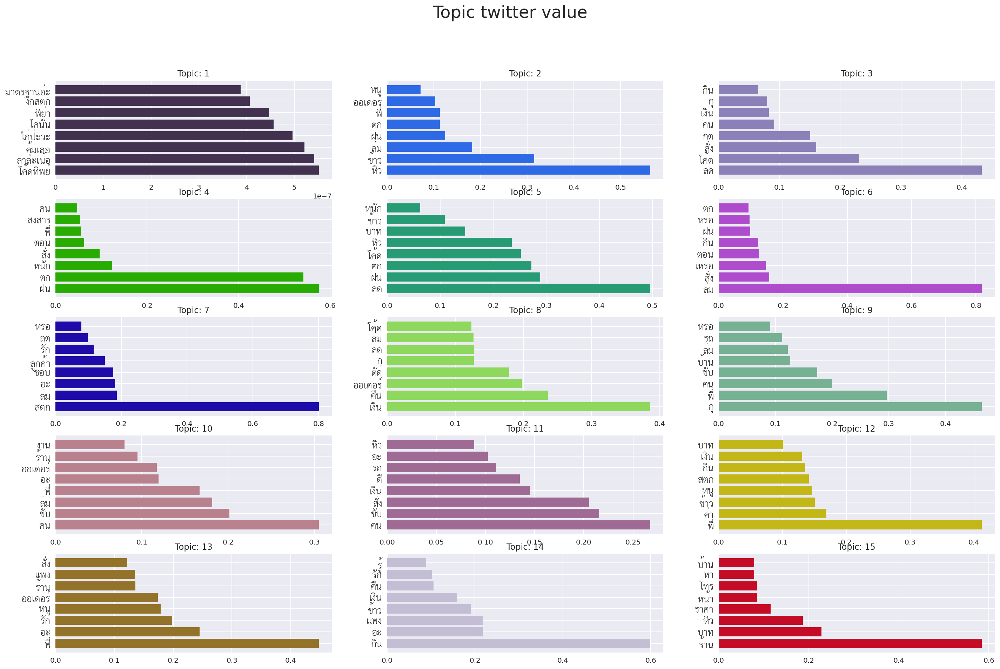

In [ ]:
# Plot values
# Define font family
axsTickFont = {'family': 'TH Sarabun New',
               'size': 20}

with plt.style.context('seaborn'):
  fig, axs = plt.subplots(int(nTopics / 3), 3, figsize = (24, 15))
  fig.suptitle('Topic twitter value')
  axs = axs.ravel()

  for i in range(nTopics):
    data = topicWords.query('Topic == @i + 1')
    value = data['Value']
    word = data['Word']
    position = np.arange(data.shape[0])
    axs[i].set_title(f'Topic: {i + 1}')
    axs[i].barh(position, value, color = np.random.rand(3))
    axs[i].set_yticks(position) #To set ticks based on number of labels
    axs[i].set_yticklabels(list(word), **axsTickFont) #**kwargs for Thai font option
plt.savefig('wordValues.png')
plt.show()

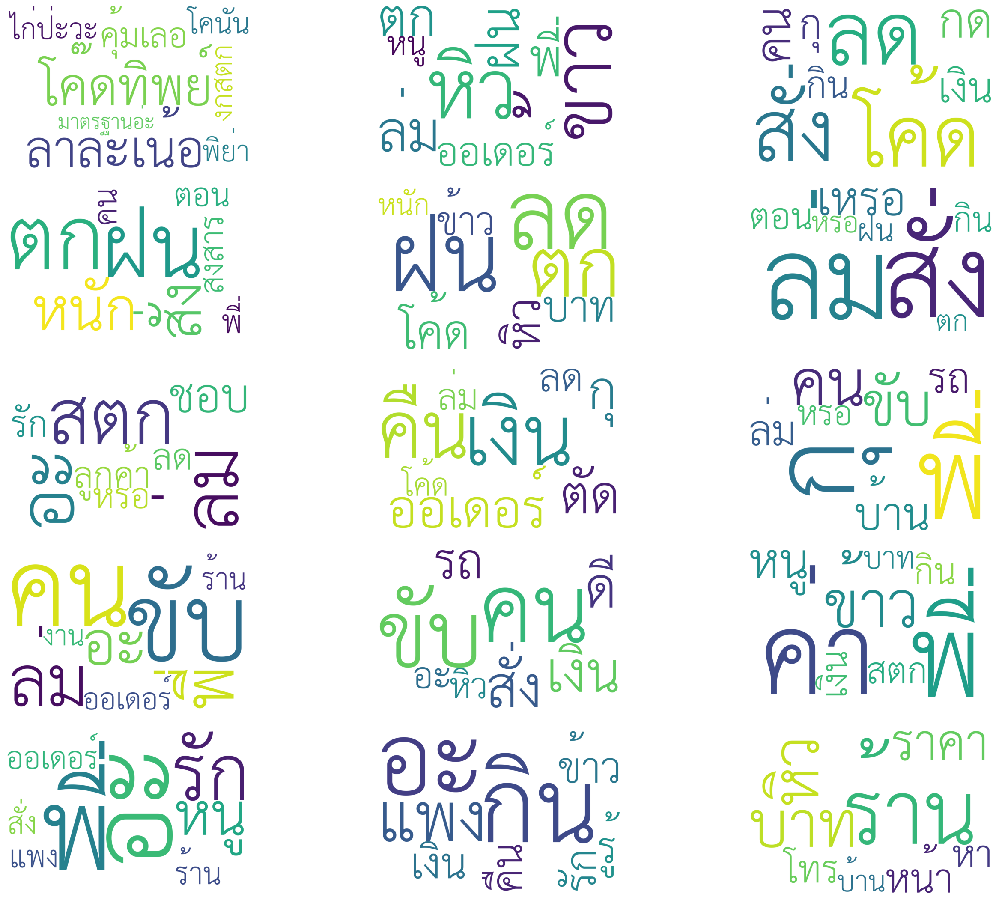

In [ ]:
# Define function word cloud
def plotWord(data):
  wordcloud = WordCloud(font_path = 'THSarabunNew.ttf',
                        width = 1200,
                        height = 800,
                        background_color = 'white',
                        regexp = r'[ก-๙]+').generate_from_text(' '.join(data))
  return wordcloud
  
# Plot word cloud
fig = plt.figure(figsize = (20, 15))

for i in range(nTopics):
  data = topicWords.query('Topic == @i + 1')['Word'] #Extract only word
  ax = fig.add_subplot(int(nTopics / 3), 3, i + 1)
  wordcloud = plotWord(data)
  ax.imshow(wordcloud)
  ax.axis('off')
fig.tight_layout()
fig.savefig('wordPlot.png')

## find misspelling words and more stopwords

### find

In [ ]:
df.shape[0]

40605

In [ ]:
df.datetime.max()

'2022-09-01 23:55:46+00:00'

In [ ]:
cleaned_tokens = tweets['clenedText'].apply(lambda tweet: preprocess(tweet, 
                                                                     engine='attacut',
                                                                     correct_dict=provider_dict,
                                                                     stopwords_and_customwords=list(thai_stopwords())))

In [ ]:
all_tokens_cleaned = cleaned_tokens.explode().to_list()
freq_ = Counter(all_tokens_cleaned)
freq_.most_common()

[('สั่ง', 12877),
 ('คน', 6714),
 ('ร้าน', 6422),
 ('กุ', 4391),
 ('ข้าว', 4238),
 ('พี่', 4138),
 ('กด', 3955),
 ('กิน', 3932),
 ('ค่า', 3678),
 ('หิว', 3419),
 ('ตอน', 3380),
 ('ลด', 3287),
 ('ทำ', 3234),
 ('อะ', 3081),
 ('เงิน', 3000),
 ('อาหาร', 2758),
 ('บ้าน', 2723),
 ('ดี', 2676),
 ('บาท', 2605),
 ('โทร', 2486),
 ('รอ', 2331),
 ('ขับ', 2166),
 ('งาน', 1979),
 ('เจอ', 1886),
 ('โค้ด', 1885),
 ('ซื้อ', 1852),
 ('รู้', 1847),
 ('หา', 1832),
 ('ออเดอร์', 1788),
 ('งง', 1710),
 ('เค้า', 1619),
 ('เหมือน', 1599),
 ('ดู', 1592),
 ('หน้า', 1587),
 ('รอบ', 1548),
 ('หรอ', 1520),
 ('ชั้น', 1484),
 ('ล่ม', 1438),
 ('ถาม', 1428),
 ('ยกเลิก', 1422),
 ('ตัว', 1407),
 ('เวลา', 1359),
 ('อ่ะ', 1345),
 ('จ่าย', 1319),
 ('รถ', 1278),
 ('คืน', 1258),
 ('ลูกค้า', 1183),
 ('โดน', 1173),
 ('ชอบ', 1076),
 ('ใส่', 1066),
 ('ราคา', 1061),
 ('แพง', 993),
 ('แอพ', 992),
 ('น้ำ', 992),
 ('เรื่อง', 980),
 ('ไหม', 968),
 ('สัก', 964),
 ('วะ', 957),
 ('ตัด', 943),
 ('สรุป', 912),
 ('แม่', 859),
 ('ขาย', 846),

In [ ]:
all_tokens_cleaned = cleaned_tokens.explode().to_list()
freq_ = get_k_most_common(all_tokens_cleaned, 9)
freq_

[('เหงา', 9),
 ('เชียว', 9),
 ('สนิท', 9),
 ('อันตราย', 9),
 ('กิจการ', 9),
 ('เกม', 9),
 ('ยืม', 9),
 ('วัด', 9),
 ('หมอ', 9),
 ('ผญ', 9),
 ('กรุงไทย', 9),
 ('กุอยู่', 9),
 ('แอพล่ม', 9),
 ('ลาย', 9),
 ('ตจว', 9),
 ('ภูมิใจ', 9),
 ('เวน', 9),
 ('หารถ', 9),
 ('งอง', 9),
 ('ฮื่อ', 9),
 ('นิดเดียว', 9),
 ('ผัว', 9),
 ('เฮีย', 9),
 ('โปรโมท', 9),
 ('พน', 9),
 ('แคป', 9),
 ('ขยัน', 9),
 ('สลิป', 9),
 ('ลื่น', 9),
 ('เดี่ยว', 9),
 ('ชาร์จ', 9),
 ('หี', 9),
 ('ร่างกาย', 9),
 ('เหล้า', 9),
 ('เคลียร์', 9),
 ('สึก', 9),
 ('เดอะ', 9),
 ('พี่มาย', 9),
 ('เป่า', 9),
 ('หมื่น', 9),
 ('แพ้', 9),
 ('เอ', 9),
 ('สุขภาพ', 9),
 ('โยน', 9),
 ('ไรกิน', 9),
 ('รวน', 9),
 ('หลอน', 9),
 ('เลิศ', 9),
 ('หลบ', 9),
 ('ปริมาณ', 9),
 ('เหลือง', 9),
 ('เช่า', 9),
 ('เฟ่', 9),
 ('gps', 9),
 ('เลน', 9),
 ('สะสม', 9),
 ('เสด', 9),
 ('มัว', 9),
 ('ใส่ใจ', 9),
 ('บุหรี่', 9),
 ('ตำรวจ', 9),
 ('สัมพันธ์', 9),
 ('เหนียว', 9),
 ('วาด', 9),
 ('เนย', 9),
 ('ไข่มุก', 9),
 ('ซ้อม', 9),
 ('ศูนย์', 9),
 ('ปั๊ม', 9),
 ('แบงค์',

ถึง 'อุบาทว์' freq = 4

subjective token
- สาย + ไหม / ใช่ + ไหม
- ชั้น + รอ + นาน / หมู + สาม + ชั้น
- ชม can be ชม compliment / ครึ่ง + ชม

In [ ]:
context = cleaned_tokens.apply(lambda x: find_context_by_token(tokens=x, lookup_word='สาย', lookup_tail=True))
context_ = context.explode().to_list()
freq_ = Counter(context_)
freq_.most_common()

[(nan, 11518),
 ('สายไหม', 8),
 ('สาย is in the end of the sentence', 6),
 ('สายโทร', 4),
 ('สายเสียง', 3),
 ('สายใส่', 3),
 ('สายพี่', 3),
 ('สายกิน', 3),
 ('สายสาย', 2),
 ('สายสุดท้าย', 2),
 ('สายคุย', 2),
 ('สายรอบ', 2),
 ('สายหา', 2),
 ('สายชอบ', 2),
 ('สายฝน', 2),
 ('สายพี่ค้าบ', 1),
 ('สายกุกระแอม', 1),
 ('สายเสียงตดกุ', 1),
 ('สายเงิน', 1),
 ('สายเดิน', 1),
 ('สายสั่ง', 1),
 ('สายฮัลโย๋', 1),
 ('สายอินี่', 1),
 ('สายคาดหวัง', 1),
 ('สายลับ', 1),
 ('สายได้ยิน', 1),
 ('สายพุด', 1),
 ('สายคอ', 1),
 ('สายทิ้ง', 1),
 ('สายอีเวง', 1),
 ('สายกูหะ', 1),
 ('สายปล', 1),
 ('สายหลุด', 1),
 ('สายเป็นคอล', 1),
 ('สายโทรศัพท์', 1),
 ('สายห้องน้ำ', 1),
 ('สายแถม', 1),
 ('สายตก', 1),
 ('สายสะใจ', 1),
 ('สายเรว', 1),
 ('สายสุขภาพ', 1),
 ('สายเขียว', 1),
 ('สายขิม', 1),
 ('สายอาจิณ', 1),
 ('สายgo', 1),
 ('สายไถ', 1),
 ('สายเจอ', 1),
 ('สายรอ', 1),
 ('สายคน', 1),
 ('สายแฟ', 1),
 ('สายค่า', 1),
 ('สายหวาน', 1),
 ('สายชีส', 1),
 ('สายขอโทษ', 1),
 ('สายสบถ', 1),
 ('สายมะม่วง', 1),
 ('สายลูกค้า', 1),
 

In [ ]:
# in english, don't forget to use .lower() before removing it with re.sub()

# 12 Feb
provider_dict = {
    'lineman': ['ไลน์แมน', r'(line)\s?(man)'],
    'shopeefood': [r'(shopee)\s?(food)?', r'(ช้อปปี้|ชอปปี้|ช้อปปี้|ชอปปี้|ช็อปปี้)(ฟู้ด)?'],
    'foodpanda': [r'(food)\s?(panda)', 'ฟู้ดแพนด้า', 'ฟู๊ดแพนด้า'],
    'grab': ['(แกร้ป|แกร้บ|แกร็ป|แกร้ป|แกรป|แกร๊บ|แกร๊ป|แกรบ|แกร็บ|แก้ป|แก้บ|แก๊บ)(ฟู้ด)?', r'grab\s?(food)?'], 
             # to replace 'แกร้ป' and 'แกรป', make sure it doesn't follow with ฟู้ด
    'robinhood': ['โรบินฮู้ด', 'โรบินฮู๊ด', 'รบฮ', r'(robin)\s(hood)'],
}

misspelling_dict = { # use re.sub() to correct the words in form 'คำถูก' : [list of 'คำผิด']
    # misspelling or morphed

    'ฉัน': ['ชุ้น'], # ชั้น ?
    'เงิน': [r'ตัง(ค์)?'], 
    'โค้ด': ['โค๊ด', 'code'],
    'พอยต์': ['พ้อย', r'point(s)?', 'พอยท์'],
    'ยกเลิก': ['cancel', 'แคนเซิล'],
    'แผนที่': ['แมพ', 'แมป', 'แม็ป'],
    'ไรเดอร์': ['คนขับ', 'ไรเด้อ', 'ไรด์เดอร์', 'rider'],
    'ออเดอร์': ['ออเด้อ', r'order(s)?', 'ออร์เดอร์', r'ออเดอ[^(ร์)]'],
    'สติกเกอร์': ['สตก', 'สติ๊กเกอร์', 'สติ้กเก้อ', 'ติ๊กเก้อ', 'ติ้กเก้อ', 
                  'สติกเก้อ', 'ติกเก้อ', 'ติ้กเกอร์', 'สติ้กเกอร์', 'ติ๊กเกอร์'],
    'อัป': ['อัพ'],
    'อัปเดต': [r'อั[บป]เด[ตท]'],
    'มอเตอร์ไซค์': ['มอไซ[^(ค์)(ต์)]', 'มอไซค์', 'มอไซต์'], 
    'รำคาญ': ['รำคาน'],

    # abbreviation
    'ขี้เกียจ': ['ขก'],
    'ลูกค้า': ['ลค'],
    'ฉิบหาย': ['ชิบหาย', 'ชห'],
    'ปัญหา': ['ปัญหา'],
    'พนักงาน': ['พนง'],
    'ผู้ชาย': ['ผช'],
    'ผู้หญิง': ['ผญ'],
    'พรุ่งนี้': ['พน'],
    'บช': ['บช'],
    'โทรศัพท์': ['ทรศ'],
    'ความสัมพันธ์': ['คสพ'],
    'โมโห': ['มอหอ'],
    'เจ้าหน้าที่': ['จนท'],
    
    'เจ็บ': ['เจ็บ'],
    'ดี': ['ดีย์'],
    'เร็ว': ['เร้ว'],
    'ร้อง': ['ล้อง'],
    'กลัว': ['กัว'],
    'โกรธ': ['โกด'],
    'อุตส่าห์': [r'อุตส่า[^(ห์)]'],
    'แปลก': ['แปก'],
    'ไม่': ['ม่าย', 'ไมา'],
    'เกิน': ['เกิ๊น'],
    'ขอบคุณ': ['ขอบคุน'],
    'จัง': ['จัง'],
    'อีก': ['อีก'],
    'งง': ['งอง'],
    'ว่ะ': ['หว่ะ'],
    'ล่ะ': ['หละ', 'หล่ะ', 'ล้ะ'],
    'เหรอ': ['หรอ', 'เบ๋อ'],
    'กู' : ['กุ[^(้ง)]', 'กรู'],
    'มึง' : ['มุง'],
    'อี' : [r'อิ[^(่ม)(น)]'],
    'แอป': ['แอพ'],
    'ครับ': ['คับ', 'งับ', 'คั้บ', 'คร้าบ'],
    'กิน': ['แดก'],
    'ก็': [r'[^แ]ก้[^(ว)(ไข)(อ)(อน)]', r'ก้อ[^น]'], # using re.sub() to correct 'ก้' to 'ก็' 
    'อยู่': ['อยุ่'],                       # can miscorrect 'ก้อน' to 'ก็อน' as well
    'รู้': ['รุ้'],
    'เดี๋ยว': ['เดะ', 'เด่ว', 'เด๋ว'],
    'แล้ว': ['แร้ว', 'แน้ว'],
    'เป็น': ['เปน', 'เป้น'],
    'โอ๊ย': ['โอ้ย', 'อ้ย'],
    'เซ็ง': ['เซง'],
    'เปล่า': ['ป่าว'],
    'เห็น': [r'เหน[^(ื่อย)]'],
    'จริง': ['จิง', 'จีง'],
    'ฉิพ': ['ชิบ'],
    'สัตว์': ['สัส', 'สัด'],
    'พิมพ์': ['พิม[^(พ์)]'],
    'เวร': ['เวน', 'เวง'],
    'กรี๊ด': ['กี้ด', 'กรี้ด', 'กิ้ด'],
    'เลย': ['เล้ย', 'เรย'],
    'เวอร์': ['เว่อ'], 
    'หนู': [r'[^ห]นุ[^น]', r'[^ห]นุ[^(่ม)]', r'หนุ[^น]'],

    'กับ': [r'กะ']

    # others
    # 'ไม่' : ['บ่']
}

custom_words = [ # remove by token
    # คำสรรพนาม
    'พี่', 'หนู', 'ฉัน', 'สู', 'ดิฉัน', 'ดิชั้น', 'เค้า',
    # คำกริยา
    'งง',
    # ลักษณะนาม
    'บาท',
    # คำวิเศษณ์
    'เอาจริง', 'สรุป', 'เดี๋ยวนี้', 'โอเค', 'มั้ง', 'แล้ว', 'เลย', 'นึง',
    'เป๊ะ', 'แน่', 'เดี๋ยว', 'เค', 'เคร', 'อยู่ดี', 'ตะกี้', 'เมื่อกี้', 'มะกี้', 'ด้วยซ้ำ', 
    # คำสันธาน
    'งั้น', 'ตอน', 'ขนาด', 'สัก', 'สาเหตุ',
    # คำบุพบท
    'สำหรับ', 'แถว', 'ยัน',
    # คำอุทาน
    'อะ', 'อ่ะ', 'อ้ะ', 'เด้อ', 'ล่ะ', 'ละอะ', 'สิ', 'ปะ', 'ป่ะ', 'ป้ะ', 'จ่ะ', 'โห', 'เนี้ย', 'เอ้อ',
    'เหรอ', 'อือ', 'เออ', 'เอ่อ', 'ครับ', 'ค๊า', 'น้า', 'อ่า', 'ง่า', 'ง่ะ', 'เหอะ', 'หรอก', 'ดิ', 'เห้อ',
    'เฮ้อ', 'ฮะ', 'น้อ', 'เนาะ', 'ปุ้บ', 'ปุ๊บ', 'ปั๊บ', 'นิ', 'หนิ', 'ปะวะ', 'แหะ', 'เอ้ย', 'แฮะ', 'หึ', 'ห้ะ', 'ห๊ะ', 'แหนะ',
    'วะ', 'ว่ะ', 'เว้ย', 'ใด', # ใดใด
    'ฮือ', 'ฮืออ', 'ฮื่อ', 'ฮรือ', 'งื้อ', 'แง', 'แงง', 'โอ๊ย', 'โอย', 'เวอร์', 'กรี๊ด', 'อ้าว', 'อ๋อ', 'แง้', 'อห', 'เห้ย', 'อมก', 
    'มุ้ย', 'เย้', 'เย่', 'แป๊บ', 'แล่ะ', 'แหล่ะ', 'เหย', 'เอ๊ะ', 'อ้าก', 'เนี่ยย', 'อุ้ย', 'เอิ่ม', 'ช็อก', 'วุ้ย'
]

rude_words = [
    'กู', 'อี', 'มึง', 'แดก', 'เหี้ย', 'เชี่ย', r'ควย', 'หี', 'สัตว์', 'เสือก', 'ฉิบหาย', 'ห่า',
    'แม่ง', 'โว้ย', 'อส', 'สัตว์', 'นัง', 'ควาย', 'เวร', 'กวนตีน', 'ทุเรศ', 'สันดาน', 'ตอแหล', 'อุบาทว์'
]

word_with_following = [
    'อี'# , 'สัก', 'นึก', 'แทบ' 
    # whatever followed by 'อี' will be removed, and so was 'อี'
    # but there're some tokens that already merged together due to the word_tokenizer algorithm ex. อีควาย 
    # so remove those tokens as well 
]

In [ ]:
context = tweets['clenedText'].apply(lambda tweet: find_surrounding_substring(tweet, 3, 'พน'))
all_freq = context.explode().to_list()
freq_ = Counter(all_freq)
freq_.most_common()

In [ ]:
def find_surrounding_substring(text, n, substring):
    start = text.find(substring)
    start_range = max(0, start-n)
    front = text[start_range:start]

    end = start + len(substring)
    end_range = min(end+n, len(text))
    behind = text[end:end_range]
    return front + substring + behind

In [ ]:
find_surrounding_substring('หกดกหดกหsdแก้ไrwjk', 2, 'กุ')

'หกดกหดกหsdแก้ไrwjกุกด'

In [ ]:
display_tweet_by_query('นุ', tweets)

239 tweets
31       ช่วงนี้ก็จะสนิทแอปไลน์แมน ส่งของกันสนุกเลยจ้า                                                                                                                                                                                                                                           
58       กุด้อนไล้ไลน์แมนที่โทรเก่งๆ อืดอก ขกคุยกับมนุด                                                                                                                                                                                                                                          
70       อยากบ่น ที่แบบอยากสั่งเพิ่ม เคยมีคนสั่งกาแฟผ่านไลน์แมนุแล้วโทรมาสั่งเพิ่มกับร้าน บอกเดี๋ยวให้ไลน์แมนมาเก็บตังเพิ่มเอง คือแบบข้อมูลที่สั่งก็ไม่เข้าระบบบริษัทแล้วก็เสี่ยงโดนโกง ทำไมไม่ยกเลิกแล้วสั่งใหม่แทน                                                                             
93       ไลน์แมนตีนุมั้ย สั่งแบบห่าง200เมตร555555                                                                      

In [ ]:
merged_dict = {**provider_dict, **misspelling_dict}

In [ ]:
correct_sentence('ไลน์แมน line man ช้อปปี้ฟู้ด GRAB food LINE MAN', merged_dict)

'lineman lineman shopeefood grab lineman'

### Inspect Stop Words

In [ ]:
# in english, don't forget to use .lower() before removing it with re.sub()

# 12 Feb
provider_dict = {
    'lineman': ['ไลน์แมน', r'(line)\s?(man)'],
    'shopeefood': [r'(shopee)\s?(food)?', r'((ช้อปปี้)|(ชอปปี้)|(ช้อปปี้)|(ชอปปี้)|(ช็อปปี้))(ฟู้ด)?'],
    'foodpanda': [r'(food)\s?(panda)', 'ฟู้ดแพนด้า', 'ฟู๊ดแพนด้า'],
    'grab': ['((แกร้ป)|(แกร้บ)|(แกร็ป)|(แกร้ป)|(แกรป)|(แกร๊บ)|(แกร๊ป)|(แกรบ)|(แกร็บ)|(แก้ป)|(แก้บ)|(แก๊บ))(ฟู้ด)?', r'(grab)\s?(food)?'], 
             # to replace 'แกร้ป' and 'แกรป', make sure it doesn't follow with ฟู้ด
    'robinhood': ['โรบินฮู้ด', 'โรบินฮู๊ด', 'รบฮ', r'(robin)\s(hood)'],
}

misspelling_dict = { # use re.sub() to correct the words in form 'คำถูก' : [list of 'คำผิด']
    # misspelling or morphed

    'ฉัน': ['ชุ้น'], # ชั้น ?
    'เงิน': [r'ตัง(ค์)?'], 
    'โค้ด': ['โค๊ด', 'code'],
    'พอยต์': ['พ้อย', r'point(s)?', 'พอยท์'],
    'ยกเลิก': ['cancel', 'แคนเซิล'],
    'แผนที่': ['แมพ', 'แมป', 'แม็ป'],
    'ไรเดอร์': ['คนขับ', 'ไรเด้อ', 'ไรด์เดอร์', 'rider'],
    'ออเดอร์': ['ออเด้อ', r'order(s)?', 'ออร์เดอร์', r'ออเดอ(?!(ร์))'],
    'สติกเกอร์': ['สตก', 'สติ๊กเกอร์', 'สติ้กเก้อ', 'ติ๊กเก้อ', 'ติ้กเก้อ', 
                  'สติกเก้อ', 'ติกเก้อ', 'ติ้กเกอร์', 'สติ้กเกอร์', 'ติ๊กเกอร์'],
    'อัป': ['อัพ'],
    'อัปเดต': [r'อั[บป]เด[ตท]'],
    'มอเตอร์ไซค์': ['มอไซ(?!((ค์)|(ต์)))', 'มอไซค์', 'มอไซต์'], 
    'รำคาญ': ['รำคาน'],

    # abbreviation
    'ขี้เกียจ': ['ขก'],
    'ลูกค้า': ['ลค'],
    'ฉิบหาย': ['ชิบหาย', 'ชห'],
    'ปัญหา': ['ปัญหา'],
    'พนักงาน': ['พนง'],
    'ผู้ชาย': ['ผช'],
    'ผู้หญิง': ['ผญ'],
    'พรุ่งนี้': ['พน'],
    'บช': ['บช'],
    'โทรศัพท์': ['ทรศ'],
    'ความสัมพันธ์': ['คสพ'],
    'โมโห': ['มอหอ'],
    'เจ้าหน้าที่': ['จนท'],
    
    'เจ็บ': ['เจ็บ'],
    'ดี': ['ดีย์'],
    'เร็ว': ['เร้ว'],
    'ร้อง': ['ล้อง'],
    'กลัว': ['กัว'],
    'โกรธ': ['โกด'],
    'อุตส่าห์': [r'อุตส่า(?!(ห์))'],
    'แปลก': ['แปก'],
    'ไม่': ['ม่าย', 'ไมา'],
    'เกิน': ['เกิ๊น'],
    'ขอบคุณ': ['ขอบคุน'],
    'จัง': ['จัง'],
    'อีก': ['อีก'],
    'งง': ['งอง'],
    'ว่ะ': ['หว่ะ'],
    'ล่ะ': ['หละ', 'หล่ะ', 'ล้ะ'],
    'เหรอ': ['(?!(เ))หรอ', 'เบ๋อ'],
    'กู' : ['กุ(?!(้ง))', 'กรู'],
    'มึง' : ['มุง'],
    'อี' : [r'อิ(?!((่ม)|(น)))'],
    'แอป': ['แอพ'],
    'ครับ': ['คับ', 'งับ', 'คั้บ', 'คร้าบ'],
    'กิน': ['แดก'],
    'ก็': [r'(?!(แ))ก้(?!((ว)|(ไข)|(อ)|(อน)))', r'ก้อ(?!(น))'], # using re.sub() to correct 'ก้' to 'ก็' 
    'อยู่': ['อยุ่'],                       # can miscorrect 'ก้อน' to 'ก็อน' as well
    'รู้': ['รุ้'],
    'เดี๋ยว': ['เดะ', 'เด่ว', 'เด๋ว'],
    'แล้ว': ['แร้ว', 'แน้ว'],
    'เป็น': ['เปน', 'เป้น'],
    'โอ๊ย': ['โอ้ย', 'อ้ย'],
    'เซ็ง': ['เซง'],
    'เปล่า': ['ป่าว'],
    'เห็น': [r'เหน(?!(ื่อย))'],
    'จริง': ['จิง', 'จีง'],
    'ฉิพ': ['ชิบ'],
    'สัตว์': ['สัส', 'สัด'],
    'พิมพ์': ['พิม(?!(พ์))'],
    'เวร': ['เวน', 'เวง'],
    'กรี๊ด': ['กี้ด', 'กรี้ด', 'กิ้ด'],
    'เลย': ['เล้ย', 'เรย'],
    'เวอร์': ['เว่อ'], 
    'หนู': [r'(?!(ห))นุ(?!(น))', r'(?!(ห))นุ(?!(่ม))', r'หนุ(?!(น))'],

    'กับ': ['กะ']

    # others
    # 'ไม่' : ['บ่']
}

custom_words = [ # remove by token
    # คำสรรพนาม
    'พี่', 'หนู', 'ฉัน', 'สู', 'ดิฉัน', 'ดิชั้น', 'เค้า',
    # คำกริยา
    'งง',
    # ลักษณะนาม
    'บาท',
    # คำวิเศษณ์
    'เอาจริง', 'สรุป', 'เดี๋ยวนี้', 'โอเค', 'มั้ง', 'แล้ว', 'เลย', 'นึง',
    'เป๊ะ', 'แน่', 'เดี๋ยว', 'เค', 'เคร', 'อยู่ดี', 'ตะกี้', 'เมื่อกี้', 'มะกี้', 'ด้วยซ้ำ', 
    # คำสันธาน
    'งั้น', 'ตอน', 'ขนาด', 'สัก', 'สาเหตุ',
    # คำบุพบท
    'สำหรับ', 'แถว', 'ยัน',
    # คำอุทาน
    'อะ', 'อ่ะ', 'อ้ะ', 'เด้อ', 'ล่ะ', 'ละอะ', 'สิ', 'ปะ', 'ป่ะ', 'ป้ะ', 'จ่ะ', 'โห', 'เนี้ย', 'เอ้อ',
    'เหรอ', 'อือ', 'เออ', 'เอ่อ', 'ครับ', 'ค๊า', 'น้า', 'อ่า', 'ง่า', 'ง่ะ', 'เหอะ', 'หรอก', 'ดิ', 'เห้อ',
    'เฮ้อ', 'ฮะ', 'น้อ', 'เนาะ', 'ปุ้บ', 'ปุ๊บ', 'ปั๊บ', 'นิ', 'หนิ', 'ปะวะ', 'แหะ', 'เอ้ย', 'แฮะ', 'หึ', 'ห้ะ', 'ห๊ะ', 'แหนะ',
    'วะ', 'ว่ะ', 'เว้ย', 'ใด', # ใดใด
    'ฮือ', 'ฮืออ', 'ฮื่อ', 'ฮรือ', 'งื้อ', 'แง', 'แงง', 'โอ๊ย', 'โอย', 'เวอร์', 'กรี๊ด', 'อ้าว', 'อ๋อ', 'แง้', 'อห', 'เห้ย', 'อมก', 
    'มุ้ย', 'เย้', 'เย่', 'แป๊บ', 'แล่ะ', 'แหล่ะ', 'เหย', 'เอ๊ะ', 'อ้าก', 'เนี่ยย', 'อุ้ย', 'เอิ่ม', 'ช็อก', 'วุ้ย'
]

rude_words = [
    'กู', 'อี', 'มึง', 'แดก', 'เหี้ย', 'เชี่ย', 'ควย', 'หี', 'สัตว์', 'เสือก', 'ฉิบหาย', 'ห่า',
    'แม่ง', 'โว้ย', 'อส', 'สัตว์', 'นัง', 'ควาย', 'เวร', 'กวนตีน', 'ทุเรศ', 'สันดาน', 'ตอแหล', 'อุบาทว์'
]

word_with_following = [
    'อี'# , 'สัก', 'นึก', 'แทบ' 
    # whatever followed by 'อี' will be removed, and so was 'อี'
    # but there're some tokens that already merged together due to the word_tokenizer algorithm ex. อีควาย 
    # so remove those tokens as well 
]

In [ ]:
merged_dict = {**provider_dict, **misspelling_dict}

In [ ]:
def get_tokens(tweet, engine='attacut'):
    cleanedTweet = cleanText3(tweet)
    cleanedTweet = correct_sentence(cleanedTweet, merged_dict)
    cleanedTweet = remove_provider(cleanedTweet, provider_words)
    tokens = word_tokenize(cleanedTweet, engine=engine, keep_whitespace=False)
    tokens = [normalize(token) for token in tokens]
    # tokens = merge_token_by_words(tokens, word_with_following)
    return tokens

In [ ]:
tokens = tweets['clenedText'].apply(lambda x: get_tokens(x, engine='attacut'))

In [ ]:
num_tokens, num_tokens_unique, num_stopwords, \
count, num_stopwords_in_tweet, percent_stopwords, percent_stopwords_unique, freq_stopwords_dict = get_num(tokens, list(thai_stopwords()))
print('total tokens after tokenizing          : {}'.format(num_tokens))
print('total tokens after tokenizing (unique) : {}'.format(num_tokens_unique))
print('total stopwords                        : {}'.format(num_stopwords))
print('total stopwords in tweet               : {}'.format(count))
print('total stopwords in tweet (unique)      : {}'.format(num_stopwords_in_tweet))
print('% stopwords in tweet                   : {} %'.format(percent_stopwords))
print('% stopwords in tweet (unique)          : {} %'.format(percent_stopwords_unique))

total tokens after tokenizing          : 212218
total tokens after tokenizing (unique) : 14458
total stopwords                        : 1030
total stopwords in tweet               : 110648
total stopwords in tweet (unique)      : 358
% stopwords in tweet                   : 52.14 %
% stopwords in tweet (unique)          : 2.48 %


In [ ]:
freq_stopwords_dict

{'ไม่': 4954,
 'มา': 3413,
 'แล้ว': 3274,
 'ไป': 3196,
 'ได้': 3142,
 'จะ': 2761,
 'ก็': 2753,
 'เลย': 2593,
 'ที่': 2478,
 'มี': 2356,
 'นี้': 2283,
 'ให้': 2204,
 'มาก': 2175,
 'ส่ง': 2150,
 'ๆ': 2144,
 'แต่': 2025,
 'ว่า': 1847,
 'ใน': 1650,
 'คือ': 1635,
 'นะ': 1602,
 'เป็น': 1445,
 'ละ': 1414,
 'วัน': 1374,
 'กับ': 1241,
 'รับ': 1161,
 'ใช้': 1159,
 'ของ': 1121,
 'มัน': 1103,
 'กู': 1074,
 'อีก': 1043,
 'อยู่': 1025,
 'ต้อง': 997,
 'ยัง': 980,
 'อยาก': 939,
 'แบบ': 928,
 'บอก': 871,
 'นี่': 825,
 'เรา': 799,
 'กัน': 781,
 'จาก': 719,
 'ด้วย': 711,
 'กว่า': 683,
 'ขึ้น': 672,
 'ถึง': 650,
 'เข้า': 645,
 'อะไร': 641,
 'เอา': 636,
 'ทุก': 597,
 'จริง': 595,
 'เพราะ': 577,
 'ทำไม': 563,
 'ไหน': 549,
 'ครับ': 548,
 'ค่ะ': 536,
 'ก่อน': 526,
 'หมด': 515,
 'ส่วน': 500,
 'ถ้า': 486,
 'คะ': 485,
 'มั้ย': 484,
 'เขา': 467,
 'พอ': 461,
 'เอง': 442,
 'น่า': 438,
 'หรือ': 421,
 'ไง': 416,
 'เยอะ': 416,
 'และ': 413,
 'ใคร': 400,
 'การ': 398,
 'ไร': 398,
 'เห็น': 387,
 'ที': 385,
 'อย่าง': 378,


In [ ]:
remove_stopwords_list = [
    # 'ไม่', 
    # 'มา', 'ไป', 
    # 'มี', 'ให้', 
    'ส่ง', 'ขึ้น'
    'รับ', 'ใช้', 
    # 'เข้า', 'ถึง',
    'หมด', 
    'ส่วน', 'ลด', 'ต่าง', 
    'เยอะ', 'เพิ่ม', 'นาน', 'ช้า', 'เร็ว', 
    # 'ขั้น', 'ต่ำ',
    'น้อย', 
    'ถูก', 'ผิด', 
    'บ่อย', 'ไกล', 
    'ครบ', 'ขาด', 
    # 'ยืนยัน', 'ผ่าน'
]

In [ ]:
num_tokens, num_tokens_unique, num_customwords, \
count, num_customwords_in_tweet, percent_customwords, percent_customwords_unique, customwords_freq_dict = get_num(tokens, custom_words)
print('total tokens after tokenizing          : {}'.format(num_tokens))
print('total tokens after tokenizing (unique) : {}'.format(num_tokens_unique))
print('total customwords                      : {}'.format(num_customwords))
print('total customwords in tweet             : {}'.format(count))
print('total customwords in tweet (unique)    : {}'.format(num_customwords_in_tweet))
print('% customwords in tweet                 : {} %'.format(percent_customwords))
print('% customwords in tweet (unique)        : {} %'.format(percent_customwords_unique))

total tokens after tokenizing          : 212218
total tokens after tokenizing (unique) : 14458
total customwords                      : 112
total customwords in tweet             : 15699
total customwords in tweet (unique)    : 109
% customwords in tweet                 : 7.4 %
% customwords in tweet (unique)        : 0.75 %


In [ ]:
customwords_freq_dict

{'แล้ว': 3274,
 'เลย': 2593,
 'บาท': 907,
 'พี่': 891,
 'ตอน': 889,
 'อะ': 838,
 'ครับ': 548,
 'เหรอ': 503,
 'งง': 441,
 'อ่ะ': 358,
 'หนู': 292,
 'ฉัน': 257,
 'ขนาด': 252,
 'วะ': 240,
 'สัก': 229,
 'สรุป': 223,
 'เดี๋ยว': 170,
 'แถว': 161,
 'เดี๋ยวนี้': 156,
 'ล่ะ': 137,
 'โอ๊ย': 105,
 'ฮือ': 104,
 'ปะ': 92,
 'สิ': 87,
 'น้า': 87,
 'ว่ะ': 85,
 'แง': 81,
 'แน่': 78,
 'เออ': 78,
 'มั้ง': 73,
 'กรี๊ด': 70,
 'เวอร์': 68,
 'งั้น': 64,
 'อห': 64,
 'สำหรับ': 63,
 'อ่า': 59,
 'โอเค': 58,
 'ป่ะ': 56,
 'เหอะ': 53,
 'ใด': 47,
 'เด้อ': 44,
 'ดิ': 39,
 'เห้อ': 30,
 'ฮะ': 28,
 'ปุ๊บ': 27,
 'นิ': 27,
 'เอาจริง': 24,
 'โห': 23,
 'อ๋อ': 21,
 'อ้าว': 20,
 'เห้ย': 19,
 'อมก': 19,
 'เค': 18,
 'ยัน': 18,
 'ป้ะ': 18,
 'อยู่ดี': 17,
 'เมื่อกี้': 16,
 'เฮ้อ': 16,
 'ปั๊บ': 16,
 'ปะวะ': 16,
 'ตะกี้': 15,
 'เนาะ': 15,
 'แง้': 15,
 'สู': 14,
 'ดิฉัน': 14,
 'ด้วยซ้ำ': 13,
 'จ่ะ': 13,
 'เว้ย': 13,
 'มุ้ย': 13,
 'เย้': 13,
 'ดิชั้น': 12,
 'เป๊ะ': 12,
 'เอ้อ': 12,
 'แหะ': 12,
 'แป๊บ': 12,
 'เนี้ย': 11,
 'แฮะ': 11,
 

In [ ]:
num_tokens, num_tokens_unique, num_rudewords, \
count, num_rudewords_in_tweet, percent_rudewords, percent_rudewords_unique, rudewords_freq_dict = get_num(tokens, rude_words)
print('--------------------------------------------------------')
print('total tokens after tokenizing          : {}'.format(num_tokens))
print('total tokens after tokenizing (unique) : {}'.format(num_tokens_unique))
print('total stopwords and customwords                   : {}'.format(num_rudewords))
print('total stopwords and customwords in tweet          : {}'.format(count))
print('total stopwords and customwords in tweet (unique) : {}'.format(num_rudewords_in_tweet))
print('% stopwords and customwords in tweet              : {} %'.format(percent_rudewords))
print('% stopwords and customwords in tweet (unique)     : {} %'.format(percent_rudewords_unique))

--------------------------------------------------------
total tokens after tokenizing          : 212218
total tokens after tokenizing (unique) : 14458
total stopwords and customwords                   : 23
total stopwords and customwords in tweet          : 2524
total stopwords and customwords in tweet (unique) : 22
% stopwords and customwords in tweet              : 1.19 %
% stopwords and customwords in tweet (unique)     : 0.15 %


In [ ]:
rudewords_freq_dict

{'กู': 1074,
 'มึง': 372,
 'อี': 269,
 'แม่ง': 159,
 'สัตว์': 133,
 'เหี้ย': 113,
 'ฉิบหาย': 108,
 'เวร': 51,
 'ควย': 39,
 'เสือก': 36,
 'ห่า': 35,
 'โว้ย': 29,
 'อส': 19,
 'นัง': 15,
 'เชี่ย': 14,
 'ควาย': 13,
 'ทุเรศ': 11,
 'หี': 9,
 'กวนตีน': 8,
 'สันดาน': 7,
 'ตอแหล': 6,
 'อุบาทว์': 4,
 'แดก': 0}

In [ ]:
def display_(df, engine):
    sample = tweets.sample(n=1)
    sample = sample['clenedText'].values[0]
    print('original tweet: {}'.format(sample))
    print(f"after tokenize: {word_tokenize(sample, engine=engine, keep_whitespace=False)}")
    print('preprocessed : {}'.format(preprocess(sample, engine=engine, stopwords_and_customwords=stopwords_and_customwords)))

In [ ]:
display_(tweets, engine='attacut')

original tweet: โมโหหิวไๆๆๆ ไลน์แมนก็ล่ม
after tokenize: ['โมโห', 'หิว', 'ไๆ', 'ๆ', 'ๆ', 'ไลน์', 'แมน', 'ก็', 'ล่ม']
preprocessed : ['โมโห', 'หิว', 'ไๆ', 'ล่ม']


In [ ]:
def merge_stopwords_and_customwords(lists, remove_list):
    stopwords = list(thai_stopwords())
    for stopword in remove_list:
        if stopword in stopwords:
            stopwords.remove(stopword)
    for list_ in lists:
        stopwords.extend(list_)
    return stopwords
    
stopwords_and_customwords = merge_stopwords_and_customwords([
    custom_words, rude_words
], remove_stopwords_list)

### Preprocess

In [ ]:
# in english, don't forget to use .lower() before removing it with re.sub()

# 12 Feb
provider_dict = {
    'lineman': ['ไลน์แมน', r'(line)\s?(man)'],
    'shopeefood': [r'(shopee)\s?(food)?', r'((ช้อปปี้)|(ชอปปี้)|(ช้อปปี้)|(ชอปปี้)|(ช็อปปี้))(ฟู้ด)?'],
    'foodpanda': [r'(food)\s?(panda)', 'ฟู้ดแพนด้า', 'ฟู๊ดแพนด้า'],
    'grab': ['((แกร้ป)|(แกร้บ)|(แกร็ป)|(แกร้ป)|(แกรป)|(แกร๊บ)|(แกร๊ป)|(แกรบ)|(แกร็บ)|(แก้ป)|(แก้บ)|(แก๊บ))(ฟู้ด)?', r'(grab)\s?(food)?'], 
             # to replace 'แกร้ป' and 'แกรป', make sure it doesn't follow with ฟู้ด
    'robinhood': ['โรบินฮู้ด', 'โรบินฮู๊ด', 'รบฮ', r'(robin)\s(hood)'],
}

misspelling_dict = { # use re.sub() to correct the words in form 'คำถูก' : [list of 'คำผิด']
    # misspelling or morphed

    'ฉัน': ['ชุ้น'], # ชั้น ?
    'โค้ด': ['โค๊ด', 'code'],
    'พอยต์': ['พ้อย', r'point(s)?', 'พอยท์'],
    'ยกเลิก': ['cancel', 'แคนเซิล'],
    'แม็ป': ['แมพ', 'แมป'],
    'ไรเดอร์': ['ไรเด้อ', 'ไรด์เดอร์', 'rider'],
    'ออเดอร์': ['ออเด้อ', r'order(s)?', 'ออร์เดอร์', r'ออเดอ(?!(ร์))'],
    'สติกเกอร์': ['สตก', 'สติ๊กเกอร์', 'สติ้กเก้อ', 'ติ๊กเก้อ', 'ติ้กเก้อ', 
                  'สติกเก้อ', 'ติกเก้อ', 'ติ้กเกอร์', 'สติ้กเกอร์', 'ติ๊กเกอร์'],
    'อัป': ['อัพ'],
    'อัปเดต': [r'อั[บป]เด[ตท]'],
    'มอเตอร์ไซค์': ['มอไซ(?!((ค์)|(ต์)))', 'มอไซค์', 'มอไซต์'], 
    'รำคาญ': ['รำคาน'],

    # abbreviation
    'ขี้เกียจ': ['ขก'],
    'ลูกค้า': ['ลค'],
    'ฉิบหาย': ['ชิบหาย', 'ชห'],
    'ปัญหา': ['ปัญหา'],
    'พนักงาน': ['พนง'],
    'ผู้ชาย': ['ผช'],
    'ผู้หญิง': ['ผญ'],
    'พรุ่งนี้': [r'(?!(แ))พน(?!((ักงาน)|(ด้า)))'],
    'บช': ['บช'],
    'โทรศัพท์': [r'(?!(โ))ทรศ(?!(ัพท์))'],
    'ความสัมพันธ์': ['คสพ'],
    'โมโห': ['มอหอ'],
    'เจ้าหน้าที่': ['จนท'],
    
    'เศร้า': ['เส้า'],
    'เจ็บ': ['เจ็บ'],
    'ดี': ['ดีย์'],
    'เร็ว': ['เร้ว'],
    'ร้อง': ['ล้อง'],
    'กลัว': ['กัว'],
    'โกรธ': ['โกด'],
    'อุตส่าห์': [r'อุตส่า(?!(ห์))'],
    'แปลก': ['แปก'],
    'ไม่': ['ม่าย', 'ไมา'],
    'เกิน': ['เกิ๊น'],
    'ขอบคุณ': ['ขอบคุน'],
    'จัง': ['จัง'],
    'อีก': ['อีก'],
    'งง': ['งอง'],
    'ว่ะ': ['หว่ะ'],
    'ล่ะ': ['หละ', 'หล่ะ', 'ล้ะ'],
    'เหรอ': ['เบ๋อ'],
    'กู' : ['กุ(?!(้ง))', 'กรู'],
    'มึง' : ['มุง'],
    'อี' : [r'อิ(?!((่ม)|(น)))'],
    'แอป': ['แอพ'],
    'ครับ': ['คับ', 'งับ', 'คั้บ', 'คร้าบ', 'ค้าบ'],
    'กิน': ['แดก'],
    'ก็': [r'(?!(แ))ก้(?!((ป)|(ว)|(ไข)|(อ)|(อน)))', r'ก้อ(?!(น))'], # using re.sub() to correct 'ก้' to 'ก็' 
    'อยู่': ['อยุ่'],                       # can miscorrect 'ก้อน' to 'ก็อน' as well
    'รู้': ['รุ้'],
    'เดี๋ยว': ['เดะ', 'เด่ว', 'เด๋ว'],
    'แล้ว': ['แร้ว', 'แน้ว'],
    'เป็น': ['เปน', 'เป้น'],
    'โอ๊ย': ['โอ้ย', r'(?!((โ)|(เ)))อ้ย'],
    'เซ็ง': ['เซง'],
    'เปล่า': ['ป่าว'],
    'เห็น': [r'เหน(?!((ื่อย)|(ียว)))'],
    'จริง': ['จิง', 'จีง'],
    'ฉิพ': ['ชิบ'],
    'สัตว์': ['สัส', 'สัด'],
    'พิมพ์': ['พิม(?!(พ์))'],
    'เวร': ['เวน', 'เวง'],
    'กรี๊ด': ['กี้ด', 'กรี้ด', 'กิ้ด'],
    'เลย': ['เล้ย', 'เรย'],
    'เวอร์': ['เว่อ'], 
    'หนู': [r'(?!(ห))นุ(?!(น))', r'(?!(ห))นุ(?!(่ม))', r'หนุ(?!(น))', r'(?!(ส))นุ(?!(ก))'],

    'กับ': ['กะ']

    # others
    # 'ไม่' : ['บ่']
}

custom_words = [ # remove by token
    # คำสรรพนาม
    'พี่', 'หนู', 'ฉัน', 'สู', 'ดิฉัน', 'ดิชั้น', 'เค้า', 'คน', 'พ่อ', 'แม่', 'น้อง', 'พี่',
    # คำกริยา
    'งง', 'รู้สึก', 'สั่ง', 'กูงง', 'บ่',
    # ลักษณะนาม
    'บาท',
    # คำวิเศษณ์
    'เอาจริง', 'สรุป', 'เดี๋ยวนี้', 'โอเค', 'มั้ง', 'แล้ว', 'เลย', 'นึง', 
    'เป๊ะ', 'แน่', 'เดี๋ยว', 'เค', 'เคร', 'อยู่ดี', 'ตะกี้', 'เมื่อกี้', 'มะกี้', 'ด้วยซ้ำ', 
    # คำสันธาน
    'งั้น', 'ตอน', 'ขนาด', 'สัก', 'สาเหตุ', 'เหมือน',
    # คำบุพบท
    'สำหรับ', 'แถว', 'ยัน',
    # คำอุทาน
    'อะ', 'อ่ะ', 'อ้ะ', 'เด้อ', 'ล่ะ', 'ละอะ', 'สิ', 'ปะ', 'ป่ะ', 'ป้ะ', 'จ่ะ', 'โห', 'เนี้ย', 'เอ้อ',
    'หรอ', 'เหรอ', 'อือ', 'เออ', 'เอ่อ', 'ครับ', 'ค๊า', 'น้า', 'อ่า', 'ง่า', 'งะ', 'ง่ะ', 'เหอะ', 'หรอก', 'ดิ', 'เห้อ',
    'เฮ้อ', 'ฮะ', 'น้อ', 'เนาะ', 'ปุ้บ', 'ปุ๊บ', 'ปั๊บ', 'นิ', 'หนิ', 'ปะวะ', 'แหะ', 'เอ้ย', 'แฮะ', 'หึ', 'ห้ะ', 'ห๊ะ', 'แหนะ',
    'วะ', 'ว่ะ', 'เว้ย', 'ใด', # ใดใด
    'ฮือ', 'ฮืออ', 'ฮื่อ', 'ฮรือ', 'งื้อ', 'แง', 'แงง', 'โอ๊ย', 'โอย', 'เวอร์', 'กรี๊ด', 'อ้าว', 'เอ้า', 'อ่อ', 'อ๋อ', 'แง้', 'อห', 'เห้ย', 'อมก', 
    'มุ้ย', 'เย้', 'เย่', 'แป๊บ', 'แล่ะ', 'แหล่ะ', 'เหย', 'เอ๊ะ', 'อ้าก', 'เนี่ยย', 'อุ้ย', 'เอิ่ม', 'ช็อก', 'วุ้ย'
]

rude_words = [
    'กู', 'กูแบบ', 'อี', 'ดอก', 'มึง', 'แดก', 'อีเหี้ย', 'เหี้ย', 'เชี่ย', 'ควย', 'หี', 'สัตว์', 'เสือก', 'ฉิบหาย', 'ห่า', 'เหี้ยไร',
    'แม่ง', 'โว้ย', 'อส', 'อีสัตว์', 'สัตว์', 'นัง', 'อีควาย', 'ควาย', 'เวร', 'กวนตีน', 'ทุเรศ', 'สันดาน', 'ตอแหล', 'อุบาทว์'
]

In [ ]:
merged_dict = {**provider_dict, **misspelling_dict}

In [ ]:
remove_stopwords_list = [
    # 'ไม่', 
    # 'มา', 'ไป', 
    # 'มี', 'ให้', 
    'ส่ง', 'ขึ้น',
    'รับ', 'ใช้', 
    # 'เข้า', 'ถึง',
    'หมด', 
    'ส่วน', 'ลด', 'ต่าง', 
    'เยอะ', 'เพิ่ม', 'นาน', 'ช้า', 'เร็ว', 
    'ขั้น', 'ต่ำ',
    'น้อย', 
    'ถูก', 'ผิด', 
    'บ่อย', 'ไกล', 
    'ครบ', 'ขาด', 
    'ยืนยัน', 'ผ่าน'
]

In [ ]:
def merge_stopwords_and_customwords(lists, remove_list):
    stopwords = list(thai_stopwords())
    for stopword in remove_list:
        if stopword in stopwords:
            stopwords.remove(stopword)
    for list_ in lists:
        stopwords.extend(list_)
    return stopwords
    
stopwords_and_customwords = merge_stopwords_and_customwords([
    custom_words, rude_words
], remove_stopwords_list)

In [ ]:
tweets['preprocessed_tokens'] = tweets['clenedText'].apply(lambda tweet: preprocess(tweet, 
                                                                                    engine = 'attacut',
                                                                                    correct_dict = merged_dict,
                                                                                    stopwords_and_customwords = stopwords_and_customwords))

In [ ]:
tweets.head(2)

,clenedText,preprocessed_tokens
0,กูล่กมากบอกเลย ไลน์แมนโทรอีก กูบ่น่าจะได้5555555 ผิดไปเลย4ข้อล่กเอง,"[กูล่ก, โทร, ผิด, ข้อ, ล่ก]"
1,ในไลน์แมนตอนนี้49,None


In [ ]:
tweets['preprocessed_tokens'] = tweets['preprocessed_tokens'].apply(lambda tokens: [] if tokens is None else tokens)

In [ ]:
tweets.head(2)

,clenedText,preprocessed_tokens
0,กูล่กมากบอกเลย ไลน์แมนโทรอีก กูบ่น่าจะได้5555555 ผิดไปเลย4ข้อล่กเอง,"[กูล่ก, โทร, ผิด, ข้อ, ล่ก]"
1,ในไลน์แมนตอนนี้49,[]


In [ ]:
tweets.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/preprocessed_tokens.csv', columns=['preprocessed_tokens'], index=False)

## import preprocessed tokens

In [ ]:
tweets = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/1year_data/preprocessed_tokens.csv')

In [ ]:
# tweets.head(2)

,preprocessed_tokens
0,"['กูล่ก', 'โทร', 'ผิด', 'ข้อ', 'ล่ก']"
1,[]


In [ ]:
# tweets.iloc[0][0]

"['กูล่ก', 'โทร', 'ผิด', 'ข้อ', 'ล่ก']"

In [ ]:
# type(tweets.iloc[0][0])

str

In [ ]:
import ast
tweets['preprocessed_tokens'] = tweets['preprocessed_tokens'].apply(lambda string_list: ast.literal_eval(string_list))

In [ ]:
# tweets.head(2)

,preprocessed_tokens
0,"[กูล่ก, โทร, ผิด, ข้อ, ล่ก]"
1,[]


In [ ]:
# type(tweets.iloc[0][0])

list

In [ ]:
tweets['bigram_tokens'] = tweets['preprocessed_tokens'].apply(lambda tokens : get_ngrams(tokens, 2))

In [ ]:
all_tokens_cleaned_2 = tweets['preprocessed_tokens'].explode().to_list()
freq_ = Counter(all_tokens_cleaned_2)
freq_.most_common()

[('ร้าน', 6740),
 ('ส่ง', 6539),
 ('กิน', 4711),
 ('ข้าว', 4529),
 ('รับ', 4201),
 ('กด', 4077),
 ('หิว', 4019),
 ('ใช้', 3937),
 ('ค่า', 3710),
 ('ลด', 3230),
 (nan, 3157),
 ('ทำ', 3116),
 ('เงิน', 2837),
 ('อาหาร', 2674),
 ('ดี', 2561),
 ('ออเดอร์', 2521),
 ('บ้าน', 2347),
 ('รอ', 2313),
 ('โทร', 2126),
 ('ขึ้น', 2071),
 ('ขับ', 2051),
 ('โค้ด', 1968),
 ('ส่วน', 1936),
 ('ยกเลิก', 1823),
 ('งาน', 1800),
 ('เจอ', 1754),
 ('หมด', 1732),
 ('รู้', 1700),
 ('หา', 1636),
 ('เยอะ', 1623),
 ('รอบ', 1521),
 ('หน้า', 1455),
 ('ชั้น', 1442),
 ('ดู', 1373),
 ('ซื้อ', 1330),
 ('แอป', 1320),
 ('เวลา', 1296),
 ('คืน', 1275),
 ('ตัว', 1269),
 ('ล่ม', 1253),
 ('จ่าย', 1223),
 ('ผิด', 1186),
 ('รถ', 1164),
 ('ผ่าน', 1147),
 ('ลูกค้า', 1141),
 ('โดน', 1129),
 ('ราคา', 1120),
 ('ชอบ', 1111),
 ('นาน', 1105),
 ('แพง', 1085),
 ('อร่อย', 1071),
 ('น้ำ', 1054),
 ('ฝน', 1034),
 ('ถาม', 1016),
 ('ตก', 1009),
 ('ใส่', 1004),
 ('ตัด', 919),
 ('ถูก', 916),
 ('เรื่อง', 898),
 ('ไหม', 896),
 ('ขาย', 827),
 ('เพิ่ม'

In [ ]:
tweets.tail(5)

,preprocessed_tokens,bigram_tokens
40900,"[กลัว, ส่ง, ทสม, ผักอะดิ]","[กลัว_ส่ง, ส่ง_ทสม, ทสม_ผักอะดิ]"
40901,"[พีค, ส้มตำ, ส่ง, เผลอ, หลับ, เที่ยง, คืน, ตี, นึก, ดี, ตัด, ผ่าน, บัตร, ฝาก, นิติ, เหนื่อย, ทำ, งาน, นอน]","[พีค_ส้มตำ, ส้มตำ_ส่ง, ส่ง_เผลอ, เผลอ_หลับ, หลับ_เที่ยง, เที่ยง_คืน, คืน_ตี, ตี_นึก, นึก_ดี, ดี_ตัด, ตัด_ผ่าน, ผ่าน_บัตร, บัตร_ฝาก, ฝาก_นิติ, นิติ_เหนื่อย, เหนื่อย_ทำ, ทำ_งาน, งาน_นอน]"
40902,"[สังอเมซอน, ผ่าน, เก็า, โมง, คฃ, ส่ง, สิบ, เอ็ด, โมง, แย่, ห้า, แก้ว, ทำ, ผิดสาม, แก้ว, ท้อ]","[สังอเมซอน_ผ่าน, ผ่าน_เก็า, เก็า_โมง, โมง_คฃ, คฃ_ส่ง, ส่ง_สิบ, สิบ_เอ็ด, เอ็ด_โมง, โมง_แย่, แย่_ห้า, ห้า_แก้ว, แก้ว_ทำ, ทำ_ผิดสาม, ผิดสาม_แก้ว, แก้ว_ท้อ]"
40903,"[ส่ง, got, ขึ้น]","[ส่ง_got, got_ขึ้น]"
40904,"[ส่ง, ประชุม]",[ส่ง_ประชุม]


In [ ]:
alltweets = tweets['preprocessed_tokens'].to_list()
alltweets = list(filter(None, alltweets))

In [ ]:
alltweets_bigram = tweets['bigram_tokens'].to_list()
alltweets_bigram = list(filter(None, alltweets_bigram))

In [ ]:
len(alltweets)

37748

## EDA

In [ ]:
all_words = all_tokens_cleaned_2
tweet_lengths = [len(tweet) for tweet in alltweets if tweet != None]
vocab = list(set(all_words))

print('{} words total, with a vocabulary size of {}'.format(len(all_words), len(vocab)))
print('Max tweet length is {}'.format(max(tweet_lengths)))

331306 words total, with a vocabulary size of 29803
Max tweet length is 45


In [ ]:
def avg_tokens(lists):
    from itertools import chain
    flat_list = list(chain.from_iterable(lists))
    total_tokens = len(flat_list)
    total_lists = len(lists)
    avg = total_tokens / total_lists
    return avg

avg_tokens(alltweets)

8.033264897101237

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


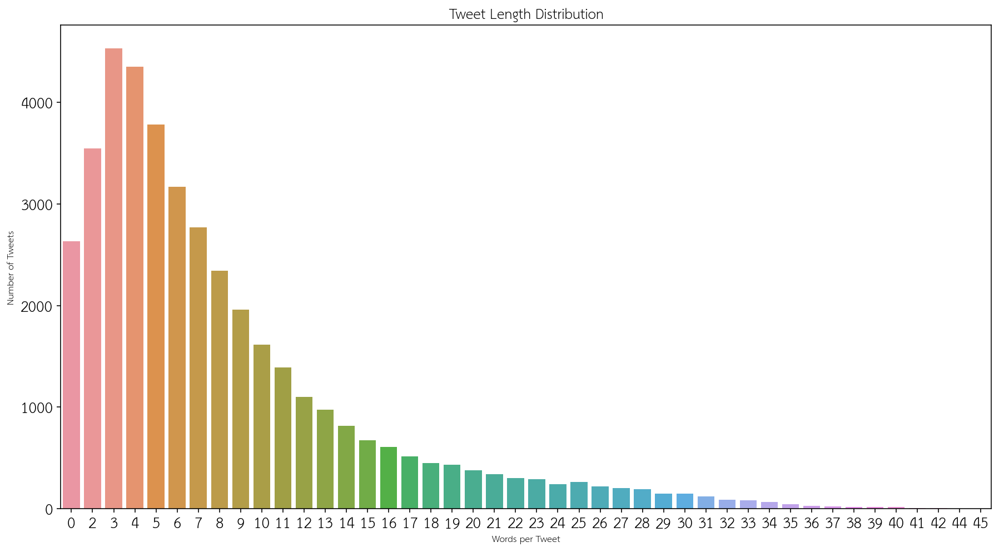

In [ ]:
plt.figure(figsize = (15,8))
sns.countplot(tweet_lengths)
plt.title('Tweet Length Distribution', fontsize = 18)
plt.xlabel('Words per Tweet', fontsize = 12)
plt.ylabel('Number of Tweets', fontsize = 12)
plt.show()

In [ ]:
def display_tweets_with_n_length(docs, min=1):
    count = 0
    for doc in docs:
        if doc != None and len(doc) == min:
            print(doc)
            count += 1
    print(count)

In [ ]:
def display_tweets_and_tokens_with_n_length(df, min=1):
    df['preprocessed_tokens'] = df['preprocessed_tokens'].apply(lambda x: [] if x is None else x)
    filtered_df = df[df['preprocessed_tokens'].apply(len) == min]
    return filtered_df

In [ ]:
filtered_df = display_tweets_and_tokens_with_n_length(tweets, min=2)

In [ ]:
filtered_df

,clenedText,preprocessed_tokens
2,นรอะ แต่ไม่ได้ใช้ไลน์แมน 555555,"[นรอะ, ใช้]"
4,ชอบสั่งกับไลน์แมนมากๆๆๆๆๆ ไม่นอกใจเลย,"[ชอบ, นอกใจ]"
5,มันจะมีไลน์แมนที่มาบ้านกุถูกบ้างมั้ย,"[บ้าน, ถูก]"
13,ไลน์แมนเป็นไรอะ ไม่โหลดร้านงง,"[โหลด, ร้าน]"
25,ไลน์แมนตั้งแต่เช้าเลยวะ ชอบๆ,"[เช้า, ชอบ]"
28,น้องไลน์แมนคุ้นๆพี่ๆมากเลยค้าบบบบ #ไลน์แมนประจำบ้าน #ดาวดวงใหม่น้องบิ๊บแลกฟอล,"[คุ้น, ค้าบ]"
42,โอเค ต้องสั่งในไลน์แมนถึงจะมีชานม,"[ชา, นม]"
65,ไลน์แมนเอาตาไปทิ้งค่ะ,"[ตา, ทิ้ง]"
68,มึง ไลน์แมนจะด่ากูปะ,"[ด่า, กูปะ]"
70,ขอตังพ่อมา 50 แต่ของในไลน์แมนต้อง 70 ขึ้น,"[ตัง, ขึ้น]"


## Wordcloud

In [ ]:
wordcloud = WordCloud(font_path = 'THSarabunNew.ttf',
                      width = 800,
                      height = 400,
                      max_words = 100,
                      background_color = 'white',
                      random_state = 123)

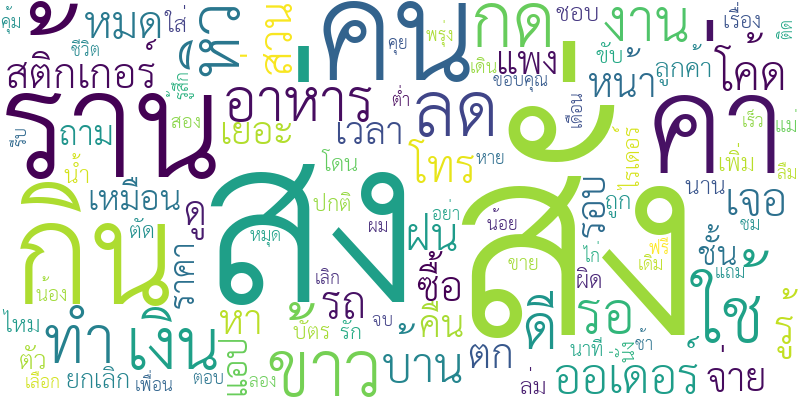

In [ ]:
wordcloud.generate_from_frequencies(freq_)
wordcloud.to_image()

In [ ]:
freq_ = Counter(all_tokens_cleaned_2)
freq_.most_common(10)

[('สั่ง', 2906),
 ('ส่ง', 2151),
 ('ร้าน', 1581),
 ('กิน', 1480),
 ('คน', 1399),
 ('ค่า', 1358),
 ('ข้าว', 1192),
 ('ใช้', 1177),
 ('กด', 1152),
 ('ลด', 1143)]

# **LDA** (BoW)
1. `passes` : controls **the number of times the entire corpus is processed during training**. Each pass involves iterating over all the documents in the corpus, and the model updates the topic distribution for each document based on the new topic distributions learned from the previous pass. More passes can lead to better topic modeling results, but can also increase the computational time.
2. `iterations` : controls **the number of times the model iterates over each document during training**. Each iteration updates the topic distribution for a given document based on the new topic distributions learned from the previous iteration. More iterations can lead to better convergence, but can also increase the computational time.
3. `chunksize` : controls **the number of documents that are processed in each batch during training**. Each batch is processed in parallel to speed up the training process. A larger chunk size can lead to faster training times, but can also require more memory.

In [ ]:
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [ ]:
def pivot_table_of_n_words(ldamodel, n_words=10):
    topic_words = []
    for topic_idx in range(ldamodel.num_topics):
        words = []
        for i in ldamodel.get_topic_terms(topic_idx, n_words):
            word = ldamodel.id2word[i[0]]
            words.append(word)
        topic_words.append(words)
    
    df = pd.DataFrame(topic_words).transpose()
    df.columns = ['Topic {}'.format(i+1) for i in range(df.shape[1])]
    return df

In [ ]:
def generate_wordcloud(df, save_name):
    k = df.shape[1]
    n_cols = 3
    n_rows = (k + n_cols - 1) // n_cols
    fig, ax = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
    ax = ax.ravel()
    for i in range(k):
        wordcloud = WordCloud(font_path = 'THSarabunNew.ttf',
                            width = 400,
                            height = 250,
                            background_color = 'white',
                            regexp = r'[ก-๙]+').generate_from_text(' '.join(df.iloc[:, i].values))
        ax[i].imshow(wordcloud)
        ax[i].axis('off')
        ax[i].set_title('Topic {}'.format(i+1))
    for i in range(k, n_rows * n_cols):
        ax[i].axis('off')
    plt.savefig(save_name)
    plt.show()

In [ ]:
from sklearn.model_selection import train_test_split

# Split into training and testing sets
train_tweets, test_tweets = train_test_split(alltweets, test_size=0.10, random_state=123)

# Construct Dictionary
all_dict = corpora.Dictionary(alltweets)
train_dict = corpora.Dictionary(train_tweets)
test_dict = corpora.Dictionary(test_tweets)

# Convert the training, validation, and test sets to bag-of-words representation
all_corpus_bow = [all_dict.doc2bow(doc) for doc in alltweets]
train_corpus_bow = [all_dict.doc2bow(doc) for doc in train_tweets]
test_corpus_bow = [all_dict.doc2bow(doc) for doc in test_tweets]

print('number of total tweets : {}'.format(len(alltweets)))
print('number of train tweets : {}'.format(len(train_tweets)))
print('number of test tweets : {}'.format(len(test_tweets)))

number of total tweets : 37748
number of train tweets : 33973
number of test tweets : 3775


## Unigram

In [ ]:
# dictionary.filter_extremes(no_below=5, no_above=0.7)

In [ ]:
lda_bow = LdaModel(corpus = all_corpus_bow, 
                   num_topics = 10, 
                   id2word = all_dict,
                   random_state = 123)

In [ ]:
for i in range(lda_bow.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_bow.show_topic(i)]))

1: ลด ส่วน บ้าน คุ้ม หน้า นาที ซื้อ พอยต์ หมด ตัว
2: ใช้ โค้ด กด แอป ชั้น เยอะ ส่วน ร้าน อาหาร ระบบ
3: ข้าว กิน ล่ม รอบ หิว เดือน เลิก ไรเดอร์ รับ รอ
4: ส่ง ค่า ขึ้น แพง อาหาร เพิ่ม ฟรี ลูกค้า สติกเกอร์ ผิด
5: โทร รอ นาน ทำ ถาม หมุด ปัก ช้า รู้ หา
6: ขับ รถ ตก ฝน เร็ว รับ กด แก้ว หิว รอ
7: ดี ไหว้ กด มือ เจอ รับ ขอบคุณ ปัง ซัก ไอ
8: ร้าน กิน อาหาร น้ำ ราคา อร่อย ไก่ ข้าว ซื้อ กาแฟ
9: รับ ออเดอร์ ขั้น ปัญหา หัว ปวด ปี ใส่ กด อย่า
10: เงิน ลด จ่าย ยกเลิก คืน ตัด บัตร ติดต่อ ผ่าน ส่วน


1. ?
2. 
3. ส่วนลด
4. 
5. ร้านอาหาร + การกดยกเลิกออร์เดอร์ + ราคาsthเพิ่ม
6. คนขับ 
7. การรออาหารมาส่ง
8. การตัดบัตร + รอรับเงินคืน
9. แอปล่ม + ฝนตก
10. การติดต่อระหว่างลูกค้า + การใช้สติกเกอร์ในแชท

In [ ]:
vis = gensimvis.prepare(lda_bow, all_corpus_bow, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.124924 -0.118858  1       1        16.187925
8      0.099142 -0.133855  2       1        13.510053
5     -0.238517  0.126776  3       1        11.831611
4      0.025195  0.032764  4       1        10.500805
9      0.000274 -0.003428  5       1        9.177739 
0      0.009701 -0.124393  6       1        8.741074 
6      0.230584  0.092836  7       1        8.136096 
1     -0.068311 -0.038704  8       1        8.033190 
7      0.035346 -0.069156  9       1        7.959978 
3      0.031509  0.236018  10      1        5.921529 , topic_info=              Term         Freq        Total Category  logprob  loglift
100    ข้าว         3891.000000  3891.000000  Default  30.0000  30.0000
207    เงิน         2769.000000  2769.000000  Default  29.0000  29.0000
140    ลด           4764.000000  4764.000000  Default  28.0000  28.0000
353    ค่า          3963.000000  3963.000000  Default  27.0000  27.0000
84     กด           4208.000000  4208.000000  Default  26.0000  26.0000
3981   ยกเลิก       1679.000000  1679.000000  Default  25.0000  25.0000
295    โค้ด         2795.000000  2795.000000  Default  24.0000  24.0000
4      โทร          3073.000000  3073.000000  Default  23.0000  23.0000
67     กิน          4824.000000  4824.000000  Default  22.0000  22.0000
1027   ออเดอร์      1937.000000  1937.000000  Default  21.0000  21.0000
115    ขับ          2316.000000  2316.000000  Default  20.0000  20.0000
255    งาน          1589.000000  1589.000000  Default  19.0000  19.0000
6      ใช้          4147.000000  4147.000000  Default  18.0000  18.0000
1785   นาน          1418.000000  1418.000000  Default  17.0000  17.0000
240    รับ          4311.000000  4311.000000  Default  16.0000  16.0000
9      ทำ           2564.000000  2564.000000  Default  15.0000  15.0000
674    ส่วน         2745.000000  2745.000000  Default  14.0000  14.0000
127    ส่ง          7310.000000  7310.000000  Default  13.0000  13.0000
1072   คุ้ม         932.000000   932.000000   Default  12.0000  12.0000
64     ตก           939.000000   939.000000   Default  11.0000  11.0000
65     ฝน           909.000000   909.000000   Default  10.0000  10.0000
477    คืน          1492.000000  1492.000000  Default  9.0000   9.0000 
217    ชั้น         1339.000000  1339.000000  Default  8.0000   8.0000 
10     บ้าน         2173.000000  2173.000000  Default  7.0000   7.0000 
47     หมด          1926.000000  1926.000000  Default  6.0000   6.0000 
572    ตัด          920.000000   920.000000   Default  5.0000   5.0000 
153    ถาม          1134.000000  1134.000000  Default  4.0000   4.0000 
1356   บัตร         701.000000   701.000000   Default  3.0000   3.0000 
408    รอ           2657.000000  2657.000000  Default  2.0000   2.0000 
780    ต่ำ          718.000000   718.000000   Default  1.0000   1.0000 
3247   เจ้า         130.105954   130.902468   Topic1  -5.9408   1.8148 
2005   ซ้อน         100.881536   101.678025   Topic1  -6.1952   1.8130 
3193   สิทธิ์       90.871464    91.668057    Topic1  -6.2997   1.8122 
7500   คะแนน        83.973283    84.769753    Topic1  -6.3786   1.8115 
578    สวัสดี       82.372157    83.168965    Topic1  -6.3979   1.8113 
2194   เมือง        69.719933    70.516520    Topic1  -6.5647   1.8095 
901    พลาด         67.574958    68.435250    Topic1  -6.5959   1.8083 
549    สะดวก        117.107628   118.724945   Topic1  -6.0460   1.8072 
1328   ซี           53.420020    54.216678    Topic1  -6.8310   1.8061 
1606   พื้นที่      55.166364    56.023944    Topic1  -6.7988   1.8055 
392    รายงาน       45.904383    46.700926    Topic1  -6.9826   1.8037 
1886   รายการ       73.425450    74.711458    Topic1  -6.5129   1.8035 
2937   อเมซอน       43.049843    43.857842    Topic1  -7.0468   1.8023 
2457   เโอ๊ย        46.433016    47.360379    Topic1  -6.9711   1.8011 
1632   ขวด          38.965791    39.762311    Topic1  -7.1465   1.800

In [ ]:
lda_bow_10_topics = pivot_table_of_n_words(lda_bow, 10)
lda_bow_10_topics

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10
0,ส่วน,งาน,ลด,กิน,ร้าน,ขับ,รอ,เงิน,ข้าว,ส่ง
1,ใส่,ต่ำ,โค้ด,รอบ,อาหาร,ใช้,รับ,จ่าย,ตก,ค่า
2,น้ำ,ทำ,ใช้,กด,ยกเลิก,รถ,ออเดอร์,คืน,ฝน,โทร
3,ร้าน,กิน,เยอะ,แอป,ค่า,ตัด,ส่ง,ส่วน,ล่ม,ส่วน
4,ลืม,ไก่,ซื้อ,อร่อย,กิน,ไรเดอร์,ขึ้น,ค่า,หิว,หา
5,บ้าน,รับ,คุ้ม,สอง,กด,กด,บ้าน,บัตร,รับ,ลูกค้า
6,ขาย,มื้อ,ฟรี,รับ,เลือก,ทิป,โทร,กด,หาย,สติกเกอร์
7,ไหว,ดี,ค่า,ร้าน,ข้าว,โปร,กิน,ครึ่ง,ส่ง,ตอบ
8,หน้า,ข้าว,หมด,ขนม,ราคา,เจอ,ข้าว,ผ่าน,หมด,ใช้
9,ดี,เลิก,ขั้น,อ่าน,เพิ่ม,unlimited,นาน,รับ,หนัก,ช้า


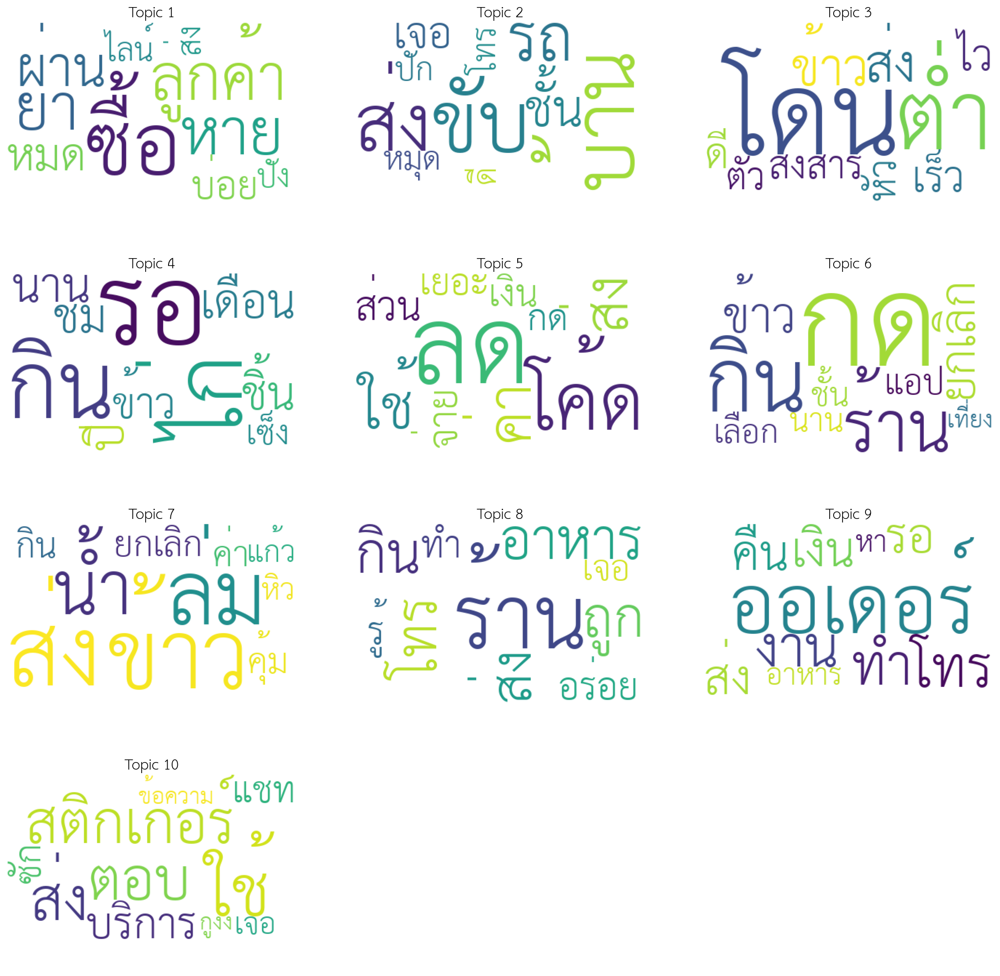

In [ ]:
generate_wordcloud(lda_bow_10_topics, 'lda_bow_10_topics.png')

### Tune N-topics (Unigram)

In [ ]:
coherence_by_k = []
start_k = 5
stop_k = 30

for k in range(start_k, stop_k+1):

    lda_model = LdaModel(corpus = all_corpus_bow,
                         id2word = all_dict,
                         num_topics = k, 
                         random_state = 123,
                         # default parameter
                         alpha = 'symmetric', # 1/k
                         eta = 'symmetric', # 1/k
                         passes = 1,
                         iterations = 50, 
                         chunksize = 2000)

    cm = CoherenceModel(model = lda_model, 
                        texts = alltweets, 
                        dictionary = all_dict, 
                        coherence = 'c_v')
    
    coherence_by_k.append((k, cm.get_coherence()))

    if k % 5 == 0:
        print('****proceeded k = {}'.format(k))

****proceeded k = 5
****proceeded k = 10
****proceeded k = 15
****proceeded k = 20
****proceeded k = 25
****proceeded k = 30


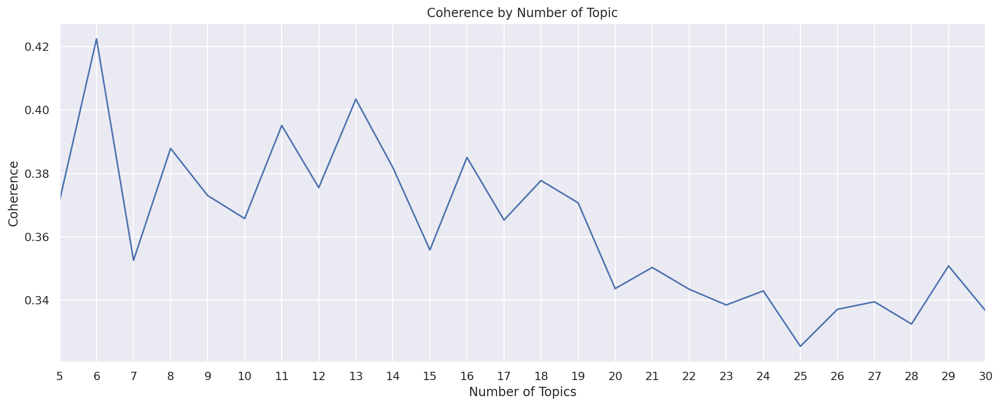

In [ ]:
sns.set(style='darkgrid')
plt.figure(figsize=(16, 6))
coherence_by_k_df = pd.DataFrame(coherence_by_k, columns=['n_topics', 'coherence'])
sns.lineplot(x='n_topics', y='coherence', data=coherence_by_k_df)
plt.xlim(5, 30)
plt.xticks(coherence_by_k_df['n_topics'])
plt.title("Coherence by Number of Topic")
plt.xlabel("Number of Topics")
plt.ylabel("Coherence")
plt.savefig('/content/drive/MyDrive/SeniorProject/SNpj_res/Pic/coherence_by_k_default_param.jpg')
plt.show()

#### 6 topics

In [ ]:
lda_bow_6_topics = LdaModel(corpus = all_corpus_bow, 
                            num_topics = 6, 
                            id2word = all_dict,
                            random_state = 123)

In [ ]:
for i in range(lda_bow_6_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_bow_6_topics.show_topic(i)]))

1: ร้าน ยกเลิก บ้าน ดี เจอ หน้า ส่วน อาหาร ตัว ทำ
2: ใช้ เงิน กด โค้ด จ่าย ทำ อาหาร ร้าน คืน ส่วน
3: ลด กิน ข้าว ส่วน โค้ด ร้าน ฟรี เยอะ ล่ม ผ่าน
4: ส่ง ค่า โทร รับ ออเดอร์ ขึ้น ข้าว ถาม ผิด ร้าน
5: กิน รอบ ต่ำ ลด ร้าน ไก่ โทร ราคา สอง ใส่
6: ขับ ตก ฝน รถ รอ รับ เร็ว นาที หมด หาย


In [ ]:
vis = gensimvis.prepare(lda_bow_6_topics, all_corpus_bow, all_dict)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.044408 -0.096121  1       1        21.205694
3     -0.132561 -0.188019  2       1        19.230982
0     -0.020501 -0.031134  3       1        17.731566
2      0.178948  0.069322  4       1        15.952326
5     -0.198680  0.199579  5       1        13.070125
4      0.128386  0.046372  6       1        12.809307, topic_info=              Term         Freq        Total Category  logprob  loglift
127    ส่ง          7366.000000  7366.000000  Default  30.0000  30.0000
6      ใช้          4211.000000  4211.000000  Default  29.0000  29.0000
140    ลด           5629.000000  5629.000000  Default  28.0000  28.0000
115    ขับ          2409.000000  2409.000000  Default  27.0000  27.0000
353    ค่า          4642.000000  4642.000000  Default  26.0000  26.0000
207    เงิน         2646.000000  2646.000000  Default  25.0000  25.0000
67     กิน          4664.000000  4664.000000  Default  24.0000  24.0000
4      โทร          3191.000000  3191.000000  Default  23.0000  23.0000
1024   ออเดอร์      1730.000000  1730.000000  Default  22.0000  22.0000
3977   ยกเลิก       1630.000000  1630.000000  Default  21.0000  21.0000
295    โค้ด         3046.000000  3046.000000  Default  20.0000  20.0000
240    รับ          4048.000000  4048.000000  Default  19.0000  19.0000
64     ตก           971.000000   971.000000   Default  18.0000  18.0000
10     บ้าน         2201.000000  2201.000000  Default  17.0000  17.0000
65     ฝน           939.000000   939.000000   Default  16.0000  16.0000
111    รถ           969.000000   969.000000   Default  15.0000  15.0000
671    ส่วน         3126.000000  3126.000000  Default  14.0000  14.0000
579    จ่าย         1301.000000  1301.000000  Default  13.0000  13.0000
777    ต่ำ          787.000000   787.000000   Default  12.0000  12.0000
156    รอบ          1566.000000  1566.000000  Default  11.0000  11.0000
168    ฟรี          805.000000   805.000000   Default  10.0000  10.0000
251    เร็ว         662.000000   662.000000   Default  9.0000   9.0000 
100    ข้าว         3577.000000  3577.000000  Default  8.0000   8.0000 
84     กด           3807.000000  3807.000000  Default  7.0000   7.0000 
475    คืน          1406.000000  1406.000000  Default  6.0000   6.0000 
57     แอป          1128.000000  1128.000000  Default  5.0000   5.0000 
272    นาที         823.000000   823.000000   Default  4.0000   4.0000 
557    ไก่          527.000000   527.000000   Default  3.0000   3.0000 
570    ตัด          779.000000   779.000000   Default  2.0000   2.0000 
20040  ล่ม          852.000000   852.000000   Default  1.0000   1.0000 
2644   ขั้น         581.320795   582.072958   Topic1  -4.7126   1.5496 
1500   ทิป          361.127566   361.872529   Topic1  -5.1886   1.5488 
6      ใช้          4196.711981  4211.360173  Topic1  -2.7358   1.5474 
284    ตัง          193.247896   194.053797   Topic1  -5.8139   1.5467 
813    ระบบ         401.545309   404.508555   Topic1  -5.0825   1.5435 
3189   สิทธิ์       97.498571    98.238523    Topic1  -6.4980   1.5433 
14700  unlimited    294.451507   296.800295   Topic1  -5.3928   1.5430 
743    บัญชี        128.858096   129.927370   Topic1  -6.2192   1.5426 
3632   scb          87.490180    88.226955    Topic1  -6.6063   1.5425 
949    เสียดาย      72.885332    73.654169    Topic1  -6.7890   1.5404 
1607   วิธี         69.587076    70.326698    Topic1  -6.8353   1.5403 
1555   กรอก         61.056266    61.796580    Topic1  -6.9661   1.5388 
3062   รายละเอียด   67.770146    68.640543    Topic1  -6.8617   1.5381 
4423   ชำระ         61.272882    62.063197    Topic1  -6.9625   1.5381 
3547   คอล          49.853061    50.591746    Topic1  -7.1688   1.5362 
5592   เมล          49.417152    50.155303    Topic1  -7.1776   1.5361 
1313   เลยย         57.676843    58.553976    Topic1  -7.0230   1.5358 
1443   เดอร์        48.202856    48.943024    Topic1  -7.2024   1.535

#### 8 topics

In [ ]:
lda_bow_8_topics = LdaModel(corpus = all_corpus_bow, 
                            num_topics = 8, 
                            id2word = all_dict,
                            random_state = 123)

In [ ]:
for i in range(lda_bow_8_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow_8_topics.show_topic(i)]))

0: ส่ง ส่วน ใช้ ดี ลูกค้า สติกเกอร์ ตอบ บ้าน ชอบ ตัว
1: รอ งาน ทำ กิน รับ ผม ครึ่ง วาง มื้อ นาน
2: ลด โค้ด ใช้ ส่วน ค่า ซื้อ เยอะ คุ้ม ขั้น ราคา
3: ยกเลิก อาหาร กิน รอบ ร้าน กด โดน ทิป แอป อร่อย
4: ร้าน กิน อาหาร ส่ง โทร ค่า กด ต่ำ ทำ ข้าว
5: ใช้ โทร นาน ส่ง บ้าน โค้ด ชั้น หมุด ถูก กด
6: ส่ง ข้าว รับ ค่า ออเดอร์ กิน ขับ กด รอ หิว
7: เงิน จ่าย คืน รับ บัตร ค่า เวลา กด ใช้ คุย


In [ ]:
vis = gensimvis.prepare(lda_bow_8_topics, all_corpus_bow, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4      0.044280  0.056659  1       1        17.881401
6      0.157060 -0.077086  2       1        17.770502
2     -0.279112 -0.062927  3       1        11.771664
1      0.181897 -0.055218  4       1        11.161591
7     -0.017977 -0.050369  5       1        11.073096
5     -0.022410 -0.072857  6       1        10.750938
0     -0.055895 -0.033164  7       1        10.486772
3     -0.007843  0.294961  8       1        9.104036 , topic_info=               Term         Freq        Total Category  logprob  loglift
140    ลด            4841.000000  4841.000000  Default  30.0000  30.0000
208    เงิน          3019.000000  3019.000000  Default  29.0000  29.0000
33     ร้าน          5662.000000  5662.000000  Default  28.0000  28.0000
296    โค้ด          2933.000000  2933.000000  Default  27.0000  27.0000
3985   ยกเลิก        1693.000000  1693.000000  Default  26.0000  26.0000
6      ใช้           4500.000000  4500.000000  Default  25.0000  25.0000
583    จ่าย          1516.000000  1516.000000  Default  24.0000  24.0000
127    ส่ง           7713.000000  7713.000000  Default  23.0000  23.0000
675    ส่วน          3090.000000  3090.000000  Default  22.0000  22.0000
1030   ออเดอร์       1878.000000  1878.000000  Default  21.0000  21.0000
100    ข้าว          3740.000000  3740.000000  Default  20.0000  20.0000
409    รอ            2725.000000  2725.000000  Default  19.0000  19.0000
478    คืน           1572.000000  1572.000000  Default  18.0000  18.0000
241    รับ           4201.000000  4201.000000  Default  17.0000  17.0000
256    งาน           1588.000000  1588.000000  Default  16.0000  16.0000
107    อาหาร         3364.000000  3364.000000  Default  15.0000  15.0000
4      โทร           3194.000000  3194.000000  Default  14.0000  14.0000
197    ลูกค้า        1152.000000  1152.000000  Default  13.0000  13.0000
354    ค่า           4682.000000  4682.000000  Default  12.0000  12.0000
307    สติกเกอร์     733.000000   733.000000   Default  11.0000  11.0000
67     กิน           4855.000000  4855.000000  Default  10.0000  10.0000
156    รอบ           1565.000000  1565.000000  Default  9.0000   9.0000 
115    ขับ           2134.000000  2134.000000  Default  8.0000   8.0000 
64     ตก            876.000000   876.000000   Default  7.0000   7.0000 
65     ฝน            849.000000   849.000000   Default  6.0000   6.0000 
1789   นาน           1338.000000  1338.000000  Default  5.0000   5.0000 
224    หมุด          592.000000   592.000000   Default  4.0000   4.0000 
31     ซื้อ          1094.000000  1094.000000  Default  3.0000   3.0000 
1075   คุ้ม          727.000000   727.000000   Default  2.0000   2.0000 
1118   ตอบ           668.000000   668.000000   Default  1.0000   1.0000 
781    ต่ำ           731.597876   732.439749   Topic1  -4.3152   1.7203 
362    ไข่           227.103229   228.071287   Topic1  -5.4850   1.7172 
2141   เครดิต        171.988345   172.722323   Topic1  -5.7630   1.7172 
3251   เจ้า          167.449452   168.182492   Topic1  -5.7898   1.7170 
1698   เบอร์         274.176272   275.711910   Topic1  -5.2967   1.7158 
1400   ค้าง          125.802125   126.535315   Topic1  -6.0757   1.7156 
3197   สิทธิ์        117.573204   118.307387   Topic1  -6.1434   1.7152 
388    ห่าง          126.298843   127.187138   Topic1  -6.0718   1.7144 
2486   จอง           83.799612    84.535301    Topic1  -6.4820   1.7127 
1614   วิธี          83.452729    84.186418    Topic1  -6.4862   1.7127 
1971   เริ่มต้น      83.240118    83.973737    Topic1  -6.4887   1.7126 
20437  ส่งบาท        91.566919    92.386120    Topic1  -6.3934   1.7125 
1697   ลา            71.495814    72.232645    Topic1  -6.6408   1.7112 
1490   เนอะ          70.357516    71.091284    Topic1  -6.6569   1.7110 
2487   ช่องทาง       72.618855    73.376788    Topic1  -6.6252   1.7110 
12     ออฟฟิศ        62.289818    63.023223    Topic1  -6.7

#### 11 topics

In [ ]:
lda_bow_11_topics = LdaModel(corpus = all_corpus_bow, 
                            num_topics = 11, 
                            id2word = all_dict,
                            random_state = 123)

In [ ]:
for i in range(lda_bow_11_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow_11_topics.show_topic(i)]))

0: ส่วน หน้า ลูกค้า ลืม โปร ไลน์ ตัว ดี พนักงาน ยืน
1: นาน ต่ำ ฟรี งาน เลิก รอ ทำ รับ ข้อความ ครึ่ง
2: ลด ใช้ โค้ด เยอะ คุ้ม ซื้อ ขั้น คูปอง หมด พอยต์
3: กด แอป โค้ด unlimited ชม ใช้ โมโห จบ ต่าง ดอก
4: ร้าน อาหาร ยกเลิก กด กิน ค่า ราคา ขึ้น ถูก นาที
5: ขับ บ้าน เจอ รถ หมุด ปัก ถูก โทร หา ไรเดอร์
6: รับ รอ ออเดอร์ โทร ส่ง ตัด กด เรื่อง ช้า รู้
7: เงิน จ่าย คืน ค่า ขึ้น บัตร เดือน เพิ่ม ระบบ ส่วน
8: ตก ฝน ผิด ส่ง รอบ กด ข้าว หาย รับ วาง
9: ส่ง ค่า ทำ งาน อาหาร ใช้ สติกเกอร์ โทร รับ หา
10: กิน ข้าว ล่ม หิว โมง มื้อ เช้า เที่ยง อร่อย เย็น


In [ ]:
vis = gensimvis.prepare(lda_bow_11_topics, all_corpus_bow, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.022439 -0.032753  1       1        14.628317
6     -0.150441  0.070810  2       1        11.424886
9     -0.078935  0.162062  3       1        9.885199 
5     -0.101177  0.035541  4       1        9.621465 
10    -0.002354 -0.209220  5       1        9.439836 
7      0.022643  0.134628  6       1        9.281539 
2      0.336375  0.091901  7       1        8.991137 
0     -0.008508 -0.009610  8       1        6.973110 
8     -0.091803 -0.017490  9       1        6.941879 
1     -0.065975 -0.117653  10      1        6.908607 
3      0.162614 -0.108216  11      1        5.904025 , topic_info=               Term         Freq        Total Category  logprob  loglift
140    ลด            4488.000000  4488.000000  Default  30.0000  30.0000
127    ส่ง           7270.000000  7270.000000  Default  29.0000  29.0000
33     ร้าน          5791.000000  5791.000000  Default  28.0000  28.0000
208    เงิน          2822.000000  2822.000000  Default  27.0000  27.0000
67     กิน           5224.000000  5224.000000  Default  26.0000  26.0000
675    ส่วน          3434.000000  3434.000000  Default  25.0000  25.0000
296    โค้ด          2803.000000  2803.000000  Default  24.0000  24.0000
6      ใช้           4177.000000  4177.000000  Default  23.0000  23.0000
100    ข้าว          4036.000000  4036.000000  Default  22.0000  22.0000
354    ค่า           4559.000000  4559.000000  Default  21.0000  21.0000
1030   ออเดอร์       1813.000000  1813.000000  Default  20.0000  20.0000
115    ขับ           2128.000000  2128.000000  Default  19.0000  19.0000
241    รับ           4107.000000  4107.000000  Default  18.0000  18.0000
583    จ่าย          1422.000000  1422.000000  Default  17.0000  17.0000
409    รอ            2588.000000  2588.000000  Default  16.0000  16.0000
3985   ยกเลิก        1534.000000  1534.000000  Default  15.0000  15.0000
478    คืน           1450.000000  1450.000000  Default  14.0000  14.0000
84     กด            4223.000000  4223.000000  Default  13.0000  13.0000
1789   นาน           1457.000000  1457.000000  Default  12.0000  12.0000
4      โทร           3214.000000  3214.000000  Default  11.0000  11.0000
64     ตก            916.000000   916.000000   Default  10.0000  10.0000
65     ฝน            888.000000   888.000000   Default  9.0000   9.0000 
781    ต่ำ           752.000000   752.000000   Default  8.0000   8.0000 
20053  ล่ม           1045.000000  1045.000000  Default  7.0000   7.0000 
10     บ้าน          2070.000000  2070.000000  Default  6.0000   6.0000 
2      ผิด           1166.000000  1166.000000  Default  5.0000   5.0000 
224    หมุด          672.000000   672.000000   Default  4.0000   4.0000 
256    งาน           1431.000000  1431.000000  Default  3.0000   3.0000 
169    ฟรี           874.000000   874.000000   Default  2.0000   2.0000 
1075   คุ้ม          675.000000   675.000000   Default  1.0000   1.0000 
3985   ยกเลิก        1533.475343  1534.880511  Topic1  -3.3744   1.9213 
2141   เครดิต        176.893812   177.658060   Topic1  -5.5341   1.9179 
3197   สิทธิ์        120.917919   121.682186   Topic1  -5.9145   1.9159 
826    ห่วย          122.096912   122.872693   Topic1  -5.9048   1.9159 
388    ห่าง          129.947691   130.811719   Topic1  -5.8425   1.9156 
1400   ค้าง          129.223767   130.164537   Topic1  -5.8481   1.9150 
2486   จอง           86.176663    86.941352    Topic1  -6.2533   1.9134 
1182   ยำ            117.216498   118.436641   Topic1  -5.9456   1.9119 
1490   เนอะ          72.347266    73.111496    Topic1  -6.4282   1.9117 
1685   ข้อมูล        63.469174    64.233404    Topic1  -6.5591   1.9102 
1459   เดินทาง       62.394300    63.158524    Topic1  -6.5762   1.9100 
3616   ถัด           57.225710    57.989997    Topic1  -6.6626   1.9089 
559    โล            88.344143    89.562900    Topic1  -6.2284   1.9085 
562    เท            56.976382    57.765287

#### 13 topics

In [ ]:
lda_bow_13_topics = LdaModel(corpus = all_corpus_bow, 
                            num_topics = 13, 
                            id2word = all_dict,
                            random_state = 123)

In [ ]:
for i in range(lda_bow_13_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow_13_topics.show_topic(i)]))

0: บ้าน ร้าน ไก่ หัว ค้า ขาย ลืม ยอด ปวด หน้า
1: รอ นาที นาน ผม ตอบ ถาม ไว รถ ติดต่อ กลัว
2: ลด โค้ด ขั้น ใช้ คูปอง ปัญหา พอยต์ แก้ว ซื้อ แถม
3: ลด ส่วน คุ้ม อาหาร ฟรี ซื้อ ใช้ ราคา เยอะ ค่า
4: ร้าน ค่า ส่ง เพิ่ม โค้ด เยอะ ราคา กิน น้ำ ใส่
5: ยกเลิก กด ขับ รอบ เจอ งาน ลด ไรเดอร์ อาหาร ทิป
6: รับ ออเดอร์ ขับ ตัด ร้าน ส่ง กิน ข้าว ช้า เร็ว
7: เงิน จ่าย คืน ค่า กด รับ บัตร ระบบ ส่วน ครึ่ง
8: ส่ง โทร ผิด หาย ข้าว รอบ รับ หมด ไหว้ อาหาร
9: ส่ง ค่า โทร ขึ้น หา ตก ฝน สติกเกอร์ ต่ำ รับ
10: กิน ข้าว ล่ม ทำ หิว กด ชอบ โมง รอบ เที่ยง
11: ดี ร้าน ชั้น อาหาร ใช้ บ่อย กิน บริการ อร่อย ลอง
12: ใช้ โค้ด แอป หมุด ปัก ขึ้น ดี หมด กด เพื่อน


1. ?
2. รอนาน/
3. ปัญหาของ ส่วนลด/พอยต์ ? + แถม
4. ส่วนลด + ฟรี?
5. การกดยกเลิกออเดอร์ + การให้ทิปไรเดอร์
ุ6. การรับออเดอร์ของไรเดอร์ + การส่งช้า/เร็ว
7. การคืนเงิน + การจ่ายเงิน
8. ส่งผิด + ข้าวหาย + 
9. ค่าส่งขึ้น + ฝนตก + สติกเกอร์
10. หิว + แอปล่ม
11. รีวิวร้านอาหาร
12. ใช้ส่วนลด + การปักหมุดจุดหมาย

In [ ]:
vis = gensimvis.prepare(lda_bow_13_topics, all_corpus_bow, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
4     -0.019619  0.124707  1       1        9.204461
9      0.170630 -0.083042  2       1        9.043302
6      0.162466 -0.028288  3       1        8.778199
7     -0.016807 -0.041985  4       1        8.557850
5      0.046480 -0.066143  5       1        8.526360
10     0.031136  0.143033  6       1        7.976023
12    -0.095897 -0.035169  7       1        7.571961
3     -0.235470  0.011319  8       1        7.438324
11    -0.043292  0.173524  9       1        7.015679
0      0.019075  0.124769  10      1        6.713574
8      0.120665 -0.003488  11      1        6.635689
1      0.132624 -0.155349  12      1        6.604843
2     -0.271990 -0.163888  13      1        5.933735, topic_info=               Term         Freq        Total Category  logprob  loglift
140    ลด            5140.000000  5140.000000  Default  30.0000  30.0000
208    เงิน          2726.000000  2726.000000  Default  29.0000  29.0000
127    ส่ง           7578.000000  7578.000000  Default  28.0000  28.0000
67     กิน           5089.000000  5089.000000  Default  27.0000  27.0000
296    โค้ด          3187.000000  3187.000000  Default  26.0000  26.0000
409    รอ            2728.000000  2728.000000  Default  25.0000  25.0000
1030   ออเดอร์       1862.000000  1862.000000  Default  24.0000  24.0000
33     ร้าน          5814.000000  5814.000000  Default  23.0000  23.0000
6      ใช้           4536.000000  4536.000000  Default  22.0000  22.0000
100    ข้าว          3934.000000  3934.000000  Default  21.0000  21.0000
675    ส่วน          2967.000000  2967.000000  Default  20.0000  20.0000
354    ค่า           4597.000000  4597.000000  Default  19.0000  19.0000
3985   ยกเลิก        1494.000000  1494.000000  Default  18.0000  18.0000
4      โทร           3180.000000  3180.000000  Default  17.0000  17.0000
241    รับ           4078.000000  4078.000000  Default  16.0000  16.0000
583    จ่าย          1368.000000  1368.000000  Default  15.0000  15.0000
115    ขับ           2174.000000  2174.000000  Default  14.0000  14.0000
478    คืน           1404.000000  1404.000000  Default  13.0000  13.0000
57     แอป           1149.000000  1149.000000  Default  12.0000  12.0000
84     กด            3974.000000  3974.000000  Default  11.0000  11.0000
573    ตัด           920.000000   920.000000   Default  10.0000  10.0000
10     บ้าน          2155.000000  2155.000000  Default  9.0000   9.0000 
1075   คุ้ม          746.000000   746.000000   Default  8.0000   8.0000 
20053  ล่ม           1008.000000  1008.000000  Default  7.0000   7.0000 
64     ตก            798.000000   798.000000   Default  6.0000   6.0000 
273    นาที          808.000000   808.000000   Default  5.0000   5.0000 
65     ฝน            773.000000   773.000000   Default  4.0000   4.0000 
130    ดี            2521.000000  2521.000000  Default  3.0000   3.0000 
2652   ขั้น          621.000000   621.000000   Default  2.0000   2.0000 
156    รอบ           1584.000000  1584.000000  Default  1.0000   1.0000 
1280   สุภาพ         98.626736    99.419840    Topic1  -5.6550   2.3775 
1614   วิธี          86.284705    87.056168    Topic1  -5.7887   2.3766 
3070   รายละเอียด    83.562611    84.334078    Topic1  -5.8208   2.3763 
20437  ส่งบาท        94.641009    95.555954    Topic1  -5.6963   2.3759 
876    เส้น          86.276930    87.135809    Topic1  -5.7888   2.3756 
2346   เค้ก          152.614664   154.142690   Topic1  -5.2185   2.3755 
1033   ผัก           76.568391    77.385169    Topic1  -5.9082   2.3749 
1331   ซี            70.829143    71.600603    Topic1  -5.9861   2.3746 
950    เพลง          84.226308    85.251883    Topic1  -5.8129   2.3734 
3616   ถัด           57.532837    58.304303    Topic1  -6.1940   2.3722 
1089   จา            50.761411    51.532872    Topic1  -6.3192   2.3704 
2178   พริก          45.624748    46.484898    Topic1  -6.4259   2.3668 
369    ธรรมดา        40

#### 14 topics

In [ ]:
lda_bow_14_topics = LdaModel(corpus = all_corpus_bow, 
                             num_topics = 14, 
                             id2word = all_dict,
                             random_state = 123)

In [ ]:
for i in range(lda_bow_14_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_bow_14_topics.show_topic(i)]))

1: บ้าน หน้า ลืม ไก่ ดู ใส่ ยืน ส่วน ร้าน ขับ
2: รอ งาน นาน นาที รับ ทำ ชม ผม ไว หนัก
3: ลด โค้ด ใช้ คุ้ม ซื้อ เยอะ ตอบ เลิก พอยต์ แถม
4: อาหาร ไรเดอร์ บ่อย ส่วน โมโห เอ้า ไหว ปัง ทำ ตัว
5: ร้าน อาหาร ติดต่อ ปัก ทำ เยอะ ถาม กิน เลือก โทร
6: ลด ถูก หมุด ตัด ใช้ ฟรี เล่น บ้าน ใส่ เยอะ
7: ออเดอร์ รับ ขับ ส่ง เร็ว โดน กด ช้า ชั้น หาย
8: เงิน จ่าย คืน ค่า บัตร เพิ่ม ผ่าน เรื่อง โอน สด
9: โทร ข้าว ส่ง ขับ รับ ล่ม ผิด หิว วาง สาย
10: ส่ง ค่า ยกเลิก ส่วน ลูกค้า ใช้ สติกเกอร์ หา โทร แพง
11: กิน ข้าว รอบ มื้อ ชอบ สอง ร้าน นาน อร่อย หา
12: ดี รับ บริการ ขาย ปี แย่ ทำ ใช้ เจอ งี้
13: กด ใช้ ส่วน ลด แอป ตก ฝน โค้ด รับ หมด
14: ขึ้น ต่ำ ขั้น ราคา หมู ส่วน ซื้อ แพง เติม ร้าน


In [ ]:
vis = gensimvis.prepare(lda_bow_14_topics, all_corpus_bow, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.066390 -0.113418  1       1        10.101052
9     -0.025183  0.187096  2       1        8.707716 
6     -0.111981  0.085003  3       1        8.527276 
8     -0.148723  0.085283  4       1        8.309546 
12     0.170060  0.079266  5       1        7.809371 
10    -0.131389 -0.035906  6       1        7.712387 
7      0.081382  0.156361  7       1        7.247479 
2      0.298991 -0.005995  8       1        6.974015 
1     -0.112883  0.087645  9       1        6.646163 
0     -0.055857 -0.091517  10      1        6.115164 
11    -0.012048 -0.037740  11      1        5.993055 
5      0.129178 -0.068124  12      1        5.986455 
13    -0.026649 -0.187458  13      1        5.374634 
3      0.011491 -0.140496  14      1        4.495689 , topic_info=               Term         Freq        Total Category  logprob  loglift
127    ส่ง           7084.000000  7084.000000  Default  30.0000  30.0000
140    ลด            4921.000000  4921.000000  Default  29.0000  29.0000
208    เงิน          2873.000000  2873.000000  Default  28.0000  28.0000
67     กิน           4912.000000  4912.000000  Default  27.0000  27.0000
354    ค่า           4303.000000  4303.000000  Default  26.0000  26.0000
33     ร้าน          5746.000000  5746.000000  Default  25.0000  25.0000
409    รอ            2703.000000  2703.000000  Default  24.0000  24.0000
296    โค้ด          2810.000000  2810.000000  Default  23.0000  23.0000
1030   ออเดอร์       1888.000000  1888.000000  Default  22.0000  22.0000
4      โทร           3255.000000  3255.000000  Default  21.0000  21.0000
6      ใช้           4374.000000  4374.000000  Default  20.0000  20.0000
583    จ่าย          1447.000000  1447.000000  Default  19.0000  19.0000
100    ข้าว          3751.000000  3751.000000  Default  18.0000  18.0000
84     กด            3859.000000  3859.000000  Default  17.0000  17.0000
107    อาหาร         3302.000000  3302.000000  Default  16.0000  16.0000
675    ส่วน          3110.000000  3110.000000  Default  15.0000  15.0000
130    ดี            2591.000000  2591.000000  Default  14.0000  14.0000
3985   ยกเลิก        1271.000000  1271.000000  Default  13.0000  13.0000
241    รับ           4201.000000  4201.000000  Default  12.0000  12.0000
478    คืน           1455.000000  1455.000000  Default  11.0000  11.0000
115    ขับ           2204.000000  2204.000000  Default  10.0000  10.0000
15     ถูก           1024.000000  1024.000000  Default  9.0000   9.0000 
1789   นาน           1442.000000  1442.000000  Default  8.0000   8.0000 
256    งาน           1515.000000  1515.000000  Default  7.0000   7.0000 
781    ต่ำ           811.000000   811.000000   Default  6.0000   6.0000 
2652   ขั้น          775.000000   775.000000   Default  5.0000   5.0000 
57     แอป           1178.000000  1178.000000  Default  4.0000   4.0000 
10     บ้าน          2168.000000  2168.000000  Default  3.0000   3.0000 
156    รอบ           1590.000000  1590.000000  Default  2.0000   2.0000 
255    ขึ้น          2315.000000  2315.000000  Default  1.0000   1.0000 
2141   เครดิต        175.186636   175.970875   Topic1  -5.1735   2.2881 
648    พิเศษ         137.567320   138.630632   Topic1  -5.4152   2.2848 
37     ตีน           98.308709    99.104160    Topic1  -5.7512   2.2845 
2486   จอง           85.335086    86.120992    Topic1  -5.8927   2.2834 
1614   วิธี          84.981144    85.765382    Topic1  -5.8969   2.2833 
3070   รายละเอียด    82.294648    83.084185    Topic1  -5.9290   2.2830 
1316   สำเร็จ        66.079076    66.869635    Topic1  -6.1485   2.2806 
181    ส้น           63.509197    64.293433    Topic1  -6.1881   2.2803 
894    กุ้ง          64.513995    65.320260    Topic1  -6.1725   2.2801 
6499   พอยต์ท์       60.852734    61.646446    Topic1  -6.2309   2.2796 
939    พิกัด         62.381057    63.209253    Topic1  -6.2061   2.2793 
3616   ถัด           56.662

#### 16 topics

In [ ]:
lda_bow_16_topics = LdaModel(corpus = all_corpus_bow, 
                             num_topics = 16, 
                             id2word = all_dict,
                             random_state = 123)

In [ ]:
for i in range(lda_bow_16_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_bow_16_topics.show_topic(i)]))

1: บ้าน หน้า ใส่ ค้า ร้าน ยืน ส่วน เจอ หมู ชื่อ
2: รอ ชม เลิก นาที นั่ง ครึ่ง วาง กาแฟ ส่ง แก้ว
3: ลด โค้ด ใช้ เยอะ ซื้อ คุ้ม หมด ขั้น คูปอง กด
4: ไรเดอร์ ครบ โมโห อ่าน บ่อย เสียง อิ่ม สงสาร ขาด ไหว
5: ขับ ผิด หมุด ปัก บ้าน ส่ง เจอ รถ โทร ร้าน
6: ยกเลิก นาน ขับ กด ทิป รถ ถูก ชั้น โดน เลข
7: ค่า ส่ง ออเดอร์ ขึ้น ตัด รับ แพง ติดต่อ ช้า ฟรี
8: เงิน จ่าย คืน บัตร เลือก กด โอน ผ่าน สด ใช้
9: รับ กด รอบ โทร ตก ฝน หาย ข้าว หมด ส่ง
10: ส่ง ใช้ ลูกค้า สติกเกอร์ อาหาร โทร ดี ทำ ตอบ ขอบคุณ
11: กิน ข้าว ล่ม ทำ หิว เที่ยง เบื่อ หา หมด รู้
12: ดี กิน ร้าน อร่อย ลอง ไก่ ขาย เยอะ เจอ มื้อ
13: งาน กด โทร แอป ระบบ ชั่วโมง โมง เย็น สอง ส่วน
14: ส่วน ต่ำ น้ำ ติด เปล่า ไอ ตา รับ สะดวก ตลก
15: ร้าน อาหาร ราคา เพิ่ม ชอบ ขึ้น ทำ หัก โทร กิน
16: โดน ลืม จบ แจ้ง ด่า โทร งาน อย่า ตอบ ส่วน


In [ ]:
vis = gensimvis.prepare(lda_bow_16_topics, all_corpus_bow, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
6     -0.029324 -0.077793  1       1        8.455617
2     -0.344207  0.085410  2       1        7.980352
10     0.116056  0.012327  3       1        7.553950
14     0.008000  0.164908  4       1        7.288800
9     -0.059604 -0.127499  5       1        7.023610
8      0.038070 -0.156930  6       1        6.590955
4      0.096408 -0.010356  7       1        6.585387
11     0.047873  0.192163  8       1        6.509046
7     -0.170819 -0.035337  9       1        6.332439
12    -0.033727 -0.120639  10      1        5.769794
5      0.012688 -0.028604  11      1        5.664842
1      0.090513 -0.130736  12      1        5.572532
15     0.042815 -0.088019  13      1        5.233832
0      0.079902  0.139503  14      1        5.125594
13     0.071343  0.082457  15      1        4.305170
3      0.034011  0.099144  16      1        4.008080, topic_info=               Term         Freq        Total Category  logprob  loglift
140    ลด            4264.000000  4264.000000  Default  30.0000  30.0000
208    เงิน          2837.000000  2837.000000  Default  29.0000  29.0000
67     กิน           5173.000000  5173.000000  Default  28.0000  28.0000
33     ร้าน          5851.000000  5851.000000  Default  27.0000  27.0000
127    ส่ง           7022.000000  7022.000000  Default  26.0000  26.0000
409    รอ            2572.000000  2572.000000  Default  25.0000  25.0000
354    ค่า           4376.000000  4376.000000  Default  24.0000  24.0000
296    โค้ด          2568.000000  2568.000000  Default  23.0000  23.0000
675    ส่วน          3396.000000  3396.000000  Default  22.0000  22.0000
100    ข้าว          3981.000000  3981.000000  Default  21.0000  21.0000
6      ใช้           4047.000000  4047.000000  Default  20.0000  20.0000
241    รับ           4190.000000  4190.000000  Default  19.0000  19.0000
115    ขับ           2201.000000  2201.000000  Default  18.0000  18.0000
3985   ยกเลิก        1479.000000  1479.000000  Default  17.0000  17.0000
1030   ออเดอร์       1670.000000  1670.000000  Default  16.0000  16.0000
583    จ่าย          1429.000000  1429.000000  Default  15.0000  15.0000
1789   นาน           1417.000000  1417.000000  Default  14.0000  14.0000
478    คืน           1463.000000  1463.000000  Default  13.0000  13.0000
10     บ้าน          2217.000000  2217.000000  Default  12.0000  12.0000
4      โทร           3264.000000  3264.000000  Default  11.0000  11.0000
64     ตก            889.000000   889.000000   Default  10.0000  10.0000
156    รอบ           1576.000000  1576.000000  Default  9.0000   9.0000 
65     ฝน            862.000000   862.000000   Default  8.0000   8.0000 
305    ราคา          1172.000000  1172.000000  Default  7.0000   7.0000 
84     กด            4007.000000  4007.000000  Default  6.0000   6.0000 
781    ต่ำ           747.000000   747.000000   Default  5.0000   5.0000 
2      ผิด           1153.000000  1153.000000  Default  4.0000   4.0000 
392    เพิ่ม         1035.000000  1035.000000  Default  3.0000   3.0000 
573    ตัด           828.000000   828.000000   Default  2.0000   2.0000 
20053  ล่ม           999.000000   999.000000   Default  1.0000   1.0000 
1030   ออเดอร์       1668.121326  1670.388954  Topic1  -2.7421   2.4690 
4671   ธนาคาร        136.722330   137.552644   Topic1  -5.2436   2.4643 
2733   ยืนยัน        112.028972   112.876560   Topic1  -5.4428   2.4628 
2198   เมือง         79.911009    80.718987    Topic1  -5.7806   2.4603 
3510   เน็ต          79.156335    79.964313    Topic1  -5.7901   2.4602 
3070   รายละเอียด    71.648098    72.465566    Topic1  -5.8898   2.4590 
717    ประเด็น       67.942185    68.755150    Topic1  -5.9429   2.4584 
573    ตัด           816.839407   828.922655   Topic1  -3.4561   2.4557 
3542   กลิ่น         46.435994    47.243973    Topic1  -6.3234   2.4531 
4452   เร่ง          45.411480    46.237124    Topic1  -6.3458   2.4523 
1705   แพค

### Tuning **Num Topic**, **Alpha**, and **Eta**

In [ ]:
model_results_df = pd.DataFrame(columns=['num_topic', 'alpha', 'eta', 'coherence'])

In [ ]:
model_results_df = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/model_result_3.csv')

In [ ]:
model_results_df.num_topic.unique()

array([ 3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13., 14., 15.,
       16., 17., 18., 19., 20., 21., 22., 23., 24., 25., 26., 27., 28.,
       29., 30., 31., 32., 33., 34., 35., 36., 37., 38., 39., 40., 41.,
       42., 43., 44., 45., 46., 47., 48., 49., 50.])

In [ ]:
model_results_df.num_topic.unique()

array([ 5.,  6.,  7.,  8.,  9., 10., 11., 12., 13., 14., 15., 16., 17.,
       18., 19., 20., 21., 22., 23., 24., 25., 26., 27., 28., 29., 30.,
       31., 32., 33., 34., 35., 36., 37., 38., 39., 40., 41., 42., 43.,
       44., 45., 46., 47., 48., 49., 50.])

In [ ]:
# Topics range
min_topics = 3
max_topics = 50
step_size = 1
topics_grid = range(min_topics, max_topics+1, step_size)

# Alpha parameter
alpha_grid = [round(a,2) for a in list(np.arange(0.01, 1, 0.2))]
alpha_grid.append('symmetric')
alpha_grid.append('asymmetric')
alpha_grid.append('auto')

# Eta parameter
eta_gird = [round(e,2) for e in list(np.arange(0.01, 1, 0.2))]
eta_gird.append('symmetric')
eta_gird.append('auto')

In [ ]:
import tqdm

In [ ]:
# iterate through number of topics
for num_topic in tqdm.tqdm(topics_grid):
    # iterate through alpha values
    for alpha in alpha_grid:
        # iterare through beta values
        for eta in eta_gird:
            
            if not (((model_results_df['num_topic'] == num_topic) & \
                    (model_results_df['alpha'] == str(alpha)) & \
                    (model_results_df['eta'] == str(eta))).any() \
                    or
                    ((model_results_df['num_topic'] == num_topic) & \
                    (model_results_df['alpha'] == alpha) & \
                    (model_results_df['eta'] == eta)).any()):

                    lda_model = LdaModel(corpus = all_corpus_bow,
                                         id2word = all_dict,
                                         num_topics = num_topic, 
                                         random_state = 123,
                                         alpha = alpha, 
                                         eta = eta, 
                                         # default parameter
                                         passes = 1,
                                         iterations = 50, 
                                         chunksize = 2000)

                    cm = CoherenceModel(model = lda_model, 
                                        texts = alltweets, 
                                        dictionary = all_dict, 
                                        coherence = 'c_v')
                    
                    coherence = cm.get_coherence()

                    model_results_df = model_results_df.append(
                         {
                            'num_topic' : num_topic, 
                            'alpha' : alpha, 
                            'eta' : eta, 
                            'coherence': coherence
                         }, 
                         ignore_index=True)
                    
                    try:
                        prev_num_topic = model_results_df.num_topic.iloc[-2]
                    except:
                        print("there's no previous row yet")

                    current_num_tipic = model_results_df.num_topic.iloc[-1]

                    if  prev_num_topic == (current_num_tipic - 1):
                        model_results_df.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/model_result_3.csv', index=False)
                        print('****proceeded k = {}'.format(current_num_tipic))
            else:
                continue

100%|██████████| 46/46 [01:07<00:00,  1.46s/it]


In [ ]:
model_results_df[model_results_df['num_topic']==5]

,num_topic,alpha,eta,coherence
0,5.0,0.01,0.01,0.371930
1,5.0,0.01,0.21,0.363486
2,5.0,0.01,0.41,0.366047
3,5.0,0.01,0.61,0.345917
4,5.0,0.01,0.81,0.359985
5,5.0,0.01,symmetric,0.363411
6,5.0,0.01,auto,0.378739
7,5.0,0.21,0.01,0.336280
8,5.0,0.21,0.21,0.362842
9,5.0,0.21,0.41,0.366069


###  **Alpha** and **Eta**

In [ ]:
model_results_df = pd.read_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/model_result_3_1.csv')

In [ ]:
model_results_df_2 = model_results_df[model_results_df.num_topic <= 30]

In [ ]:
model_results_df_2.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/model_result_3_5to30.csv')

In [ ]:
def convert_to_float(value):
    try:
        return float(value)
    except ValueError:
        return value

In [ ]:
model_results_df['alpha'] = model_results_df['alpha'].apply(convert_to_float)
model_results_df['eta'] = model_results_df['eta'].apply(convert_to_float)

In [ ]:
model_results_df_2.groupby(['alpha', 'eta'])['coherence'].mean().sort_values(ascending=False)

alpha       eta      
asymmetric  0.61         0.536193
            0.41         0.516057
            0.81         0.512368
auto        0.81         0.462268
symmetric   0.81         0.458911
0.01        0.81         0.455800
            0.61         0.453862
auto        0.61         0.453401
symmetric   0.61         0.446405
0.21        0.81         0.444595
asymmetric  0.21         0.427383
0.01        0.41         0.423752
auto        0.41         0.422315
symmetric   0.41         0.419228
0.21        0.61         0.416953
0.41        0.81         0.409358
            0.61         0.394528
0.21        0.41         0.388200
0.01        0.21         0.381988
0.61        auto         0.380162
auto        0.21         0.380028
symmetric   0.21         0.377712
0.41        0.41         0.374773
0.61        symmetric    0.371081
            0.21         0.368482
            0.01         0.366301
0.01        auto         0.366142
            symmetric    0.365035
0.81        0.21         0

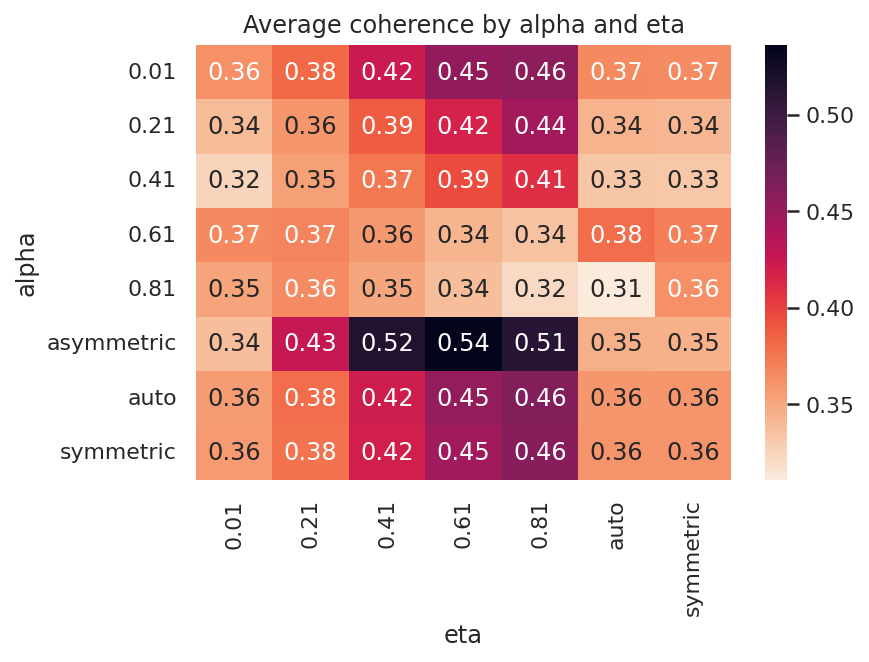

In [ ]:
coherence_table = pd.pivot_table(model_results_df_2, values='coherence', index='alpha', columns='eta', aggfunc=np.mean)

# Create a heatmap of the coherence values
sns.heatmap(coherence_table, cmap='rocket_r', annot=True)

# Add a title and axis labels
plt.title('Average coherence by alpha and eta')
plt.xlabel('eta')
plt.ylabel('alpha')

# Show the plot
plt.show()

In [ ]:
# asymmetric alpha
coherence_asymm_alpha = model_results_df_2.loc[(model_results_df_2['alpha'] == 'asymmetric') & (model_results_df_2['eta'].isin(round(a,2) for a in list(np.arange(0.01, 1, 0.2))))]

In [ ]:
# auto alpha
coherence_auto_alpha = model_results_df_2.loc[(model_results_df_2['alpha'] == 'auto') & (model_results_df_2['eta'].isin(round(a,2) for a in list(np.arange(0.01, 1, 0.2))))]

In [ ]:
def plot_eta_by_num(df):
    # Get the unique values of num_topic
    num_topics = df['num_topic'].unique()

    # Calculate the number of rows needed for the plot
    num_rows = -(-len(num_topics) // 5) # Equivalent to ceil(len(num_topics) / 5)

    # Set up the subplot grid with 'num_rows' rows and five columns
    fig, axes = plt.subplots(nrows=num_rows, ncols=5, figsize=(18, 3*num_rows))

    # Flatten the axes array to iterate over it in a 1D loop
    axes = axes.flatten()

    # Iterate through each unique value of num_topic and create a line plot for each
    for i, num_topic in enumerate(num_topics):
        # Get the subset of the dataframe for the current num_topic value
        subset = df[df['num_topic'] == num_topic]
        
        # Map the line plot to show alpha on the x-axis, eta on the hue, and coherence on the y-axis
        sns.lineplot(data=subset, x="eta", y="coherence", ax=axes[i], linewidth=2, marker='o')
        
        # Set the title for the subplot
        axes[i].set_title("Num Topic: {}".format(num_topic))
        
        # Set the axis labels for the subplot
        axes[i].set_xlabel("Eta")
        axes[i].set_ylabel("Coherence")
        
        # Add a legend to the subplot
        # if i == 0:
        #     axes[i].legend(loc='upper left')
        # else:
        #     axes[i].legend().remove()
            
        # Hide the x-axis labels for all but the bottom row of subplots
        # if i < (num_rows - 1) * 5:
        #     axes[i].set_xticklabels([])
            
    # Set the title for the entire figure
    # fig.suptitle("Coherence vs. Alpha by Num Topic and Eta", fontsize=16)

    # Adjust the spacing between the subplots
    fig.tight_layout()

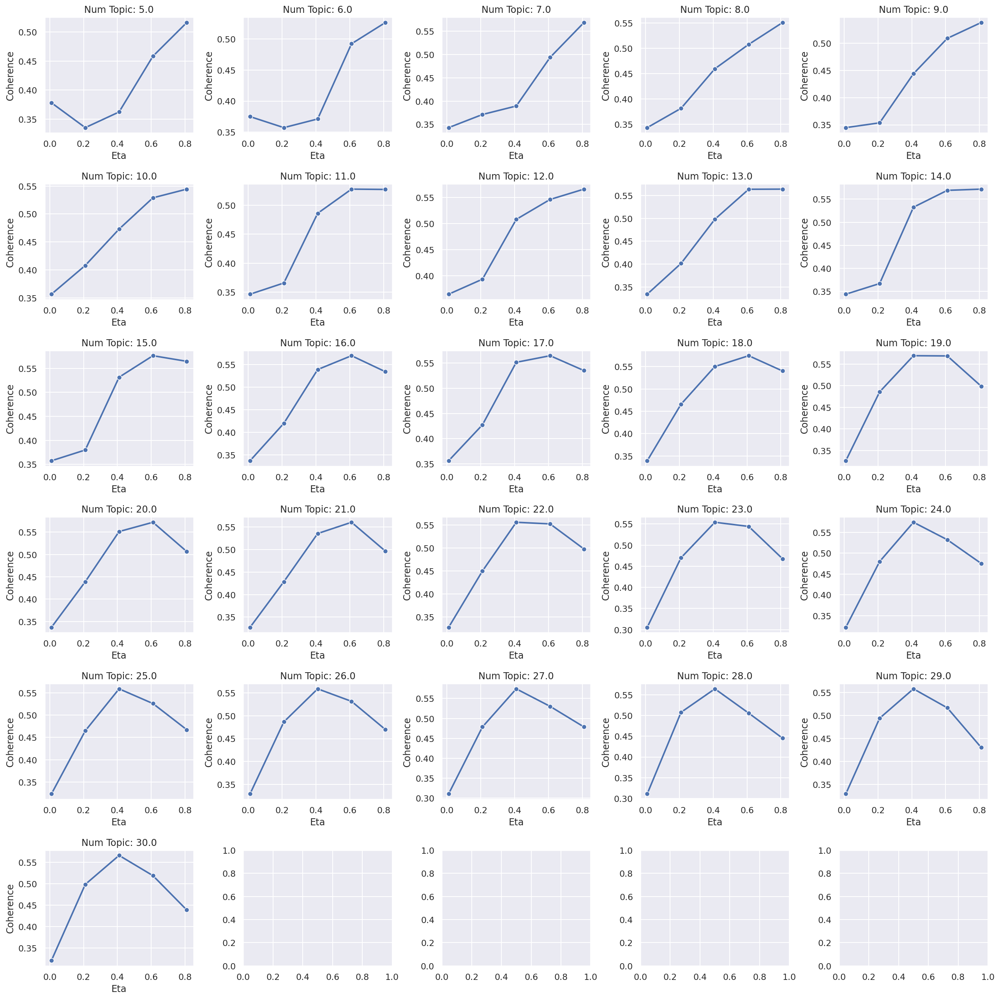

In [ ]:
plot_eta_by_num(coherence_asymm_alpha)

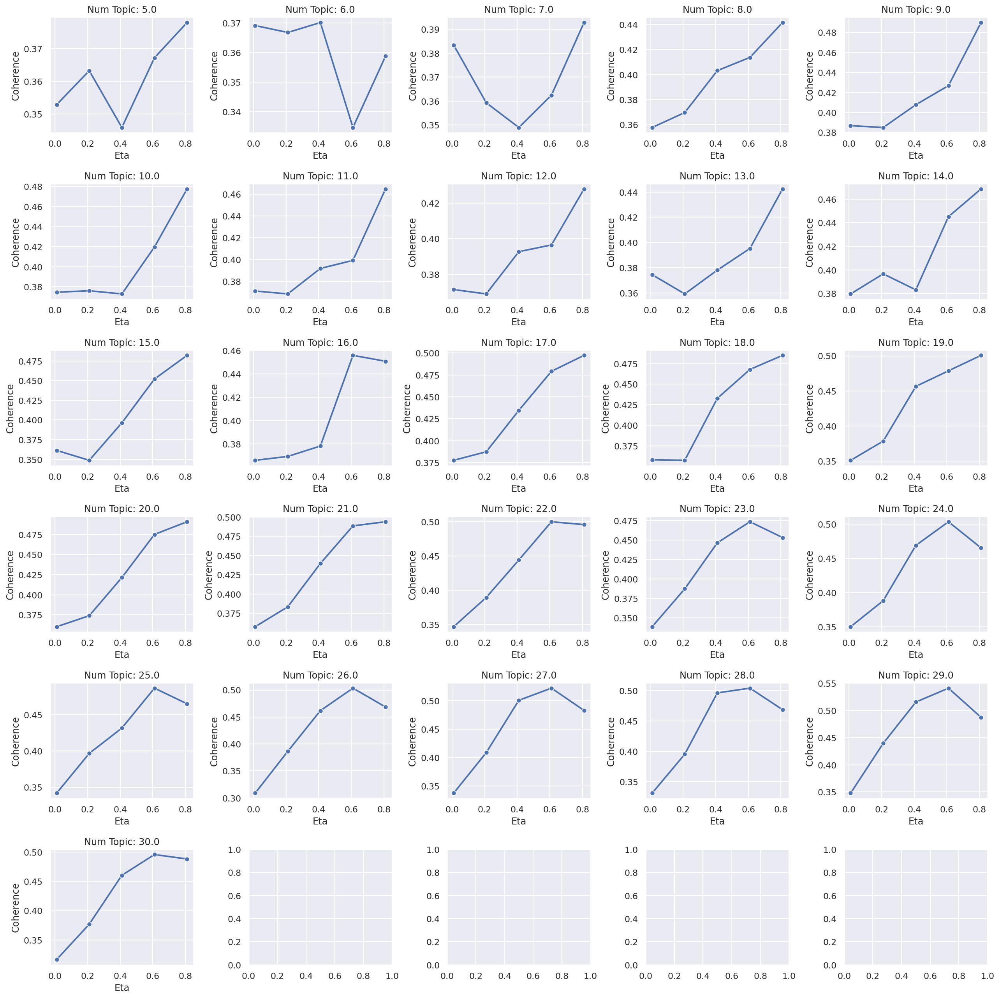

In [ ]:
plot_eta_by_num(coherence_auto_alpha)

### Tuning K

In [ ]:
def compute_coherence(alpha, eta, save_name, corpus=all_corpus_bow, dictionary=all_dict):

    coherence_by_k = []
    start_k = 5
    stop_k = 30

    for k in range(start_k, stop_k+1):

        lda_model = LdaModel(corpus = corpus,
                            id2word = dictionary,
                            num_topics = k, 
                            random_state = 123,
                            alpha = alpha, 
                            eta = eta,
                            # default parameter
                            passes = 1,
                            iterations = 50, 
                            chunksize = 2000)

        cm = CoherenceModel(model = lda_model, 
                            texts = alltweets, 
                            dictionary = all_dict, 
                            coherence = 'c_v')
        
        coherence_by_k.append((k, cm.get_coherence()))

        if k % 5 == 0:
            print('****proceeded k = {}'.format(k))

    df = pd.DataFrame(coherence_by_k, columns=['num_topic', 'coherence'])
    df.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/{}.csv'.format(save_name), index=False)

    return df

In [ ]:
def plot_coherence_by_(df, pic_name, title):
    sns.set(style='darkgrid')
    plt.figure(figsize=(16, 6))
    sns.lineplot(x='num_topic', y='coherence', data=df)
    plt.xlim(5, 30)
    plt.xticks(df['num_topic'])
    plt.title("Coherence by Number of Topic ({})".format(title))
    plt.xlabel("Number of Topics")
    plt.ylabel("Coherence")
    plt.savefig('/content/drive/MyDrive/SeniorProject/SNpj_res/Pic/coherence_by_k_{}.jpg'.format(pic_name))
    plt.show()

#### alpha = asymmetric, eta = .6

In [ ]:
alpha_asymmetric_eta_6 = compute_coherence(alpha = 'asymmetric',
                                     eta = 0.6,
                                     save_name = 'alpha_asymmetric_eta_6')

****proceeded k = 5
****proceeded k = 10
****proceeded k = 15
****proceeded k = 20
****proceeded k = 25
****proceeded k = 30


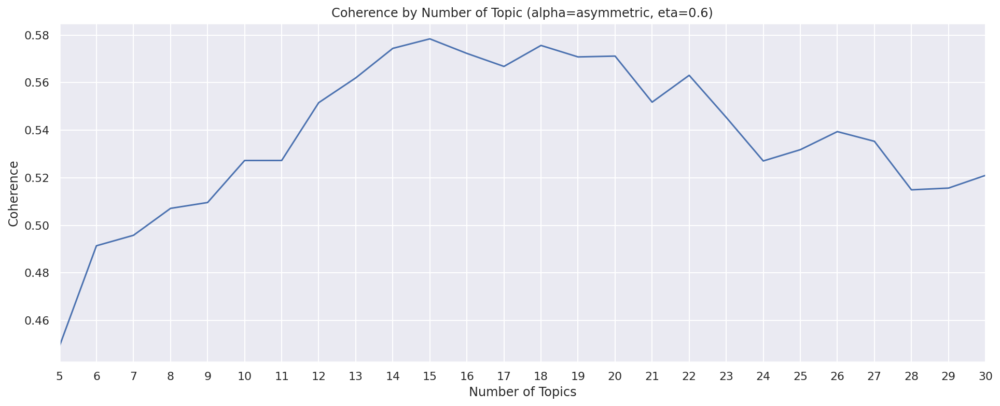

In [ ]:
plot_coherence_by_(df = alpha_asymmetric_eta_6, 
                   pic_name = 'alpha_asymmetric_eta_6',
                   title = "alpha=asymmetric, eta=0.6")

#### alpha = asymmetric, eta = .4

In [ ]:
alpha_asymmetric_eta_4 = compute_coherence(alpha = 'asymmetric',
                                           eta = 0.4,
                                           save_name = 'alpha_asymmetric_eta_4')

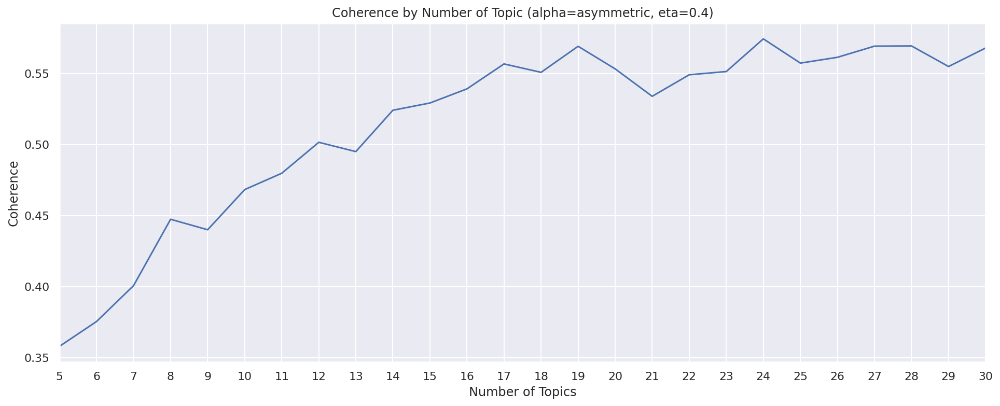

In [ ]:
plot_coherence_by_(df = alpha_asymmetric_eta_4, 
                   pic_name = 'alpha_asymmetric_eta_4',
                   title = "alpha=asymmetric, eta=0.4")

#### alpha = asymmetric, eta = .8

In [ ]:
alpha_asymmetric_eta_8 = compute_coherence(alpha = 'asymmetric',
                                           eta = 0.8,
                                           save_name = 'alpha_asymmetric_eta_8')

****proceeded k = 5


KeyboardInterrupt: ignored

In [ ]:
plot_coherence_by_(df = alpha_asymmetric_eta_8, 
                   pic_name = 'alpha_asymmetric_eta_8',
                   title = "alpha=asymmetric, eta=0.8")

#### alpha = auto, eta = .6

In [ ]:
alpha_auto_eta_6 = compute_coherence(alpha = 'auto',
                                     eta = 0.6,
                                     save_name = 'alpha_auto_eta_6')

****proceeded k = 5
****proceeded k = 10
****proceeded k = 15
****proceeded k = 20
****proceeded k = 25
****proceeded k = 30


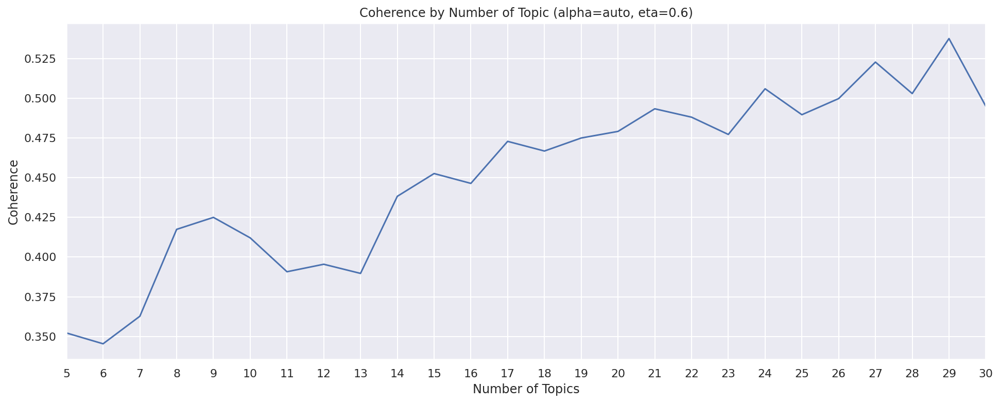

In [ ]:
plot_coherence_by_(df = alpha_auto_eta_6, 
                   pic_name = 'alpha_auto_eta_6',
                   title = "alpha=auto, eta=0.6")

In [ ]:
lda_model = LdaModel(all_corpus_bow, 
                     num_topics = 33, 
                     id2word = all_dict, 
                     passes = 1,
                     iterations = 50, 
                     chunksize = 2000, 
                     alpha = 'asymmetric', 
                     eta = 0.6, 
                     random_state = 123)

In [ ]:
for i in range(lda_model.num_topics):
    print (str(i+1) + ': ' + ' '.join([w[0] for w in lda_model.show_topic(i)]))

1: ส่ง ร้าน ลด ค่า กิน รับ ส่วน อาหาร กด ข้าว
2: ใช้ เงิน โทร กด จ่าย โค้ด คืน ตัด แอป สติกเกอร์
3: ตก ฝน ล่ม ข้าว ต่ำ หิว รับ รอ กิน นาน
4: เน็ต ค่า แวะ ประทับใจ ซอส ตรงข้าม เดินทาง ขอร้อง เผลอ พริก
5: ดัน โรง ล้าง ฉีด เครป gugu ศูนย์ ฮัลโหล ช้อน chicken
6: หวาน เลอ มารยาท ตีน ตั้งใจ แยก ส้น เลี้ยว โชค เจ้าหน้าที่
7: กล้า the ศุกร์ หาไรเดอร์ ล็อก โอ้โห แจ สะดุ้ง อาราย ไซส์
8: ไทย บริษัท จำกัด เผ็ด ไว เหรียญ ไอเหี้ย อวย กลิ่น ฟัน
9: ขั้น kfc รายการ ไอติม จา ย้ำ เด้ง ลาย ล้ม ภาษี
10: ออเดอร์ เจ้า หิว แปป อยากู้ นิ่ง อืม อุบัติเหตุ your small
11: วุ่นวาย รหัส แลง กรอบ สเปรย์ วุ้น คัย จ้าว กดเร๋อ สื่อ
12: เส้น ทน อม เต้น รัย วดฟ ซิ ตะกร้า อิน เทค
13: ซ้อน โล แคมเปญ แปะ โล่ง อีร้าน งอแง เกา ยาย เอ่ย
14: ห่วย สิทธิ์ จอ กิจกรรม หุ้น เฮงซวย อันดับ ลัด เจ้าหน้า แอค
15: ไหว้ ไม จ้าง เดอร์ ปก ทอง ค้น เท้า โท ละเอียด
16: อีเวร พส อุ เหมาะสม คิดเมนู เรื่องราว exceed ตาปิ๊ง ยาline เยอะมั้ย
17: รส เกลียด สี เขียว เฟส ais ย่าน บีบ รัว ครีม
18: ไรเดอร์ โซน เปรี้ยว พระเจ้า ประท้วง เห โรบินฮุ้ด ระยอง ระ

In [ ]:
vis = gensimvis.prepare(lda_model, all_corpus_bow, all_dict)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.405908  0.067905  1       1        56.417105
1     -0.271941 -0.134030  2       1        16.891234
2     -0.059509  0.124067  3       1        6.034041 
5      0.024386 -0.001273  4       1        1.957669 
3      0.014997  0.003767  5       1        1.923189 
9      0.031218 -0.004137  6       1        1.710389 
7      0.024266 -0.002622  7       1        1.697029 
4      0.027000 -0.002470  8       1        1.280863 
8      0.028806 -0.002153  9       1        1.054220 
16     0.025954 -0.002121  10      1        0.852702 
6      0.024733 -0.001429  11      1        0.781487 
14     0.025391 -0.001573  12      1        0.775393 
13     0.026198 -0.003171  13      1        0.659915 
11     0.024986 -0.001611  14      1        0.648723 
12     0.025389 -0.002691  15      1        0.583321 
22     0.025291 -0.001986  16      1        0.574387 
27     0.024692 -0.001809  17      1        0.559835 
24     0.025287 -0.002629  18      1        0.508100 
26     0.024990 -0.002690  19      1        0.484566 
17     0.026350 -0.002549  20      1        0.459117 
20     0.023904 -0.001713  21      1        0.427510 
10     0.023107 -0.001652  22      1        0.427216 
18     0.024329 -0.003822  23      1        0.383006 
23     0.024095 -0.001998  24      1        0.372057 
19     0.024117 -0.001768  25      1        0.368430 
25     0.023923 -0.001776  26      1        0.360986 
15     0.023276 -0.001653  27      1        0.299122 
21     0.023862 -0.001941  28      1        0.297794 
28     0.023441 -0.001851  29      1        0.297314 
32     0.023301 -0.001307  30      1        0.293227 
30     0.023695 -0.001783  31      1        0.250625 
29     0.023124 -0.001729  32      1        0.187063 
31     0.023249 -0.001802  33      1        0.182368 , topic_info=                         Term         Freq        Total Category  logprob  \
6      ใช้                     3774.000000  3774.000000  Default  30.0000   
100    ข้าว                    3017.000000  3017.000000  Default  29.0000   
207    เงิน                    2238.000000  2238.000000  Default  28.0000   
353    ค่า                     4264.000000  4264.000000  Default  27.0000   
1024   ออเดอร์                 524.000000   524.000000   Default  26.0000   
67     กิน                     4049.000000  4049.000000  Default  25.0000   
408    รอ                      2166.000000  2166.000000  Default  24.0000   
240    รับ                     3487.000000  3487.000000  Default  23.0000   
4      โทร                     2674.000000  2674.000000  Default  22.0000   
84     กด                      3385.000000  3385.000000  Default  21.0000   
1782   นาน                     1147.000000  1147.000000  Default  20.0000   
64     ตก                      544.000000   544.000000   Default  19.0000   
65     ฝน                      524.000000   524.000000   Default  18.0000   
295    โค้ด                    2830.000000  2830.000000  Default  17.0000   
20040  ล่ม                     555.000000   555.000000   Default  16.0000   
20034  หิว                     1169.000000  1169.000000  Default  15.0000   
579    จ่าย                    1121.000000  1121.000000  Default  14.0000   
475    คืน                     1227.000000  1227.000000  Default  13.0000   
777    ต่ำ                     450.000000   450.000000   Default  12.0000   
127    ส่ง                     6767.000000  6767.000000  Default  11.0000   
33     ร้าน                    4818.000000  4818.000000  Default  10.0000   
570    ตัด                     645.000000   645.000000   Default  9.0000    
140    ลด                      4943.000000  4943.000000  Default  8.0000    
57     แอป                     1003.000000  1003.000000  Default  7.0000    
306    สติกเกอร์               516.000000   516.000000   Default  6.0000    
472    ไหว้                    231.000000   231.000000   Default 

### Tuning **Passes**, **Iterations**, and **Chunksize**


In [ ]:
import logging
import re
import os

from gensim.models.callbacks import CoherenceMetric

In [ ]:
logging.basicConfig(filename='model_callbacks.log',
                    format="%(asctime)s:%(levelname)s:%(message)s",
                    level=logging.NOTSET)

In [ ]:
coherence_cv_logger = CoherenceMetric(corpus = train_corpus_bow, 
                                      logger = 'shell', 
                                      coherence = 'c_v', 
                                      texts = train_tweets)

In [ ]:
# List of the different iterations to try
iterations = [1, 50, 100, 150]

# The number of passes to use - could change depending on requirements
passes = 80 

for iteration in iterations:
   
    # Add text to logger to indicate new model
    logging.debug(f'Start of model: {iteration} iterations')

    # Create model - note callbacks argument uses list of created callback loggers
    lda_model = LdaModel(corpus = train_corpus_bow, 
                         num_topics = 10, 
                         id2word = train_dict, 
                         passes = passes,
                         iterations = iteration, 
                         random_state = 123,
                         callbacks = [coherence_cv_logger])

    # Add text to logger to indicate end of this model
    logging.debug(f'End of model: {iteration} iterations')

    # Save models so they aren't lost
    if not os.path.exists(f"/content/drive/MyDrive/SeniorProject/SNpj_res/model_tuning/lda_{iteration}i80p/"):
        os.makedirs(f"/content/drive/MyDrive/SeniorProject/SNpj_res/model_tuning/lda_{iteration}i80p/")

    lda_model.save(f"/content/drive/MyDrive/SeniorProject/SNpj_res/model_tuning/lda_{iteration}i80p/lda_{iteration}i80p.model")

In [ ]:
iterations = [50, 100, 150]

all_metrics = pd.DataFrame()

for iteration in iterations:
    model = LdaModel.load(f"lda_{iteration}i80p/lda_{iteration}i80p.model")
    df = pd.DataFrame.from_dict(model.metrics)

    # df['docs_converged'] = find_doc_convergence(5, iteration)
    df['iterations'] = iteration
    df['topics'] = 10

    df = df.reset_index().rename(columns={'index': 'pass_num'})

    all_metrics = pd.concat([all_metrics, df])

In [ ]:
all_metrics.drop(all_metrics.index[-1], inplace=True)

In [ ]:
all_metrics.pass_num = all_metrics.pass_num + 1

In [ ]:
all_metrics

,pass_num,Coherence,iterations,topics
0,1,0.490180,50,10
1,2,0.527611,50,10
2,3,0.522660,50,10
3,4,0.524787,50,10
4,5,0.525028,50,10
5,6,0.527327,50,10
6,7,0.523048,50,10
7,8,0.523048,50,10
8,9,0.523048,50,10
9,10,0.523048,50,10


In [ ]:
all_metrics = all_metrics.reset_index(drop=True)

In [ ]:
all_metrics

,pass_num,Coherence,iterations,topics
0,1,0.490180,50,10
1,2,0.527611,50,10
2,3,0.522660,50,10
3,4,0.524787,50,10
4,5,0.525028,50,10
5,6,0.527327,50,10
6,7,0.523048,50,10
7,8,0.523048,50,10
8,9,0.523048,50,10
9,10,0.523048,50,10


In [ ]:
all_metrics.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/passes_tuning.csv', index=False)

In [ ]:
all_metrics

,pass_num,Coherence,iterations,topics
0,1,0.490180,50,10
1,2,0.527611,50,10
2,3,0.522660,50,10
3,4,0.524787,50,10
4,5,0.525028,50,10
5,6,0.527327,50,10
6,7,0.523048,50,10
7,8,0.523048,50,10
8,9,0.523048,50,10
9,10,0.523048,50,10


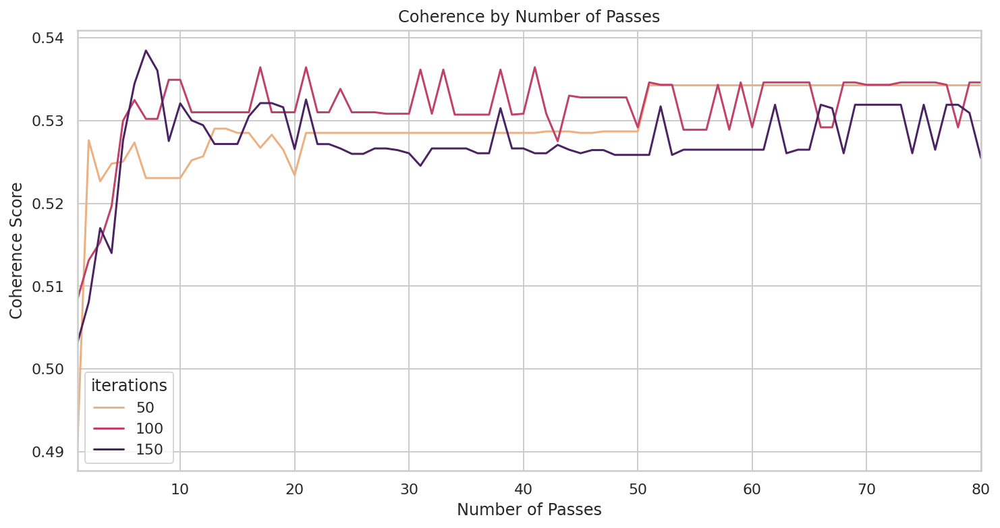

In [ ]:
sns.set(style='whitegrid')
plt.figure(figsize=(12, 6))
sns.lineplot(x="pass_num", y="Coherence", hue="iterations", palette='flare', data=all_metrics)
plt.xlim(1, 80)
# plt.xticks(all_metrics['pass_num'])
plt.title("Coherence by Number of Passes")
plt.xlabel("Number of Passes")
plt.ylabel("Coherence Score")
plt.savefig('/content/drive/MyDrive/SeniorProject/SNpj_res/Pic/coherence_by_num_passes.jpg')
plt.show()

In [ ]:
# List of the different iterations to try
chunksize_grid = [500, 1000, 1500, 2000, 2500]

# The number of passes to use - could change depending on requirements
passes = 80 

for chunksize in chunksize_grid:
   
    # Add text to logger to indicate new model
    logging.debug(f'Start of model: {chunksize} chunksize')

    # Create model - note callbacks argument uses list of created callback loggers
    lda_model = LdaModel(corpus = train_corpus_bow, 
                         num_topics = 10, 
                         id2word = train_dict, 
                         chunksize = chunksize,
                         iterations = 50, 
                         passes = 80,
                         random_state = 123,
                         callbacks = [coherence_cv_logger])

    # Add text to logger to indicate end of this model
    logging.debug(f'End of model: {chunksize} chunksize')

    # Save models so they aren't lost
    if not os.path.exists(f"lda_{chunksize}cs80p/"):
        os.makedirs(f"lda_{chunksize}cs80p/")

    lda_model.save(f"lda_{chunksize}cs80p/lda_{chunksize}cs80p.model")

In [ ]:
chunksize_grid = [500, 1000, 1500, 2000, 2500]

all_metrics = pd.DataFrame()

for chunksize in chunksize_grid:
    model = LdaModel.load(f"lda_{chunksize}cs80p/lda_{chunksize}cs80p.model")
    df = pd.DataFrame.from_dict(model.metrics)

    # df['docs_converged'] = find_doc_convergence(5, iteration)
    df['chunksize'] = chunksize
    df['topics'] = 10

    df = df.reset_index().rename(columns={'index': 'pass_num'})

    all_metrics = pd.concat([all_metrics, df])

/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information
  warnings.warn(message, category=DeprecationWarning)
/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information
  warnings.warn(message, category=DeprecationWarning)
/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information
  warnings.warn(message, category=DeprecationWarning)
/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is

In [ ]:
all_metrics.pass_num = all_metrics.pass_num + 1

In [ ]:
all_metrics

,pass_num,Coherence,chunksize,topics
0,1,0.505257,500,10
1,2,0.499491,500,10
2,3,0.501322,500,10
3,4,0.503785,500,10
4,5,0.500232,500,10
5,6,0.504404,500,10
6,7,0.501482,500,10
7,8,0.502388,500,10
8,9,0.501057,500,10
9,10,0.501057,500,10


In [ ]:
all_metrics = all_metrics.reset_index(drop=True)

In [ ]:
all_metrics.to_csv('/content/drive/MyDrive/SeniorProject/SNpj_res/passes_chunksize_tuning.csv', index=False)

In [ ]:
all_metrics

,pass_num,Coherence,chunksize,topics
0,1,0.505257,500,10
1,2,0.499491,500,10
2,3,0.501322,500,10
3,4,0.503785,500,10
4,5,0.500232,500,10
5,6,0.504404,500,10
6,7,0.501482,500,10
7,8,0.502388,500,10
8,9,0.501057,500,10
9,10,0.501057,500,10


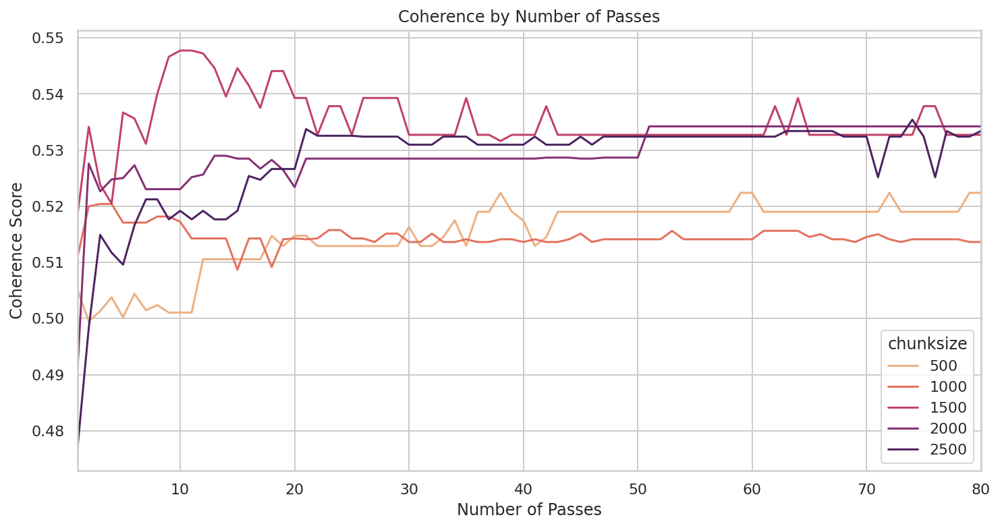

In [ ]:
sns.set(style='whitegrid')
plt.figure(figsize=(12, 6))
sns.lineplot(x="pass_num", y="Coherence", hue="chunksize", palette='flare', data=all_metrics)
plt.xlim(1, 80)
# plt.xticks(all_metrics['pass_num'])
plt.title("Coherence by Number of Passes")
plt.xlabel("Number of Passes")
plt.ylabel("Coherence Score")
plt.savefig('/content/drive/MyDrive/SeniorProject/SNpj_res/Pic/coherence_by_num_passes_chunksize.jpg')
plt.show()

In [ ]:
model = LdaModel.load('lda_2000cs/lda_2000cs.model')
df = pd.DataFrame.from_dict(model.metrics)

df['iterations'] = iteration
df['topics'] = 10

/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information
  warnings.warn(message, category=DeprecationWarning)
/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information
  warnings.warn(message, category=DeprecationWarning)
/usr/local/lib/python3.8/dist-packages/smart_open/smart_open_lib.py:496: DeprecationWarning: This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information
  warnings.warn(message, category=DeprecationWarning)


In [ ]:
lda_bow = LdaModel(corpus = train_corpus_bow, 
                   num_topics = 10, 
                   id2word = train_dict,
                   chunksize = 1500,
                   iterations = 50, 
                   passes = 10,
                   random_state = 123)

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.8/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.8/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

In [ ]:
for i in range(lda_bow.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow.show_topic(i)]))

0: บ้าน ส่ง ผิด หน้า เจอ หมุด ปัก ถาม โทร หา
1: บ่อย อ่าน แอป กด เสียง แชท คุย ซัก เครื่อง โทร
2: เงิน คืน ทำ ตัด จ่าย โทร เรื่อง รู้ บัตร ผ่าน
3: รถ ใช้ สติกเกอร์ ขับ ดี ส่ง ขอบคุณ ใส่ ชีวิต ลูกค้า
4: ใช้ ลด โค้ด ส่วน เยอะ คุ้ม กด หมด ซื้อ โปร
5: หิว ข้าว ล่ม ฝน ตก รับ หยุด กด สงสาร ชั้น
6: กิน ข้าว ดี เช้า กด นอน รู้ ทอด สาม ดู
7: รับ ออเดอร์ กด รอ ร้าน ยกเลิก รอบ นาน ขับ นาที
8: ส่ง ค่า ขึ้น แพง ฟรี เพิ่ม อาหาร ถูก ราคา กาแฟ
9: ร้าน อร่อย กิน ขาย น้ำ อาหาร ข้าว ราคา ทำ หน้า


In [ ]:
vis = gensimvis.prepare(lda_bow, train_corpus_bow, train_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.159753 -0.033446  1       1        14.966477
9      0.044762  0.107175  2       1        11.657209
0      0.038654 -0.166170  3       1        10.682666
2     -0.004178 -0.213951  4       1        10.646495
4      0.155386  0.134930  5       1        9.960480 
3      0.109988 -0.043553  6       1        9.432188 
8      0.238744  0.115415  7       1        9.126625 
6     -0.149054  0.036896  8       1        8.277543 
5     -0.244858  0.190458  9       1        8.176026 
1     -0.029690 -0.127753  10      1        7.074290 , topic_info=               Term         Freq        Total Category  logprob  loglift
51    ส่ง            5323.000000  5323.000000  Default  30.0000  30.0000
21    ร้าน           5581.000000  5581.000000  Default  29.0000  29.0000
91    หิว            3133.000000  3133.000000  Default  28.0000  28.0000
368   ค่า            2995.000000  2995.000000  Default  27.0000  27.0000
144   กิน            3849.000000  3849.000000  Default  26.0000  26.0000
96    ลด             2516.000000  2516.000000  Default  25.0000  25.0000
101   ใช้            3221.000000  3221.000000  Default  24.0000  24.0000
57    รับ            3525.000000  3525.000000  Default  23.0000  23.0000
65    เงิน           2328.000000  2328.000000  Default  22.0000  22.0000
87    ข้าว           3736.000000  3736.000000  Default  21.0000  21.0000
58    ออเดอร์        2099.000000  2099.000000  Default  20.0000  20.0000
195   บ้าน           1898.000000  1898.000000  Default  19.0000  19.0000
154   โค้ด           1547.000000  1547.000000  Default  18.0000  18.0000
9     รอ             1829.000000  1829.000000  Default  17.0000  17.0000
78    ส่วน           1441.000000  1441.000000  Default  16.0000  16.0000
89    ยกเลิก         1455.000000  1455.000000  Default  15.0000  15.0000
143   ล่ม            1079.000000  1079.000000  Default  14.0000  14.0000
318   ขึ้น           1646.000000  1646.000000  Default  13.0000  13.0000
465   รถ             1008.000000  1008.000000  Default  12.0000  12.0000
62    คืน            1023.000000  1023.000000  Default  11.0000  11.0000
1     กด             3269.000000  3269.000000  Default  10.0000  10.0000
22    อร่อย          981.000000   981.000000   Default  9.0000   9.0000 
12    เยอะ           1403.000000  1403.000000  Default  8.0000   8.0000 
374   ฝน             824.000000   824.000000   Default  7.0000   7.0000 
371   ตก             803.000000   803.000000   Default  6.0000   6.0000 
239   ผิด            1015.000000  1015.000000  Default  5.0000   5.0000 
257   รอบ            1267.000000  1267.000000  Default  4.0000   4.0000 
369   แพง            910.000000   910.000000   Default  3.0000   3.0000 
117   ตัด            754.000000   754.000000   Default  2.0000   2.0000 
126   โทร            1768.000000  1768.000000  Default  1.0000   1.0000 
58    ออเดอร์        2098.886292  2099.704582  Topic1  -2.9790   1.8990 
9     รอ             1829.080867  1829.899189  Topic1  -3.1165   1.8989 
89    ยกเลิก         1455.108088  1455.926366  Topic1  -3.3453   1.8988 
88    นาที           639.750387   640.568686   Topic1  -4.1670   1.8981 
467   ติดต่อ         369.313666   370.131957   Topic1  -4.7165   1.8971 
108   ชั่วโมง        351.264914   352.083202   Topic1  -4.7666   1.8970 
399   ไรเดอร์        344.944466   345.762829   Topic1  -4.7847   1.8970 
249   โมง            309.706367   310.524717   Topic1  -4.8925   1.8967 
2137  ร้องไห้        155.908328   156.726702   Topic1  -5.5788   1.8941 
943   ออเดอร์กู      142.926314   143.744560   Topic1  -5.6658   1.8936 
2115  ต้ม            125.593915   126.412414   Topic1  -5.7951   1.8929 
327   ผัก            124.072210   124.891012   Topic1  -5.8073   1.8928 
2117  มาม่า          121.050299   121.868722   Topic1  -5.8319   1.8926 
1118  เรียน          113.695226   114.513622   Topic1  -5.8946   1.8922 
1699  โฆษณา          103

#### k = 7 on Feb 13, 2023
gives the highest coherence


In [ ]:
lda_bow_7_topics = LdaModel(bow_corpus, 
                   num_topics = 7, 
                   id2word = dictionary, 
                   passes = n_pass,
                   iterations = iter, 
                   chunksize = chunk_size, 
                   eval_every = 10,
                   random_state = 123)

In [ ]:
for i in range(lda_bow_7_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow_7_topics.show_topic(i)]))

0: ส่ง ค่า งาน สติกเกอร์ โทร คน ลูกค้า ไรเดอร์ อาหาร ทำ
1: หิว ข้าว ฝน ตก สั่ง คน ออเดอร์ หนัก รอ แม่
2: กิน สั่ง ข้าว ล่ม แพง ร้าน unlimited แอป หมด สมัคร
3: เงิน ร้าน สั่ง ค่า จ่าย คืน ราคา ใช้ ตัด เพิ่ม
4: ยกเลิก ออเดอร์ ร้าน ทำ โดน คน รถ ผิด สั่ง หมุด
5: เจอ บ้าน รัก ดี ใส่ เพื่อน น้อง รถ หา หน้า
6: ลด กด ใช้ โค้ด ส่วน สั่ง หมด รอ เยอะ คุ้ม


In [ ]:
topic_7_lda_bow = pivot_table_of_n_words(lda_bow_7_topics, 10)
topic_7_lda_bow

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7
0,ส่ง,หิว,กิน,เงิน,ยกเลิก,เจอ,ลด
1,ค่า,ข้าว,สั่ง,ร้าน,ออเดอร์,บ้าน,กด
2,งาน,ฝน,ข้าว,สั่ง,ร้าน,รัก,ใช้
3,สติกเกอร์,ตก,ล่ม,ค่า,ทำ,ดี,โค้ด
4,โทร,สั่ง,แพง,จ่าย,โดน,ใส่,ส่วน
5,คน,คน,ร้าน,คืน,คน,เพื่อน,สั่ง
6,ลูกค้า,ออเดอร์,unlimited,ราคา,รถ,น้อง,หมด
7,ไรเดอร์,หนัก,แอป,ใช้,ผิด,รถ,รอ
8,อาหาร,รอ,หมด,ตัด,สั่ง,หา,เยอะ
9,ทำ,แม่,สมัคร,เพิ่ม,หมุด,หน้า,คุ้ม


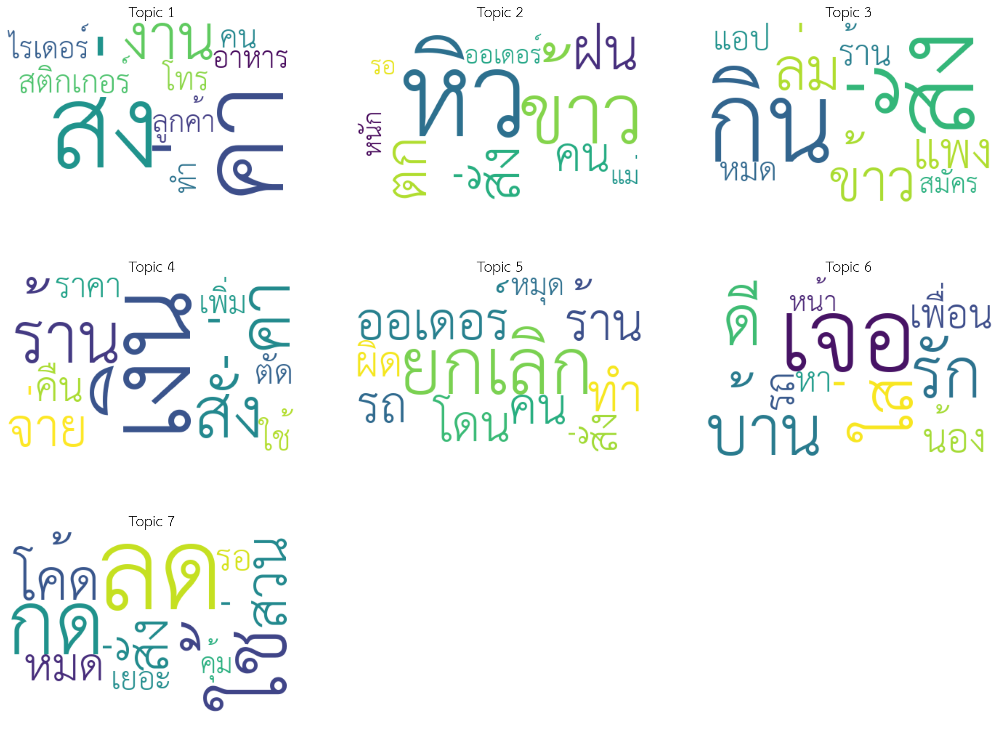

In [ ]:
generate_wordcloud(topic_7_lda_bow, '7_topic_lda_bow.png')

In [ ]:
vis = gensimvis.prepare(lda_bow_7_topics, bow_corpus, dictionary)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.158568  0.121310  1       1        18.470263
0     -0.160913  0.230095  2       1        16.321840
4     -0.093840  0.030182  3       1        15.555818
6      0.207207  0.036090  4       1        13.854147
2      0.124896 -0.137171  5       1        13.014425
1     -0.095172 -0.201963  6       1        12.844466
5     -0.140746 -0.078543  7       1        9.939039 , topic_info=             Term         Freq        Total Category  logprob  loglift
24     ส่ง         2366.000000  2366.000000  Default  30.0000  30.0000
90     ลด          1354.000000  1354.000000  Default  29.0000  29.0000
10     กิน         1345.000000  1345.000000  Default  28.0000  28.0000
163    ค่า         1700.000000  1700.000000  Default  27.0000  27.0000
15     หิว         944.000000   944.000000   Default  26.0000  26.0000
117    เงิน        1000.000000  1000.000000  Default  25.0000  25.0000
26     กด          984.000000   984.000000   Default  24.0000  24.0000
119    ใช้         1099.000000  1099.000000  Default  23.0000  23.0000
46     ข้าว        1138.000000  1138.000000  Default  22.0000  22.0000
502    โค้ด        613.000000   613.000000   Default  21.0000  21.0000
49     สั่ง        2703.000000  2703.000000  Default  20.0000  20.0000
356    ส่วน        681.000000   681.000000   Default  19.0000  19.0000
599    ฝน          503.000000   503.000000   Default  18.0000  18.0000
598    ตก          476.000000   476.000000   Default  17.0000  17.0000
55     งาน         530.000000   530.000000   Default  16.0000  16.0000
226    ยกเลิก      451.000000   451.000000   Default  15.0000  15.0000
48     สติกเกอร์   454.000000   454.000000   Default  14.0000  14.0000
61     ล่ม         371.000000   371.000000   Default  13.0000  13.0000
21     จ่าย        426.000000   426.000000   Default  12.0000  12.0000
114    เจอ         462.000000   462.000000   Default  11.0000  11.0000
25     แพง         500.000000   500.000000   Default  10.0000  10.0000
166    ร้าน        1398.000000  1398.000000  Default  9.0000   9.0000 
260    ออเดอร์     685.000000   685.000000   Default  8.0000   8.0000 
185    คืน         470.000000   470.000000   Default  7.0000   7.0000 
208    โทร         525.000000   525.000000   Default  6.0000   6.0000 
89     ราคา        371.000000   371.000000   Default  5.0000   5.0000 
160    โดน         269.000000   269.000000   Default  4.0000   4.0000 
1440   ตัด         275.000000   275.000000   Default  3.0000   3.0000 
88     รัก         180.000000   180.000000   Default  2.0000   2.0000 
39     รถ          411.000000   411.000000   Default  1.0000   1.0000 
117    เงิน        999.784768   1000.509601  Topic1  -2.8389   1.6883 
21     จ่าย        425.319028   426.044139   Topic1  -3.6936   1.6873 
1440   ตัด         275.200500   275.925053   Topic1  -4.1289   1.6864 
257    ฟรี         186.008962   186.736180   Topic1  -4.5206   1.6851 
479    เดือน       154.768874   155.493861   Topic1  -4.7045   1.6843 
94     ขาย         142.573399   143.298309   Topic1  -4.7866   1.6839 
314    ลอง         131.069735   131.795052   Topic1  -4.8707   1.6835 
319    ไก่         129.812320   130.537840   Topic1  -4.8803   1.6834 
324    หัก         118.348333   119.072746   Topic1  -4.9728   1.6829 
1290   ปัญหา       111.960578   112.688090   Topic1  -5.0283   1.6825 
730    ค้า         83.809593    84.535259    Topic1  -5.3179   1.6804 
617    สด          79.398301    80.122752    Topic1  -5.3719   1.6799 
388    สิบ         79.053347    79.779322    Topic1  -5.3763   1.6799 
804    กี่         75.067438    75.793504    Topic1  -5.4280   1.6794 
172    ยอด         74.554866    75.279616    Topic1  -5.4349   1.6793 
1647   เครดิต      74.297745    75.022098    Topic1  -5.4383   1.6793 
75     กล่อง       69.553859    70.280358    Topic1  -5.5043   1.6786 
1184   ธนาคาร      69.230293    69.954520    Topic1  -5.5090   

In [ ]:
lda_bow_11_topics = LdaModel(corpus = bow_corpus, 
                     num_topics = 9, 
                     id2word = dictionary, 
                     passes = n_pass,
                     iterations = iter,
                     chunksize = chunk_size, 
                     alpha = 'auto', 
                     eval_every = 10, 
                     random_state = 123)

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.8/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.8/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt

In [ ]:
for i in range(lda_bow_11_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow_11_topics.show_topic(i)]))

0: คน ส่ง ทำ งาน โทร บ้าน สติกเกอร์ รู้ ถาม เจอ
1: ฝน ตก รถ ค่า ปัก ขับ ติด หนัก ส่ง เช้า
2: ล่ม unlimited สมัคร ขี้ เกียจ แก้ว หงุดหงิด อีเหี้ย ออเดอร์กู เติม
3: ใช้ ไรเดอร์ เลิก ลอง บริการ บ่อย ไกล ปี ต่าง ซัก
4: เงิน คืน จ่าย ตัด ช้า โอน โดน แย่ ติดต่อ หัว
5: รัก ตาย สาม ร้องไห้ ทัก สี ยืน เจอ วิ่ง พ่อ
6: บัตร คูปอง เปล่า ปัญหา พอยต์ แทบ ด่วน ตา line น้ำ
7: หิว ยกเลิก ออเดอร์ หัก น้อง ชีวิต ผม สู้ เจ้า เลข
8: สั่ง ส่ง ค่า ลด ร้าน กิน กด ข้าว ส่วน โค้ด


In [ ]:
for idx, topic in lda_bow_11_topics.print_topics(-1):
    print('Topic: {} \nWords: {}'.format(idx, topic))

Topic: 0 
Words: 0.058*"คน" + 0.043*"ส่ง" + 0.038*"ทำ" + 0.033*"งาน" + 0.031*"โทร" + 0.028*"บ้าน" + 0.028*"สติกเกอร์" + 0.027*"รู้" + 0.022*"ถาม" + 0.022*"เจอ"
Topic: 1 
Words: 0.064*"ฝน" + 0.060*"ตก" + 0.052*"รถ" + 0.028*"ค่า" + 0.023*"ปัก" + 0.021*"ขับ" + 0.019*"ติด" + 0.018*"หนัก" + 0.016*"ส่ง" + 0.014*"เช้า"
Topic: 2 
Words: 0.075*"ล่ม" + 0.037*"unlimited" + 0.021*"สมัคร" + 0.021*"ขี้" + 0.018*"เกียจ" + 0.014*"แก้ว" + 0.013*"หงุดหงิด" + 0.013*"อีเหี้ย" + 0.012*"ออเดอร์กู" + 0.010*"เติม"
Topic: 3 
Words: 0.092*"ใช้" + 0.058*"ไรเดอร์" + 0.021*"เลิก" + 0.021*"ลอง" + 0.016*"บริการ" + 0.016*"บ่อย" + 0.016*"ไกล" + 0.014*"ปี" + 0.011*"ต่าง" + 0.009*"ซัก"
Topic: 4 
Words: 0.127*"เงิน" + 0.059*"คืน" + 0.041*"จ่าย" + 0.035*"ตัด" + 0.019*"ช้า" + 0.017*"โอน" + 0.015*"โดน" + 0.013*"แย่" + 0.012*"ติดต่อ" + 0.011*"หัว"
Topic: 5 
Words: 0.036*"รัก" + 0.018*"ตาย" + 0.018*"สาม" + 0.017*"ร้องไห้" + 0.015*"ทัก" + 0.013*"สี" + 0.012*"ยืน" + 0.011*"เจอ" + 0.009*"วิ่ง" + 0.009*"พ่อ"
Topic: 6 
Words: 0.04

In [ ]:
lda_bow_11_topics_pivot = pivot_table_of_n_words(lda_bow_11_topics, 10)
lda_bow_11_topics_pivot

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9
0,คน,ฝน,ล่ม,ใช้,เงิน,รัก,บัตร,หิว,สั่ง
1,ส่ง,ตก,unlimited,ไรเดอร์,คืน,ตาย,คูปอง,ยกเลิก,ส่ง
2,ทำ,รถ,สมัคร,เลิก,จ่าย,สาม,เปล่า,ออเดอร์,ค่า
3,งาน,ค่า,ขี้,ลอง,ตัด,ร้องไห้,ปัญหา,หัก,ลด
4,โทร,ปัก,เกียจ,บริการ,ช้า,ทัก,พอยต์,น้อง,ร้าน
5,บ้าน,ขับ,แก้ว,บ่อย,โอน,สี,แทบ,ชีวิต,กิน
6,สติกเกอร์,ติด,หงุดหงิด,ไกล,โดน,ยืน,ด่วน,ผม,กด
7,รู้,หนัก,อีเหี้ย,ปี,แย่,เจอ,ตา,สู้,ข้าว
8,ถาม,ส่ง,ออเดอร์กู,ต่าง,ติดต่อ,วิ่ง,line,เจ้า,ส่วน
9,เจอ,เช้า,เติม,ซัก,หัว,พ่อ,น้ำ,เลข,โค้ด


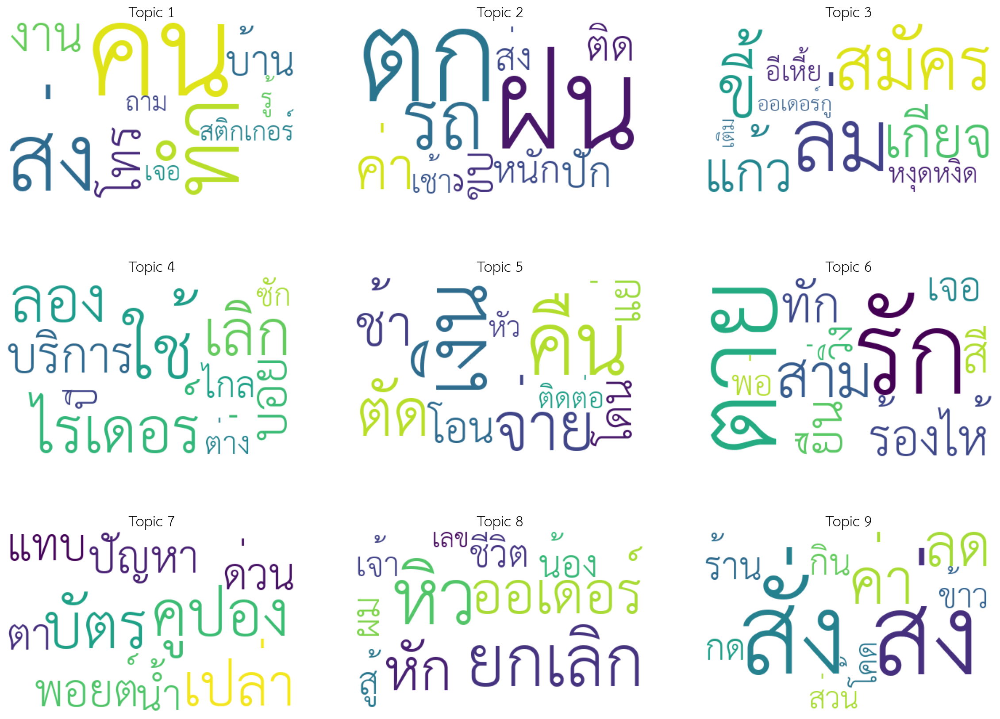

In [ ]:
generate_wordcloud(lda_bow_11_topics_pivot, '11_topic_lda_bow.png')

In [ ]:
vis = gensimvis.prepare(lda_bow_11_topics, bow_corpus, dictionary)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
8      0.343618 -0.203450  1       1        36.720002
0      0.239356  0.288724  2       1        20.115834
4     -0.041371  0.125034  3       1        8.421313 
1      0.013448 -0.105833  4       1        8.091249 
3     -0.063081 -0.077161  5       1        6.876426 
7     -0.095216 -0.032375  6       1        5.953083 
2     -0.131590 -0.014126  7       1        4.709132 
6     -0.136214 -0.008610  8       1        4.682295 
5     -0.128951  0.027798  9       1        4.430665 , topic_info=               Term         Freq        Total Category  logprob  loglift
49     สั่ง          2738.000000  2738.000000  Default  30.0000  30.0000
117    เงิน          987.000000   987.000000   Default  29.0000  29.0000
119    ใช้           1197.000000  1197.000000  Default  28.0000  28.0000
15     หิว           826.000000   826.000000   Default  27.0000  27.0000
163    ค่า           1773.000000  1773.000000  Default  26.0000  26.0000
90     ลด            1537.000000  1537.000000  Default  25.0000  25.0000
0      คน            1200.000000  1200.000000  Default  24.0000  24.0000
166    ร้าน          1417.000000  1417.000000  Default  23.0000  23.0000
10     กิน           1337.000000  1337.000000  Default  22.0000  22.0000
599    ฝน            477.000000   477.000000   Default  21.0000  21.0000
24     ส่ง           2528.000000  2528.000000  Default  20.0000  20.0000
260    ออเดอร์       641.000000   641.000000   Default  19.0000  19.0000
226    ยกเลิก        405.000000   405.000000   Default  18.0000  18.0000
185    คืน           460.000000   460.000000   Default  17.0000  17.0000
598    ตก            451.000000   451.000000   Default  16.0000  16.0000
26     กด            1103.000000  1103.000000  Default  15.0000  15.0000
46     ข้าว          1096.000000  1096.000000  Default  14.0000  14.0000
61     ล่ม           328.000000   328.000000   Default  13.0000  13.0000
63     ทำ            753.000000   753.000000   Default  12.0000  12.0000
1284   ไรเดอร์       367.000000   367.000000   Default  11.0000  11.0000
39     รถ            390.000000   390.000000   Default  10.0000  10.0000
55     งาน           606.000000   606.000000   Default  9.0000   9.0000 
208    โทร           586.000000   586.000000   Default  8.0000   8.0000 
21     จ่าย          425.000000   425.000000   Default  7.0000   7.0000 
48     สติกเกอร์     518.000000   518.000000   Default  6.0000   6.0000 
51     บ้าน          525.000000   525.000000   Default  5.0000   5.0000 
23     รู้           535.000000   535.000000   Default  4.0000   4.0000 
356    ส่วน          762.000000   762.000000   Default  3.0000   3.0000 
502    โค้ด          696.000000   696.000000   Default  2.0000   2.0000 
1440   ตัด           272.000000   272.000000   Default  1.0000   1.0000 
49     สั่ง          2737.404032  2738.115389  Topic1  -2.5188   1.0016 
90     ลด            1537.194200  1537.904779  Topic1  -3.0959   1.0014 
166    ร้าน          1417.180420  1417.890995  Topic1  -3.1771   1.0013 
10     กิน           1337.187774  1337.898360  Topic1  -3.2352   1.0013 
46     ข้าว          1095.513270  1096.227530  Topic1  -3.4346   1.0012 
26     กด            1102.839072  1103.589964  Topic1  -3.4279   1.0012 
356    ส่วน          761.738101   762.448855   Topic1  -3.7980   1.0009 
502    โค้ด          695.917914   696.628478   Topic1  -3.8883   1.0008 
132    หมด           495.770403   496.481051   Topic1  -4.2275   1.0004 
292    เยอะ          421.016681   421.727636   Topic1  -4.3909   1.0002 
16     ซื้อ          403.430578   404.141146   Topic1  -4.4336   1.0001 
89     ราคา          388.495600   389.206152   Topic1  -4.4713   1.0000 
80     อาหาร         663.752300   665.134874   Topic1  -3.9357   0.9998 
170    ปกติ          232.170647   232.904455   Topic1  -4.9861   0.9987 
229    นาที          214.278844   214.994320   Topic1  -5.0663   0.9985 
257  

# LDA (Tf-Idf)
<div>
<img src="https://miro.medium.com/max/1200/1*V9ac4hLVyms79jl65Ym_Bw.jpeg" width="700"/>
</div>

In [ ]:
tfidf = TfidfModel(all_corpus_bow)
corpus_tfidf = tfidf[all_corpus_bow]

In [ ]:
print(alltweets[5])
print(all_corpus_bow[5])
print(corpus_tfidf[5])

['สอบถาม', 'ชี', 'ทำ', 'ตัว', 'ประจำ', 'หอ', 'ผ่าน', 'ผ่าน', 'แพนด้า', 'เจอ', 'ชี', 'กวาด']
[(9, 1), (16, 1), (17, 2), (18, 1), (19, 1), (20, 2), (21, 1), (22, 1), (23, 1), (24, 1)]
[(9, 0.12269519258297445), (16, 0.4385006792920508), (17, 0.5941593073192702), (18, 0.16136736588107117), (19, 0.24115394698340878), (20, 0.3299989733265181), (21, 0.29562794264538583), (22, 0.23305506272918802), (23, 0.1472364519340917), (24, 0.28836551575232494)]


In [ ]:
lda_tfidf = LdaModel(corpus = corpus_tfidf, 
                     num_topics = 10, 
                     id2word = all_dict, 
                     random_state = 123)

In [ ]:
for i in range(lda_tfidf.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf.show_topic(i)]))

1: ส่ง ร้าน เซ็ง ส่วน รอ โทร กิน อาหาร ลด นาที
2: ส่ง ค่า ลด ออเดอร์ รับ ขึ้น ใช้ ส่วน กด อาหาร
3: ล่ม ข้าว ฝน ตก หิว กิน ไรเดอร์ รับ เลิก กด
4: เงิน ต่ำ ขั้น ตัด คืน บัตร จ่าย ลด โค้ด รับออเดอร์
5: ตอบ สติกเกอร์ ช้า ลด ไก่ ข้อความ ส่ง แจ้ง ร้าน กิน
6: หาย คุ้ม ลด หมด เร็ว เงิน โค้ด ส่วน ใช้ ขับ
7: โค้ด ลด ใช้ ไหว้ ส่วน แจก ออเดอร์กู โปร ดี มารยาท
8: โทร ร้าน กิน กด ส่ง ค่า หา เงิน ใช้ ลด
9: ปัญหา ปัง หัว ปวด ตัง ลด บ้า กิน รอ ตี
10: ยกเลิก unlimited หนัก คูปอง สมัคร เบอร์ ลด เบื่อ ใช้ ซ้อน


In [ ]:
vis = gensimvis.prepare(lda_tfidf, corpus_tfidf, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.164633  0.004157  1       1        16.813892
0     -0.059029 -0.005140  2       1        10.932389
7     -0.076144  0.000889  3       1        10.529048
5     -0.030029  0.022256  4       1        10.089596
2      0.001433 -0.194545  5       1        9.457071 
3     -0.005808  0.112922  6       1        9.439692 
4      0.024725  0.043244  7       1        9.207981 
9      0.078337  0.067613  8       1        8.260767 
8      0.077336 -0.046952  9       1        7.971678 
6      0.153811 -0.004442  10      1        7.297887 , topic_info=              Term        Freq       Total Category  logprob  loglift
3977   ยกเลิก       277.000000  277.000000  Default  30.0000  30.0000
65     ฝน           245.000000  245.000000  Default  29.0000  29.0000
64     ตก           243.000000  243.000000  Default  28.0000  28.0000
20040  ล่ม          340.000000  340.000000  Default  27.0000  27.0000
1024   ออเดอร์      320.000000  320.000000  Default  26.0000  26.0000
2644   ขั้น         163.000000  163.000000  Default  25.0000  25.0000
777    ต่ำ          171.000000  171.000000  Default  24.0000  24.0000
1069   คุ้ม         185.000000  185.000000  Default  23.0000  23.0000
996    ไรเดอร์      136.000000  136.000000  Default  22.0000  22.0000
570    ตัด          195.000000  195.000000  Default  21.0000  21.0000
295    โค้ด         669.000000  669.000000  Default  20.0000  20.0000
207    เงิน         457.000000  457.000000  Default  19.0000  19.0000
100    ข้าว         602.000000  602.000000  Default  18.0000  18.0000
66     หาย          223.000000  223.000000  Default  17.0000  17.0000
976    ปัญหา        109.000000  109.000000  Default  16.0000  16.0000
251    เร็ว         161.000000  161.000000  Default  15.0000  15.0000
14700  unlimited    121.000000  121.000000  Default  14.0000  14.0000
1353   บัตร         141.000000  141.000000  Default  13.0000  13.0000
353    ค่า          770.000000  770.000000  Default  12.0000  12.0000
472    ไหว้         83.000000   83.000000   Default  11.0000  11.0000
475    คืน          299.000000  299.000000  Default  10.0000  10.0000
306    สติกเกอร์    278.000000  278.000000  Default  9.0000   9.0000 
223    หมุด         130.000000  130.000000  Default  8.0000   8.0000 
1152   หนัก         98.000000   98.000000   Default  7.0000   7.0000 
1112   ตอบ          157.000000  157.000000  Default  6.0000   6.0000 
1500   ทิป          121.000000  121.000000  Default  5.0000   5.0000 
335    คูปอง        131.000000  131.000000  Default  4.0000   4.0000 
603    แจก          99.000000   99.000000   Default  3.0000   3.0000 
88     เลิก         165.000000  165.000000  Default  2.0000   2.0000 
20094  แพง          253.000000  253.000000  Default  1.0000   1.0000 
150    ชา           35.667090   36.416160   Topic1  -6.0410   1.7622 
822    ห่วย         27.753335   28.428881   Topic1  -6.2919   1.7589 
2335   อัปเดต       28.061685   28.750563   Topic1  -6.2808   1.7587 
3632   scb          26.159483   26.835065   Topic1  -6.3510   1.7575 
1400   โต๊ะ         25.594952   26.272149   Topic1  -6.3728   1.7569 
1337   เลื่อน       38.758103   39.843114   Topic1  -5.9579   1.7554 
511    ทั้งทั้ง     22.503340   23.201713   Topic1  -6.5015   1.7524 
1368   เลข          53.858606   55.532466   Topic1  -5.6288   1.7524 
358    มาม่า        23.519537   24.291340   Topic1  -6.4574   1.7507 
143    มั่ง         18.304370   19.017253   Topic1  -6.7081   1.7448 
1844   ไม           17.246057   17.930630   Topic1  -6.7676   1.7440 
1202   กสิกร        17.571310   18.310921   Topic1  -6.7489   1.7417 
410    เช็ค         38.825080   40.473825   Topic1  -5.9561   1.7414 
3062   รายละเอียด   15.817497   16.493294   Topic1  -6.8541   1.7411 
5592   เมล          13.773128   14.453416   Topic1  -6.9925   1.7348 
21415  ขับยาก       13.365897   14.041376   Topic1  -7.0225   1.7337 
1748   ลุก         

การใช้ tf-idf จะทำให้ 
1. คำที่มีความถี่ **มาก** หากเทียบกับทั้ง `corpus` จะทำให้พจน์ `idf` -> 0 กล่าวคือ `tf-idf` -> 0



## Tune N-topics (Tf-Idf)

In [ ]:
coherence_by_k = []
start_k = 5
stop_k = 60

for k in range(start_k, stop_k+1):

    lda_model = LdaModel(corpus = corpus_tfidf,
                         id2word = all_dict,
                         num_topics = k, 
                         random_state = 123,
                         # default parameter
                         alpha = 'symmetric', # 1/k
                         eta = 'symmetric', # 1/k
                         passes = 1,
                         iterations = 50, 
                         chunksize = 2000)

    cm = CoherenceModel(model = lda_model, 
                        texts = alltweets, 
                        dictionary = all_dict, 
                        coherence = 'c_v')
    
    coherence_by_k.append((k, cm.get_coherence()))

    if k % 5 == 0:
        print('****proceeded k = {}'.format(k))

****proceeded k = 5
****proceeded k = 10
****proceeded k = 15
****proceeded k = 20
****proceeded k = 25
****proceeded k = 30
****proceeded k = 35
****proceeded k = 40
****proceeded k = 45
****proceeded k = 50
****proceeded k = 55
****proceeded k = 60


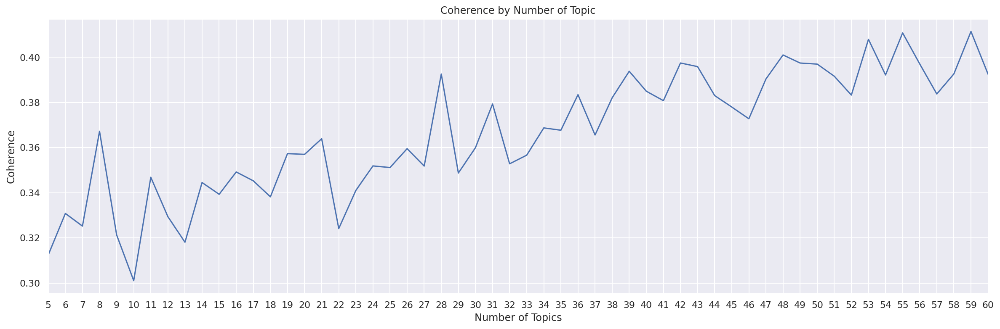

In [ ]:
sns.set(style='darkgrid')
plt.figure(figsize=(20, 6))
coherence_by_k_df = pd.DataFrame(coherence_by_k, columns=['n_topics', 'coherence'])
sns.lineplot(x='n_topics', y='coherence', data=coherence_by_k_df)
plt.xlim(5, 60)
plt.xticks(coherence_by_k_df['n_topics'])
plt.title("Coherence by Number of Topic")
plt.xlabel("Number of Topics")
plt.ylabel("Coherence")
plt.savefig('/content/drive/MyDrive/SeniorProject/SNpj_res/Pic/coherence_by_k_tfidf_default_param.jpg')
plt.show()

### 8 topics

In [ ]:
lda_tfidf_8_topics = LdaModel(corpus = corpus_tfidf, 
                            num_topics = 8, 
                            id2word = all_dict,
                            random_state = 123)

In [ ]:
for i in range(lda_tfidf_8_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_bow_8_topics.show_topic(i)]))

0: ลด โค้ด ส่วน ใช้ เยอะ คุ้ม ต่ำ ส่ง ค่า ฟรี
1: ส่ง ค่า ออเดอร์ ขึ้น รับ เงิน สติกเกอร์ ใช้ รอ ร้าน
2: ล่ม ฝน ข้าว ตก หาย หิว กิน หมด รับ เที่ยง
3: โทร ยกเลิก ขั้น ทิป ไรเดอร์ เงิน ตัด หมุด ถาม กด
4: หนัก ไก่ ช้า ร้องไห้ โหด โมง รับ กิน ห่วย แตก
5: เร็ว ออเดอร์กู ขับ จุก รับ รถ ส่ง ค้าง สู้ ย้าย
6: โปร ข้อความ ไว เลอ รัว ส่ง ชาย เริ่ด หญิง รัก
7: ไหว้ กิน รับ ส่ง หัว ทำ ปวด งาน โทร มือ


In [ ]:
vis = gensimvis.prepare(lda_tfidf_8_topics, corpus_tfidf, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.166875  0.038103  1       1        19.964354
0     -0.145956 -0.127764  2       1        17.418279
3     -0.080863  0.109686  3       1        13.337526
7     -0.004777  0.003229  4       1        11.532549
2      0.104699  0.109507  5       1        10.104158
5      0.073913  0.019518  6       1        9.642311 
4      0.070626 -0.081579  7       1        9.600887 
6      0.149233 -0.070701  8       1        8.399936 , topic_info=              Term        Freq       Total Category  logprob  loglift
140    ลด           854.000000  854.000000  Default  30.0000  30.0000
671    ส่วน         551.000000  551.000000  Default  29.0000  29.0000
295    โค้ด         614.000000  614.000000  Default  28.0000  28.0000
65     ฝน           252.000000  252.000000  Default  27.0000  27.0000
20040  ล่ม          346.000000  346.000000  Default  26.0000  26.0000
3977   ยกเลิก       262.000000  262.000000  Default  25.0000  25.0000
64     ตก           249.000000  249.000000  Default  24.0000  24.0000
1024   ออเดอร์      333.000000  333.000000  Default  23.0000  23.0000
66     หาย          251.000000  251.000000  Default  22.0000  22.0000
4      โทร          524.000000  524.000000  Default  21.0000  21.0000
2644   ขั้น         159.000000  159.000000  Default  20.0000  20.0000
100    ข้าว         606.000000  606.000000  Default  19.0000  19.0000
306    สติกเกอร์    272.000000  272.000000  Default  18.0000  18.0000
1500   ทิป          135.000000  135.000000  Default  17.0000  17.0000
1069   คุ้ม         166.000000  166.000000  Default  16.0000  16.0000
207    เงิน         430.000000  430.000000  Default  15.0000  15.0000
777    ต่ำ          150.000000  150.000000  Default  14.0000  14.0000
6      ใช้          683.000000  683.000000  Default  13.0000  13.0000
996    ไรเดอร์      120.000000  120.000000  Default  12.0000  12.0000
20034  หิว          375.000000  375.000000  Default  11.0000  11.0000
570    ตัด          185.000000  185.000000  Default  10.0000  10.0000
888    โปร          135.000000  135.000000  Default  9.0000   9.0000 
251    เร็ว         168.000000  168.000000  Default  8.0000   8.0000 
353    ค่า          774.000000  774.000000  Default  7.0000   7.0000 
472    ไหว้         87.000000   87.000000   Default  6.0000   6.0000 
14700  unlimited    111.000000  111.000000  Default  5.0000   5.0000 
254    ขึ้น         431.000000  431.000000  Default  4.0000   4.0000 
223    หมุด         143.000000  143.000000  Default  3.0000   3.0000 
1152   หนัก         103.000000  103.000000  Default  2.0000   2.0000 
3059   ข้อความ      64.000000   64.000000   Default  1.0000   1.0000 
14700  unlimited    110.708145  111.568289  Topic1  -5.0801   1.6035 
2002   ซ้อน         42.071304   42.744669   Topic1  -6.0476   1.5953 
3243   เจ้า         38.528447   39.203261   Topic1  -6.1356   1.5939 
4665   ธนาคาร       35.155526   35.829195   Topic1  -6.2272   1.5922 
1622   เอ่ย         30.526988   31.200996   Topic1  -6.3683   1.5894 
5964   pay          28.672594   29.346788   Topic1  -6.4310   1.5880 
3632   scb          27.280859   27.954531   Topic1  -6.4808   1.5868 
9711   driver       21.358063   22.032604   Topic1  -6.7255   1.5801 
1607   วิธี         20.254885   20.930166   Topic1  -6.7786   1.5784 
2191   เมือง        19.755046   20.428934   Topic1  -6.8035   1.5777 
143    มั่ง         19.111016   19.803384   Topic1  -6.8367   1.5756 
1202   กสิกร        18.377609   19.059403   Topic1  -6.8758   1.5748 
1555   กรอก         17.707886   18.382316   Topic1  -6.9129   1.5738 
333    โกง          16.314837   16.996109   Topic1  -6.9949   1.5703 
3547   คอล          15.270917   15.944469   Topic1  -7.0610   1.5681 
1594   แระ          14.893667   15.573059   Topic1  -7.0860   1.5666 
1698   แพคเกจ       14.177246   14.850802   Topic1  -7.1353   1.5648 
5592   เมล          14.365329   15.049805   Topic1  -7.12

### 11 topics

In [ ]:
lda_tfidf_11_topics = LdaModel(corpus = corpus_tfidf, 
                            num_topics = 11, 
                            id2word = all_dict,
                            random_state = 123)

In [ ]:
for i in range(lda_tfidf_11_topics.num_topics):
    print (str(i) + ': ' + ' '.join([w[0] for w in lda_tfidf_11_topics.show_topic(i)]))

0: ส่วน ลด ยกเลิก คุ้ม ใช้ หมุด ร้าน บ้าน ส่ง ถาม
1: สติกเกอร์ ขั้น ทิป ไรเดอร์ ใช้ ส่ง ตอบ วาง ลูกค้า เศร้า
2: ค่า ส่ง โค้ด ลด ขึ้น ใช้ ล่ม ข้าว แพง ต่ำ
3: ออเดอร์ รับ ตัด โทร เงิน คืน กด สาย บัตร ร้าน
4: รอ ชั่วโมง ชม ครึ่ง กิน โทร นั่ง โมง แจ้ง ร้าน
5: ฝน ตก unlimited เร็ว หนัก สมัคร รับ ข้าว รับออเดอร์ เซ็ง
6: ไว ออเดอร์กู เครดิต รับ บวก ล่มหรอ บัตร เน็ต ส่วน เกลียด
7: ส่ง กิน รอบ ช้า ลด กด ขับ อาหาร ส่วน พอยต์
8: เงิน ตัง เติม จ่าย ธนาคาร บัญชี ส่วน ใช้ คืน ปัง
9: จ่าย เงิน สด ซัก โอน kfc ห่วย ส่ง ค่า เสียใจ
10: หาย ปัญหา หมด แก้ว ชา โหด กิน ส่วน เค้ก ลด


In [ ]:
vis = gensimvis.prepare(lda_tfidf_11_topics, corpus_tfidf, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0      0.118963 -0.041545  1       1        13.189217
2      0.138480  0.025027  2       1        11.673096
7      0.110673  0.025223  3       1        11.507282
3      0.035668 -0.072027  4       1        9.764094 
4      0.047565  0.028173  5       1        8.977824 
1      0.024721 -0.081664  6       1        8.859483 
5     -0.041744  0.174117  7       1        8.080664 
10    -0.088588  0.089467  8       1        7.314450 
8     -0.114172 -0.068317  9       1        7.091862 
9     -0.120479 -0.065150  10      1        6.840933 
6     -0.111086 -0.013304  11      1        6.701096 , topic_info=              Term        Freq       Total Category  logprob  loglift
1024   ออเดอร์      365.000000  365.000000  Default  30.0000  30.0000
306    สติกเกอร์    293.000000  293.000000  Default  29.0000  29.0000
65     ฝน           235.000000  235.000000  Default  28.0000  28.0000
64     ตก           233.000000  233.000000  Default  27.0000  27.0000
3977   ยกเลิก       249.000000  249.000000  Default  26.0000  26.0000
671    ส่วน         594.000000  594.000000  Default  25.0000  25.0000
2644   ขั้น         161.000000  161.000000  Default  24.0000  24.0000
353    ค่า          788.000000  788.000000  Default  23.0000  23.0000
295    โค้ด         646.000000  646.000000  Default  22.0000  22.0000
66     หาย          236.000000  236.000000  Default  21.0000  21.0000
570    ตัด          197.000000  197.000000  Default  20.0000  20.0000
1500   ทิป          137.000000  137.000000  Default  19.0000  19.0000
14700  unlimited    130.000000  130.000000  Default  18.0000  18.0000
996    ไรเดอร์      122.000000  122.000000  Default  17.0000  17.0000
777    ต่ำ          156.000000  156.000000  Default  16.0000  16.0000
976    ปัญหา        110.000000  110.000000  Default  15.0000  15.0000
1069   คุ้ม         175.000000  175.000000  Default  14.0000  14.0000
20040  ล่ม          295.000000  295.000000  Default  13.0000  13.0000
271    ชั่วโมง      129.000000  129.000000  Default  12.0000  12.0000
240    รับ          676.000000  676.000000  Default  11.0000  11.0000
207    เงิน         471.000000  471.000000  Default  10.0000  10.0000
140    ลด           907.000000  907.000000  Default  9.0000   9.0000 
389    ครึ่ง        121.000000  121.000000  Default  8.0000   8.0000 
251    เร็ว         170.000000  170.000000  Default  7.0000   7.0000 
1152   หนัก         103.000000  103.000000  Default  6.0000   6.0000 
223    หมุด         139.000000  139.000000  Default  5.0000   5.0000 
4      โทร          531.000000  531.000000  Default  4.0000   4.0000 
486    ชม           153.000000  153.000000  Default  3.0000   3.0000 
579    จ่าย         273.000000  273.000000  Default  2.0000   2.0000 
20094  แพง          253.000000  253.000000  Default  1.0000   1.0000 
3977   ยกเลิก       248.878207  249.564410  Topic1  -3.8554   2.0230 
246    เบื่อ        68.377037   69.107815   Topic1  -5.1474   2.0151 
1483   เนอะ         19.882479   20.561021   Topic1  -6.3826   1.9922 
3062   รายละเอียด   16.983097   17.661664   Topic1  -6.5402   1.9866 
3933   เทียบ        18.458055   19.280600   Topic1  -6.4569   1.9822 
2613   ฟัน          13.613869   14.292363   Topic1  -6.7613   1.9771 
6492   พอยต์ท์      13.527309   14.206603   Topic1  -6.7677   1.9768 
2972   อยากู้       13.490749   14.169235   Topic1  -6.7704   1.9767 
896    โน้ต         13.540988   14.227229   Topic1  -6.7667   1.9763 
908    อด           36.627779   38.495777   Topic1  -5.7716   1.9760 
1039   หลง          14.905757   15.674915   Topic1  -6.6707   1.9755 
3130   จ้าง         12.733752   13.412262   Topic1  -6.8281   1.9739 
2738   support      12.213978   12.892476   Topic1  -6.8698   1.9717 
2868   ไม้          16.361699   17.278423   Topic1  -6.5775   1.9713 
2048   ยาง          12.140394   12.833694   Topic1  -6.8759   1.9702 
528    รัย          11.858251   12.

### 14 topics

In [ ]:
lda_tfidf_14_topics = LdaModel(corpus = corpus_tfidf, 
                               num_topics = 14, 
                               id2word = all_dict,
                               random_state = 123)

In [ ]:
for i in range(lda_tfidf_14_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf_14_topics.show_topic(i)]))

1: ช้า บัตร วาง ปัง เครดิต ตึก รัก ไลน์ ส่ง ตลก
2: ร้าน กิน เลือก ค่า ไก่ ใช้ เดิม ส่ง บ่าย กด
3: เงิน คืน เที่ยง ติดต่อ ครึ่ง จ่าย เบื่อ ใช้ กิน สด
4: ค่า ส่ง ขึ้น ล่ม ข้าว แพง unlimited กิน หิว สมัคร
5: สติกเกอร์ ตัด ตอบ โทร ใช้ ลูกค้า ส่ง รอบ รู้ นั่ง
6: เร็ว นาน ไหร่ จุก อีเหี้ย รอ แตก ส่ง ห่วย ตี
7: ต่ำ โปร เศร้า ข้อความ เติม ธนาคาร ลด อาทิตย์ วาน วิ่ง
8: หมุด ปัก โทร บ้าน ผิด ส่ง พอยต์ รับ เบอร์ ถาม
9: ขั้น ปัญหา ตัง ไหว โทร ใช้ หัว ส่ง อย่า โหด
10: ออเดอร์ รับ ยกเลิก รอ กด ทิป ฟรี ชั่วโมง ข้าว กิน
11: หาย คุ้ม หมด ไหว้ เจ้า อัปเดต เน็ต ย้าย โต๊ะ มากก
12: ลด โค้ด ส่วน ใช้ เยอะ ส่ง เลิก ค่า อาหาร กด
13: ฝน ตก ขับ ไรเดอร์ รับ รถ ส่ง กด ข้าว หยุด
14: คูปอง เพิ่ม ลด หัก เลอ เงิน คิว ซัก ใช้ อด


In [ ]:
vis = gensimvis.prepare(lda_tfidf_14_topics, corpus_tfidf, all_dict)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
11     0.157298 -0.095842  1       1        9.654749
7      0.059588  0.065852  2       1        8.483922
9      0.071120  0.111801  3       1        8.423757
4      0.043864  0.060569  4       1        8.060656
1      0.049837 -0.043811  5       1        8.017377
12    -0.005643  0.139653  6       1        7.978286
3      0.065120 -0.091797  7       1        7.484854
2      0.029751 -0.048753  8       1        7.032669
8     -0.022169 -0.013824  9       1        6.468779
0     -0.084391  0.044509  10      1        6.086891
13    -0.027123 -0.063836  11      1        5.884471
10    -0.125423 -0.023493  12      1        5.572928
5     -0.067470  0.049318  13      1        5.474861
6     -0.144359 -0.090347  14      1        5.375801, topic_info=              Term        Freq       Total Category  logprob  loglift
1024   ออเดอร์      369.000000  369.000000  Default  30.0000  30.0000
140    ลด           823.000000  823.000000  Default  29.0000  29.0000
3977   ยกเลิก       276.000000  276.000000  Default  28.0000  28.0000
306    สติกเกอร์    299.000000  299.000000  Default  27.0000  27.0000
295    โค้ด         589.000000  589.000000  Default  26.0000  26.0000
671    ส่วน         523.000000  523.000000  Default  25.0000  25.0000
353    ค่า          816.000000  816.000000  Default  24.0000  24.0000
65     ฝน           231.000000  231.000000  Default  23.0000  23.0000
64     ตก           230.000000  230.000000  Default  22.0000  22.0000
1069   คุ้ม         193.000000  193.000000  Default  21.0000  21.0000
66     หาย          233.000000  233.000000  Default  20.0000  20.0000
2644   ขั้น         169.000000  169.000000  Default  19.0000  19.0000
777    ต่ำ          176.000000  176.000000  Default  18.0000  18.0000
254    ขึ้น         457.000000  457.000000  Default  17.0000  17.0000
20040  ล่ม          315.000000  315.000000  Default  16.0000  16.0000
251    เร็ว         173.000000  173.000000  Default  15.0000  15.0000
240    รับ          691.000000  691.000000  Default  14.0000  14.0000
996    ไรเดอร์      128.000000  128.000000  Default  13.0000  13.0000
14700  unlimited    121.000000  121.000000  Default  12.0000  12.0000
1500   ทิป          142.000000  142.000000  Default  11.0000  11.0000
223    หมุด         148.000000  148.000000  Default  10.0000  10.0000
570    ตัด          199.000000  199.000000  Default  9.0000   9.0000 
20094  แพง          259.000000  259.000000  Default  8.0000   8.0000 
1189   ปัก          121.000000  121.000000  Default  7.0000   7.0000 
335    คูปอง        134.000000  134.000000  Default  6.0000   6.0000 
127    ส่ง          977.000000  977.000000  Default  5.0000   5.0000 
168    ฟรี          181.000000  181.000000  Default  4.0000   4.0000 
472    ไหว้         86.000000   86.000000   Default  3.0000   3.0000 
6      ใช้          689.000000  689.000000  Default  2.0000   2.0000 
888    โปร          126.000000  126.000000  Default  1.0000   1.0000 
531    เซ็ง         58.202849   59.152140   Topic1  -4.9965   2.3215 
1394   ค้าง         32.710112   33.423458   Topic1  -5.5728   2.3161 
748    เกลียด       24.034791   24.728975   Topic1  -5.8810   2.3092 
23681  มีโค้ด       17.566929   18.268478   Topic1  -6.1944   2.2986 
8299   call         17.058589   17.756553   Topic1  -6.2238   2.2976 
10768  center       16.389198   17.084377   Topic1  -6.2638   2.2962 
2933   อเมซอน       16.446751   17.191515   Topic1  -6.2603   2.2934 
637    ช้อป         14.968921   15.663110   Topic1  -6.3545   2.2924 
7930   ปรับปรุง     13.574222   14.268648   Topic1  -6.4523   2.2878 
3547   คอล          13.469489   14.163672   Topic1  -6.4600   2.2875 
12     ออฟฟิศ       13.529076   14.237269   Topic1  -6.4556   2.2867 
7447   คอม          12.041321   12.736856   Topic1  -6.5721   2.2816 
392    รายงาน       12.224641   12.931129   Topic1  -6.5570   2.2815 
2613   ฟัน          11.667543

### 16 topics

In [ ]:
lda_tfidf_16_topics = LdaModel(corpus = corpus_tfidf, 
                             num_topics = 16, 
                             id2word = all_dict,
                             random_state = 123)

In [ ]:
for i in range(lda_tfidf_16_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf_16_topics.show_topic(i)]))

1: คูปอง ลด พอยต์ ใช้ ขอบคุณ เติม line ไลน์ ซื้อ โค้ด
2: สติกเกอร์ ใช้ ตอบ ส่ง ลูกค้า ระบบ บริการ แชท อาหาร ชอบ
3: ชม ครึ่ง กิน ปัง ปวด หัว แย่ นั่ง รอ น้ำ
4: รับ ฝน ตก ข้าว หิว กด กิน ส่ง สงสาร ออเดอร์กู
5: ช้า เบื่อ ธนาคาร อด kfc เน็ต บ้า กลาย ขอร้อง กิน
6: หาย หมด เร็ว ตัด บัตร สาย รอ ชีวิต นอน ข้าว
7: ล่ม ชั่วโมง ข้าว แพง เลื่อน ล่มหรอ หิว คอนโด กิน รัว
8: รอบ หนัก ส่ง ไว กด โมโห ร้าน สาม กิน รับ
9: ขั้น เลิก จบ โทร ลด อ่าน ใช้ เช็ค เปล่า ค่า
10: ไหร่ ซ้อน โทรศัพท์ นาที บวก เอ่ย รับ โกรธ สิทธิ์ เค้ก
11: คุ้ม ต่ำ ลด ติดต่อ ส่วน ไหว้ โค้ด เบอร์ โทร ใช้
12: ออเดอร์ เงิน คืน จ่าย ไรเดอร์ ปัญหา ค่า ส่ง แอป เพิ่ม
13: ส่ง ค่า ยกเลิก โทร ขึ้น นาน รอ ทิป อาหาร ร้าน
14: ลด ส่วน ฟรี ส่ง กิน ค่า โค้ด ราคา โมง ข้อความ
15: ลด โค้ด ส่วน ใช้ หมุด เยอะ ปัก โปร เที่ยง ส่ง
16: unlimited สมัคร ลด กาแฟ โค้ด แก้ว บ่าย ค่า ส่ง ใช้


In [ ]:
vis = gensimvis.prepare(lda_tfidf_16_topics, corpus_tfidf, all_dict)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
11     0.114495 -0.093578  1       1        9.032552
12     0.070268 -0.136663  2       1        8.570041
14     0.127051  0.091173  3       1        7.030703
3     -0.082518 -0.096715  4       1        6.866389
10     0.085260  0.030995  5       1        6.658015
7      0.010090 -0.048013  6       1        6.539863
1      0.055216 -0.044722  7       1        6.326128
13     0.053237  0.031534  8       1        6.008407
8      0.018606  0.025870  9       1        5.904078
15     0.021330  0.102113  10      1        5.713081
2     -0.057484  0.023447  11      1        5.638677
0      0.019801  0.099333  12      1        5.410109
5     -0.101273 -0.073217  13      1        5.355012
9     -0.064214 -0.001956  14      1        5.267318
6     -0.170089  0.034333  15      1        4.845155
4     -0.099774  0.056067  16      1        4.834473, topic_info=              Term        Freq       Total Category  logprob  loglift
1024   ออเดอร์      351.000000  351.000000  Default  30.0000  30.0000
306    สติกเกอร์    287.000000  287.000000  Default  29.0000  29.0000
140    ลด           899.000000  899.000000  Default  28.0000  28.0000
65     ฝน           240.000000  240.000000  Default  27.0000  27.0000
3977   ยกเลิก       252.000000  252.000000  Default  26.0000  26.0000
64     ตก           238.000000  238.000000  Default  25.0000  25.0000
295    โค้ด         641.000000  641.000000  Default  24.0000  24.0000
66     หาย          229.000000  229.000000  Default  23.0000  23.0000
2644   ขั้น         169.000000  169.000000  Default  22.0000  22.0000
207    เงิน         450.000000  450.000000  Default  21.0000  21.0000
671    ส่วน         575.000000  575.000000  Default  20.0000  20.0000
1069   คุ้ม         177.000000  177.000000  Default  19.0000  19.0000
777    ต่ำ          160.000000  160.000000  Default  18.0000  18.0000
240    รับ          700.000000  700.000000  Default  17.0000  17.0000
20040  ล่ม          335.000000  335.000000  Default  16.0000  16.0000
570    ตัด          193.000000  193.000000  Default  15.0000  15.0000
14700  unlimited    123.000000  123.000000  Default  14.0000  14.0000
475    คืน          286.000000  286.000000  Default  13.0000  13.0000
335    คูปอง        131.000000  131.000000  Default  12.0000  12.0000
251    เร็ว         164.000000  164.000000  Default  11.0000  11.0000
271    ชั่วโมง      144.000000  144.000000  Default  10.0000  10.0000
996    ไรเดอร์      119.000000  119.000000  Default  9.0000   9.0000 
486    ชม           160.000000  160.000000  Default  8.0000   8.0000 
1500   ทิป          130.000000  130.000000  Default  7.0000   7.0000 
168    ฟรี          171.000000  171.000000  Default  6.0000   6.0000 
223    หมุด         135.000000  135.000000  Default  5.0000   5.0000 
1353   บัตร         142.000000  142.000000  Default  4.0000   4.0000 
88     เลิก         159.000000  159.000000  Default  3.0000   3.0000 
1189   ปัก          109.000000  109.000000  Default  2.0000   2.0000 
6      ใช้          720.000000  720.000000  Default  1.0000   1.0000 
1024   ออเดอร์      350.709648  351.401158  Topic1  -3.1339   2.4024 
996    ไรเดอร์      118.517842  119.209127  Topic1  -4.2188   2.3985 
1674   จุก          48.533817   49.225103   Topic1  -5.1116   2.3902 
976    ปัญหา        98.002184   100.005220  Topic1  -4.4088   2.3841 
988    เตือน        29.077555   29.777152   Topic1  -5.6239   2.3806 
8114   รับออเดอร์   54.807215   56.363436   Topic1  -4.9900   2.3763 
879    เชียงใหม่    23.106575   23.802371   Topic1  -5.8537   2.3747 
993    พี่ไรเดอร์   20.512997   21.204281   Topic1  -5.9728   2.3712 
1202   กสิกร        19.599670   20.294651   Topic1  -6.0183   2.3695 
534    ทอน          19.387555   20.096129   Topic1  -6.0292   2.3684 
4423   ชำระ         17.089999   17.785136   Topic1  -6.1553   2.3645 
981    แมค          15.749227   16.440512   Topic1  -6.2370   2

### 19 topics

In [ ]:
lda_tfidf_19_topics = LdaModel(corpus = corpus_tfidf, 
                             num_topics = 19, 
                             id2word = all_dict,
                             random_state = 123)

In [ ]:
for i in range(lda_tfidf_19_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf_19_topics.show_topic(i)]))

1: ลด ส่วน เยอะ ใช้ โค้ด คูปอง พอยต์ ปัง ฟรี ซื้อ
2: เงิน คืน ขั้น ทิป จ่าย โอน เลข ค่า วาง ส่ง
3: หมุด ปัก ช้า แจ้ง มากก ส่ง ธนาคาร เปล่า ผิด บ้าน
4: ไรเดอร์ unlimited สมัคร ไว ส่ง อีเหี้ย ค่า โทร คิว ขึ้น
5: ออเดอร์ รับ กด ข้าว หิว ตึก กิน เล่น หงุดหงิด อัปเดต
6: นาน รอ ขับ เร็ว นาที ครึ่ง ข้าว เที่ยง ส่ง กิน
7: โค้ด ลด ส่วน ใช้ โปร แจก มื้อ ซัก ใส่ กด
8: ฟรี เดือน ส่ง ค่า เครดิต น้ำ ตา ส่งบาท สะดวก ไหล
9: หัว ล่ม ปวด ท่วม น้ำ tt สังเกต พูดจา ถนน กิน
10: ค่า ส่ง ขึ้น แพง เพิ่ม ราคา ข้าว ถูก ล่ม หนัก
11: ปัญหา แก้ว ชา เค้ก น้ำ แม็ป นม หก กาแฟ หวาน
12: โทร ตัด ชั่วโมง ติดต่อ บัตร เลิก เงิน ครบ สาย เบอร์
13: ฝน ตก คุ้ม สงสาร ระบบ หยุด ไหม รับ ข้าว บ่อย
14: บ่าย โมง รับออเดอร์ ข้อความ เช็ค ตี เย็น สอง รัว โปรโมชั่น
15: สติกเกอร์ หาย หมด ตอบ ใช้ ลูกค้า ส่ง เบื่อ จุก เติม
16: ต่ำ แพง ลด ส่วน ต่าง ย้าย โหด เน็ต งี้ ปี
17: ไก่ ชิ้น กิน ทอด หลับ กลาง ขนม ชาติ เกลียด ท้อง
18: ยกเลิก กด รอบ ไหว้ โดน รับ ร้าน ข้าว ไหว ตาย
19: แย่ เซ็ง โมโห จบ ทัก ร้าน ชม อาหาร ส่ง กด


In [ ]:
vis = gensimvis.prepare(lda_tfidf_19_topics, corpus_tfidf, all_dict)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
11     0.114495 -0.093578  1       1        9.032552
12     0.070268 -0.136663  2       1        8.570041
14     0.127051  0.091173  3       1        7.030703
3     -0.082518 -0.096715  4       1        6.866389
10     0.085260  0.030995  5       1        6.658015
7      0.010090 -0.048013  6       1        6.539863
1      0.055216 -0.044722  7       1        6.326128
13     0.053237  0.031534  8       1        6.008407
8      0.018606  0.025870  9       1        5.904078
15     0.021330  0.102113  10      1        5.713081
2     -0.057484  0.023447  11      1        5.638677
0      0.019801  0.099333  12      1        5.410109
5     -0.101273 -0.073217  13      1        5.355012
9     -0.064214 -0.001956  14      1        5.267318
6     -0.170089  0.034333  15      1        4.845155
4     -0.099774  0.056067  16      1        4.834473, topic_info=              Term        Freq       Total Category  logprob  loglift
1024   ออเดอร์      351.000000  351.000000  Default  30.0000  30.0000
306    สติกเกอร์    287.000000  287.000000  Default  29.0000  29.0000
140    ลด           899.000000  899.000000  Default  28.0000  28.0000
65     ฝน           240.000000  240.000000  Default  27.0000  27.0000
3977   ยกเลิก       252.000000  252.000000  Default  26.0000  26.0000
64     ตก           238.000000  238.000000  Default  25.0000  25.0000
295    โค้ด         641.000000  641.000000  Default  24.0000  24.0000
66     หาย          229.000000  229.000000  Default  23.0000  23.0000
2644   ขั้น         169.000000  169.000000  Default  22.0000  22.0000
207    เงิน         450.000000  450.000000  Default  21.0000  21.0000
671    ส่วน         575.000000  575.000000  Default  20.0000  20.0000
1069   คุ้ม         177.000000  177.000000  Default  19.0000  19.0000
777    ต่ำ          160.000000  160.000000  Default  18.0000  18.0000
240    รับ          700.000000  700.000000  Default  17.0000  17.0000
20040  ล่ม          335.000000  335.000000  Default  16.0000  16.0000
570    ตัด          193.000000  193.000000  Default  15.0000  15.0000
14700  unlimited    123.000000  123.000000  Default  14.0000  14.0000
475    คืน          286.000000  286.000000  Default  13.0000  13.0000
335    คูปอง        131.000000  131.000000  Default  12.0000  12.0000
251    เร็ว         164.000000  164.000000  Default  11.0000  11.0000
271    ชั่วโมง      144.000000  144.000000  Default  10.0000  10.0000
996    ไรเดอร์      119.000000  119.000000  Default  9.0000   9.0000 
486    ชม           160.000000  160.000000  Default  8.0000   8.0000 
1500   ทิป          130.000000  130.000000  Default  7.0000   7.0000 
168    ฟรี          171.000000  171.000000  Default  6.0000   6.0000 
223    หมุด         135.000000  135.000000  Default  5.0000   5.0000 
1353   บัตร         142.000000  142.000000  Default  4.0000   4.0000 
88     เลิก         159.000000  159.000000  Default  3.0000   3.0000 
1189   ปัก          109.000000  109.000000  Default  2.0000   2.0000 
6      ใช้          720.000000  720.000000  Default  1.0000   1.0000 
1024   ออเดอร์      350.709648  351.401158  Topic1  -3.1339   2.4024 
996    ไรเดอร์      118.517842  119.209127  Topic1  -4.2188   2.3985 
1674   จุก          48.533817   49.225103   Topic1  -5.1116   2.3902 
976    ปัญหา        98.002184   100.005220  Topic1  -4.4088   2.3841 
988    เตือน        29.077555   29.777152   Topic1  -5.6239   2.3806 
8114   รับออเดอร์   54.807215   56.363436   Topic1  -4.9900   2.3763 
879    เชียงใหม่    23.106575   23.802371   Topic1  -5.8537   2.3747 
993    พี่ไรเดอร์   20.512997   21.204281   Topic1  -5.9728   2.3712 
1202   กสิกร        19.599670   20.294651   Topic1  -6.0183   2.3695 
534    ทอน          19.387555   20.096129   Topic1  -6.0292   2.3684 
4423   ชำระ         17.089999   17.785136   Topic1  -6.1553   2.3645 
981    แมค          15.749227   16.440512   Topic1  -6.2370   2

### 20 topics

In [ ]:
lda_tfidf_20_topics = LdaModel(corpus = corpus_tfidf, 
                               num_topics = 20, 
                               id2word = all_dict,
                               random_state = 123)

In [ ]:
for i in range(lda_tfidf_20_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf_20_topics.show_topic(i)]))

1: ค่า ส่ง ขึ้น คุ้ม ลด ส่วน ร้าน ขับ เดือน บ้าน
2: ขั้น ไรเดอร์ เซ็ง เลข ส่ง บริการ ใช้ ค่า ชาติ โทร
3: ฝน ตก หาย หมด สงสาร ข้าว หยุด ส่ง กิน หิว
4: รับ unlimited สมัคร กด ออเดอร์กู อีเหี้ย งาน จบ หิว โทรศัพท์
5: ซัก กล่อง ล่าง โล กลาย ถุง แกง ล้าน พัน หญิง
6: เพิ่ม ชม รอ เร็ว กิน หัก เลือก นั่ง ส่ง นาน
7: ฟรี หนัก บ่าย โมง โค้ด ลด วน ส่ง วิ่ง ปี
8: ออเดอร์ ชั่วโมง ร้าน โทร รอ กิน ขอโทษ น้ำ ส่ง น้อย
9: เลิก ข้อความ หัว ปวด อ่าน มือ รัว พูดจา ตกใจ ด่วน
10: จ่าย เงิน สด โอน ไหร่ อด ตึก kfc เกลียด โปรโมชั่น
11: ล่ม ข้าว ต่ำ ค่า แพง ส่ง กิน หิว ไหว้ เศร้า
12: เงิน คืน ตัด บัตร นาที ติดต่อ ไว รอ โทร สิบ
13: แย่ รับออเดอร์ รำคาญ รูป ห่วย แตก ถ่าย เกรงใจ ตีน เชียงใหม่
14: ช้า เที่ยง กิน มื้อ เย็น เลอ พิมพ์ รับ เค้ก เปล่า
15: ลด โค้ด ใช้ สติกเกอร์ ส่วน หมุด ปัก เยอะ ส่ง ลูกค้า
16: เบอร์ โทร โมโห มารยาท พนักงาน อยู่แล้ว เน็ต ชา ขนม เครื่อง
17: ครึ่ง ครบ ระบบ แก้ว ซ้อน ค้า ทุ่ม น้ำ รับ เครดิต
18: ยกเลิก ทิป ปัญหา โทร รอบ โดน ขับ แชท กด สาม
19: นาน วาง สาย ร้องไห้ รับ คอนโด หงุดหงิด เอ่ย โทร รัก

In [ ]:
vis = gensimvis.prepare(lda_tfidf_20_topics, corpus_tfidf, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
0     -0.119667  0.033451  1       1        6.849703
19    -0.157501  0.049497  2       1        6.608788
14    -0.170797  0.094197  3       1        6.137600
7     -0.082691 -0.042302  4       1        6.031469
11    -0.059596 -0.116473  5       1        5.926739
5     -0.013065 -0.116488  6       1        5.509779
10    -0.046841  0.064164  7       1        5.427551
17    -0.004342 -0.116620  8       1        5.260847
2      0.004917  0.041704  9       1        5.093848
16     0.013008 -0.045938  10      1        4.858562
1     -0.008857 -0.035122  11      1        4.734949
13     0.013781 -0.043414  12      1        4.566807
12     0.082928 -0.028689  13      1        4.240715
8      0.076204  0.033427  14      1        4.198353
15     0.079444 -0.062459  15      1        4.195670
3      0.101824  0.107763  16      1        4.191637
18     0.056689  0.010411  17      1        4.166454
6      0.042070  0.082330  18      1        4.153683
9      0.066913  0.042620  19      1        4.031622
4      0.125577  0.047940  20      1        3.815223, topic_info=              Term        Freq       Total Category  logprob  loglift
1024   ออเดอร์      376.000000  376.000000  Default  30.0000  30.0000
3977   ยกเลิก       277.000000  277.000000  Default  29.0000  29.0000
65     ฝน           231.000000  231.000000  Default  28.0000  28.0000
140    ลด           861.000000  861.000000  Default  27.0000  27.0000
306    สติกเกอร์    251.000000  251.000000  Default  26.0000  26.0000
240    รับ          693.000000  693.000000  Default  25.0000  25.0000
64     ตก           229.000000  229.000000  Default  24.0000  24.0000
295    โค้ด         620.000000  620.000000  Default  23.0000  23.0000
671    ส่วน         549.000000  549.000000  Default  22.0000  22.0000
66     หาย          234.000000  234.000000  Default  21.0000  21.0000
777    ต่ำ          169.000000  169.000000  Default  20.0000  20.0000
2644   ขั้น         160.000000  160.000000  Default  19.0000  19.0000
570    ตัด          190.000000  190.000000  Default  18.0000  18.0000
20040  ล่ม          318.000000  318.000000  Default  17.0000  17.0000
1782   นาน          314.000000  314.000000  Default  16.0000  16.0000
475    คืน          291.000000  291.000000  Default  15.0000  15.0000
207    เงิน         452.000000  452.000000  Default  14.0000  14.0000
353    ค่า          815.000000  815.000000  Default  13.0000  13.0000
1500   ทิป          143.000000  143.000000  Default  12.0000  12.0000
14700  unlimited    130.000000  130.000000  Default  11.0000  11.0000
1069   คุ้ม         183.000000  183.000000  Default  10.0000  10.0000
996    ไรเดอร์      121.000000  121.000000  Default  9.0000   9.0000 
168    ฟรี          180.000000  180.000000  Default  8.0000   8.0000 
6      ใช้          689.000000  689.000000  Default  7.0000   7.0000 
1228   ช้า          150.000000  150.000000  Default  6.0000   6.0000 
486    ชม           153.000000  153.000000  Default  5.0000   5.0000 
391    เพิ่ม        212.000000  212.000000  Default  4.0000   4.0000 
20094  แพง          261.000000  261.000000  Default  3.0000   3.0000 
389    ครึ่ง        120.000000  120.000000  Default  2.0000   2.0000 
271    ชั่วโมง      134.000000  134.000000  Default  1.0000   1.0000 
2267   แลก          41.346352   42.053501   Topic1  -4.9952   2.6640 
20423  ส่งบาท       31.233096   31.941663   Topic1  -5.2757   2.6585 
2754   แม็ป         30.330807   31.033111   Topic1  -5.3050   2.6581 
269    เก่า         26.177193   26.892489   Topic1  -5.4523   2.6540 
1997   ไม๊          24.895439   25.652645   Topic1  -5.5025   2.6510 
1183   แฮปปี้       23.152897   23.907093   Topic1  -5.5751   2.6489 
277    บัง          18.094803   18.800564   Topic1  -5.8216   2.6427 
1690   ลา           19.856089   20.653731   Topic1  -5.7287   2.6416 
1122   พรุ่ง        19.357167   20.166499   Topic1  -5.7541  

### 21 topics

In [ ]:
lda_tfidf_21_topics = LdaModel(corpus = corpus_tfidf, 
                               num_topics = 21, 
                               id2word = all_dict,
                               random_state = 123)

In [ ]:
for i in range(lda_tfidf_21_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf_21_topics.show_topic(i)]))

1: ออเดอร์ รับ รอ นาที ชั่วโมง กด นาน ขับ ข้าว โทร
2: ขั้น ค่า เพิ่ม ส่ง ราคา ขึ้น เซ็ง ร้าน ระบบ สิบ
3: ต่ำ ไรเดอร์ เดือน ทัก แนะนำ ท่วม ค่า เตือน น้ำ ส่ง
4: บ่อย ซัก เลื่อน พัก ร้าน ปี tt ดัน เมนู สภาพ
5: เที่ยง ข้อความ บ่าย เจ้า แอบ อัปเดต กิน มาม่า เริ่มต้น เชียงใหม่
6: เร็ว ตอบ โทร ขับ รถ ถาม ไหร่ ส่ง หา พิมพ์
7: เบื่อ ซ้อน ล่มหรอ วิ่ง ตื่น สงสัย ไม๊ เรียบร้อย ไอ หิว
8: ฟรี วาง ส่ง แย่ ขอโทษ แตก โทร ไกล ประจำ ดาว
9: ตัง สาม ไหม รับ ย้าย เช้า รอบ ตี กิน ยา
10: ฝน ตก ตัด หนัก สาย สงสาร เศร้า รับ หยุด อด
11: ช้า โปร ไหว้ เลอ มารยาท ธนาคาร พนักงาน โหด ส่ง กลาย
12: ลด โค้ด ส่วน ใช้ เยอะ คุ้ม คูปอง ถูก ค่า กด
13: เย็น แทบ หงุดหงิด เครื่อง ด่วน ตลก โล รับ กิน เนอะ
14: ชม ครึ่ง เลิก กิน รอ ทุ่ม ขอบคุณ ไลน์ นั่ง ตกใจ
15: สติกเกอร์ หาย ล่ม ข้าว หมด ใช้ ลูกค้า ส่ง หิว กิน
16: แก้ว บริการ ชา โง่ บ่น เน็ต เรียน หก แรง ถุง
17: ปัง รับออเดอร์ เด้ง ดีใจ กี้ แปลก เกลียด โต๊ะ เริ่ด วาง
18: ยกเลิก ค่า ส่ง ขึ้น แพง unlimited ปัญหา ออเดอร์กู ไหว กด
19: เงิน คืน ทิป บัตร จ่าย ติดต่อ นาน สมัคร หัก รอ
20

In [ ]:
vis = gensimvis.prepare(lda_tfidf_21_topics, corpus_tfidf, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
11    -0.245224  0.128983  1       1        7.462284
0     -0.032686 -0.151519  2       1        6.335928
18    -0.105728 -0.068470  3       1        6.100827
1     -0.135962  0.037261  4       1        5.932423
5      0.005301 -0.120484  5       1        5.389854
17    -0.076032 -0.086971  6       1        5.217538
3      0.002825  0.017458  7       1        4.881721
7     -0.007079 -0.064723  8       1        4.833426
14     0.013915 -0.009646  9       1        4.768230
13    -0.006437 -0.009409  10      1        4.677148
9      0.036721 -0.008115  11      1        4.459255
2     -0.027567  0.036842  12      1        4.444358
19     0.029873 -0.022131  13      1        4.368970
12     0.033315  0.007303  14      1        4.237297
8      0.042279  0.005292  15      1        4.169973
20     0.090908 -0.034063  16      1        4.096501
15     0.032777  0.124200  17      1        3.895271
4      0.076849  0.075028  18      1        3.832331
10     0.070340  0.076751  19      1        3.757277
16     0.079855  0.014822  20      1        3.616827
6      0.121754  0.051592  21      1        3.522562, topic_info=              Term        Freq       Total Category  logprob  loglift
140    ลด           740.000000  740.000000  Default  30.0000  30.0000
295    โค้ด         526.000000  526.000000  Default  29.0000  29.0000
1024   ออเดอร์      367.000000  367.000000  Default  28.0000  28.0000
671    ส่วน         475.000000  475.000000  Default  27.0000  27.0000
306    สติกเกอร์    305.000000  305.000000  Default  26.0000  26.0000
3977   ยกเลิก       260.000000  260.000000  Default  25.0000  25.0000
65     ฝน           228.000000  228.000000  Default  24.0000  24.0000
64     ตก           226.000000  226.000000  Default  23.0000  23.0000
207    เงิน         426.000000  426.000000  Default  22.0000  22.0000
777    ต่ำ          170.000000  170.000000  Default  21.0000  21.0000
66     หาย          236.000000  236.000000  Default  20.0000  20.0000
223    หมุด         157.000000  157.000000  Default  19.0000  19.0000
475    คืน          270.000000  270.000000  Default  18.0000  18.0000
353    ค่า          802.000000  802.000000  Default  17.0000  17.0000
2644   ขั้น         157.000000  157.000000  Default  16.0000  16.0000
570    ตัด          202.000000  202.000000  Default  15.0000  15.0000
20094  แพง          266.000000  266.000000  Default  14.0000  14.0000
1189   ปัก          129.000000  129.000000  Default  13.0000  13.0000
996    ไรเดอร์      123.000000  123.000000  Default  12.0000  12.0000
20040  ล่ม          324.000000  324.000000  Default  11.0000  11.0000
240    รับ          690.000000  690.000000  Default  10.0000  10.0000
486    ชม           154.000000  154.000000  Default  9.0000   9.0000 
6      ใช้          640.000000  640.000000  Default  8.0000   8.0000 
168    ฟรี          181.000000  181.000000  Default  7.0000   7.0000 
254    ขึ้น         453.000000  453.000000  Default  6.0000   6.0000 
1500   ทิป          124.000000  124.000000  Default  5.0000   5.0000 
1228   ช้า          152.000000  152.000000  Default  4.0000   4.0000 
391    เพิ่ม        192.000000  192.000000  Default  3.0000   3.0000 
14700  unlimited    116.000000  116.000000  Default  2.0000   2.0000 
1069   คุ้ม         141.000000  141.000000  Default  1.0000   1.0000 
1674   จุก          37.150084   37.868930   Topic1  -5.1879   2.5761 
603    แจก          71.296905   73.301951   Topic1  -4.5360   2.5676 
3189   สิทธิ์       23.005463   23.724308   Topic1  -5.6671   2.5645 
1081   โปรโมชั่น    21.313455   22.032300   Topic1  -5.7435   2.5621 
5634   shopping     20.170965   20.897969   Topic1  -5.7986   2.5599 
617    พอยต์        60.917104   63.427871   Topic1  -4.6934   2.5549 
779    อาทิตย์      29.138272   30.424117   Topic1  -5.4308   2.5521 
644    พิเศษ        21.126717   22.168663   Topic1  -5.7523   2.5472 
23681  ม

### 26 topics

In [ ]:
lda_tfidf_26_topics = LdaModel(corpus = corpus_tfidf, 
                               num_topics = 26, 
                               id2word = all_dict,
                               random_state = 123)

In [ ]:
for i in range(lda_tfidf_26_topics.num_topics):
    print(str(i+1) + ': ' + ' '.join([w[0] for w in lda_tfidf_26_topics.show_topic(i)]))

1: ลด ส่วน ใช้ เยอะ เล่น ขาด ไลน์ ดีใจ วาน รำคาญ
2: นาน ชม ครึ่ง เซ็ง กิน ชั้น เต็ม เลือก นั่ง ร้องไห้
3: ยกเลิก คืน เงิน ลด รอ คูปอง เดือน โปร ใช้ ปัง
4: กี่ แลก มารยาท ดัน บริการ แฟน ค่า tt ชาติ ขนม
5: ขั้น ช้า ลด น้อย เจ้า มากก ดาว แตก โค้ด ห่วย
6: ฝน ตก คุ้ม ฟรี เร็ว ลด ขับ ส่ง หนัก รับ
7: ไหร่ ต่าง แรง ไอ มะ คอนโด หนี ดวง หลอก ค่า
8: ปัก เลิก น้ำ สาม ครบ โมโห แก้ว เลข บ้าน รอบ
9: ลด ราคา อีเหี้ย ส่วน ออเดอร์กู ลอง กาแฟ เยอะ รับ รูป
10: ทิป สมัคร ซัก ขอโทษ วน ค่า คะแนน ส่วน ขับ ลด
11: ไหว้ เช้า คิว บ้า อย่า เงียบ เชียงใหม่ ตี แฮปปี้ ลด
12: โค้ด ใช้ ส่วน unlimited แจก เยอะ จุก ใส่ หมด ทั้งๆที่
13: บ่อย สภาพ ลบ อก อารมณ์ ว่าง ชอบ โกง ปรับปรุง ภาพ
14: เลื่อน บริษัท driver สุดท้าย อัตโนมัติ รู้จัก รส ท้อ สำเร็จ หลุด
15: สติกเกอร์ หมุด ผิด ตอบ ใช้ ลูกค้า ส่ง ชอบ รัก พิมพ์
16: เที่ยง โมง บ่าย เย็น กิน ตกใจ ลด โคตร อิ่ม ตื่น
17: ไรเดอร์ ปัญหา ทุ่ม ตึก นอน ชา โทร กิน ห้อง ส่ง
18: แย่ เด้ง อ่าน งี้ เพื่อน เมือง ปล่อย โควิด รีวิว เบย
19: ต่ำ ปวด มื้อ หัว ซ้อน ส่วน ตาย ลด ยอด เอ่ย
20: ไว ระบบ

In [ ]:
vis = gensimvis.prepare(lda_tfidf_26_topics, corpus_tfidf, all_dict)
vis

/usr/local/lib/python3.8/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
5     -0.123639 -0.011662  1       1        5.532903
23    -0.161642 -0.043765  2       1        5.383741
22    -0.078732 -0.036567  3       1        5.142878
2     -0.123260  0.052758  4       1        5.039467
8     -0.056437  0.103274  5       1        4.469314
16    -0.036079  0.046482  6       1        4.448092
20    -0.069868 -0.094870  7       1        4.330394
7     -0.042822  0.021380  8       1        4.297993
1     -0.065098 -0.030716  9       1        4.180698
14    -0.008131 -0.016660  10      1        3.948255
0      0.006607  0.171239  11      1        3.852925
11     0.033988  0.176259  12      1        3.849364
19    -0.016483 -0.049371  13      1        3.819881
18     0.050449  0.046581  14      1        3.602945
4      0.059007  0.030274  15      1        3.589794
25    -0.010019 -0.062928  16      1        3.534371
9     -0.010863 -0.006318  17      1        3.474036
24    -0.043874 -0.058014  18      1        3.396341
3      0.036814 -0.034403  19      1        3.388641
15     0.085759  0.049853  20      1        3.221753
10     0.066543 -0.003508  21      1        3.082901
21     0.079493 -0.047370  22      1        2.987589
17     0.084638 -0.093083  23      1        2.981907
13     0.098656 -0.041680  24      1        2.964342
6      0.138682 -0.013221  25      1        2.783316
12     0.106312 -0.053967  26      1        2.696159, topic_info=              Term        Freq       Total Category  logprob  loglift
1024   ออเดอร์      382.000000  382.000000  Default  30.0000  30.0000
295    โค้ด         620.000000  620.000000  Default  29.0000  29.0000
306    สติกเกอร์    294.000000  294.000000  Default  28.0000  28.0000
671    ส่วน         587.000000  587.000000  Default  27.0000  27.0000
3977   ยกเลิก       251.000000  251.000000  Default  26.0000  26.0000
140    ลด           935.000000  935.000000  Default  25.0000  25.0000
353    ค่า          821.000000  821.000000  Default  24.0000  24.0000
240    รับ          692.000000  692.000000  Default  23.0000  23.0000
65     ฝน           206.000000  206.000000  Default  22.0000  22.0000
777    ต่ำ          172.000000  172.000000  Default  21.0000  21.0000
2644   ขั้น         170.000000  170.000000  Default  20.0000  20.0000
64     ตก           204.000000  204.000000  Default  19.0000  19.0000
207    เงิน         435.000000  435.000000  Default  18.0000  18.0000
1500   ทิป          138.000000  138.000000  Default  17.0000  17.0000
20040  ล่ม          314.000000  314.000000  Default  16.0000  16.0000
570    ตัด          179.000000  179.000000  Default  15.0000  15.0000
66     หาย          227.000000  227.000000  Default  14.0000  14.0000
20094  แพง          264.000000  264.000000  Default  13.0000  13.0000
1782   นาน          309.000000  309.000000  Default  12.0000  12.0000
1069   คุ้ม         175.000000  175.000000  Default  11.0000  11.0000
475    คืน          286.000000  286.000000  Default  10.0000  10.0000
996    ไรเดอร์      122.000000  122.000000  Default  9.0000   9.0000 
223    หมุด         149.000000  149.000000  Default  8.0000   8.0000 
168    ฟรี          164.000000  164.000000  Default  7.0000   7.0000 
1228   ช้า          151.000000  151.000000  Default  6.0000   6.0000 
430    เที่ยง       109.000000  109.000000  Default  5.0000   5.0000 
14700  unlimited    104.000000  104.000000  Default  4.0000   4.0000 
254    ขึ้น         460.000000  460.000000  Default  3.0000   3.0000 
486    ชม           151.000000  151.000000  Default  2.0000   2.0000 
391    เพิ่ม        195.000000  195.000000  Default  1.0000   1.0000 
65     ฝน           203.645554  206.097839  Topic1  -3.1873   2.8825 
142    โหด          32.782718   33.493855   Topic1  -5.0138   2.8730 
2725   ยืนยัน       27.971415   28.692584   Topic1  -5.1725   2.8690 
5634   shopping     25.176457   25.893673   Topic1  -5.2778   2.8664 
637    ช้อป         17.

# LSA

In [ ]:
# Word preparation
# Keep words
thaiwords = thai_words()
syllables = thai_syllables()
familyname = thai_family_names()
femalename = thai_female_names()
malename = thai_male_names()

# Remove words
# Thai stop words
stopwords = thai_stopwords()

# Thai frequency word
freqswords = word_freqs()
freq = 100 #Set frequency
freqsResults = []

for line in list(freqswords):
  if line[1] >= freq: #More than threshold means frequency
    freqsResults.append(line[0])

In [ ]:
words = []

for i, text in enumerate(df['clenedText']):
  tokenText = word_tokenize(text, engine = 'attacut', keep_whitespace = False) #Using 'nercut'
  tokenText = [normalize(word) for word in tokenText] #Normalization word
  tokenText = [word for word in tokenText if not word in stopwords] #Remove Thai stop words
  tokenText = [word for word in tokenText if not word in freqsResults] #Remove Thai frequency words
  tokenText = [word for word in tokenText if word in thaiwords or word in familyname or word in femalename or word in malename or word in syllables] #Keep Thai word and name
  words.append(tokenText)

  # Print process
  if i % 10000 == 0:
    print(f'Word processing: {i}')

# Remove empty list
cleanWords = [input for input in words if input]

# Count frequency in list of list
frequency = Counter(word for token in cleanWords for word in set(token)) 

# Remove words that appear only once
cleanWords = [
              [token for token in word if frequency[token] > 1]
              for word in cleanWords
]

In [ ]:
print(f'Sample word tokenized:\n{cleanWords[:3]}')

In [ ]:
# Topic model
# Create dictionary from text
dictionary = corpora.Dictionary(docs) #Unique term
corpus = [dictionary.doc2bow(word) for word in cleaned_tokens] #Create index of word from dictionary

# Sample
print(f'Sample word index:\n{corpus[:3]}')

Sample word index:
[[(0, 2), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (5926, 1)], [(8, 1)], [(10, 1), (11, 1), (12, 1), (13, 1), (15, 1)]]


In [ ]:
bow_corpus = [dictionary.doc2bow(doc) for doc in docs]

In [ ]:
tfidf = TfidfModel(bow_corpus)
corpus_tfidf = tfidf[bow_corpus]

In [ ]:
# Create TF-IDF Model from corpus
TFIDFModel = TfidfModel(corpus) #TF-IDF Model object
TFIDFCorpus = TFIDFModel[corpus]

# Sample
for i in range(3):
  print(f'Sample TF-IDF token {i}:\n{TFIDFModel[corpus][i]}')

Sample TF-IDF token 0:
[(0, 0.2844934060867986), (1, 0.3500180819735125), (2, 0.43274097947007806), (3, 0.2783582335761894), (4, 0.310463698047843), (5, 0.22221533385688164), (6, 0.5333436639215403), (5926, 0.31871610630844455)]
Sample TF-IDF token 1:
[(8, 1.0)]
Sample TF-IDF token 2:
[(10, 0.24759586248631024), (11, 0.6347901422684794), (12, 0.5849005718726348), (13, 0.3471130773896678), (15, 0.2704470312030869)]


In [ ]:
# LSA Model
nTopics = 9 #Set number of topics

# Build model
LSIModel = LsiModel(corpus_tfidf,
                    id2word = dictionary,
                    num_topics = nTopics,
                    decay = 0.5,
                    extra_samples = 500)

# Print topics
LSIModel.print_topics()

In [ ]:
# Create summary tabel in DataFrame format
nWords = 10 #Set number of word in a topic
topicWords = None

for i, topic in enumerate(LSIModel.get_topics()):
  wordIndex = topic.argsort() #.argsort is sorting values by ascending (0 -> 1) and return index
  wordIndex = wordIndex[::-1][:nWords] #Get n index by descending order values from array
  value = topic[wordIndex] #Get values by array index
  word = [dictionary[id] for id in wordIndex] #Get word from dictionay[i], i represents index of word
  
  result = pd.DataFrame({'Topic': i + 1, 'Word': word, 'Value': value})
  if topicWords is None:
    topicWords = result.copy()
  else:
    topicWords = pd.concat([topicWords, result], axis = 0, ignore_index = True)

# Show result with pivot table
topicWords.groupby(['Topic'])['Word'].apply(lambda x: x.reset_index(drop = True)).unstack()

,0,1,2,3,4,5,6,7
Topic,,,,,,,,
1,ส่ง,ค่า,หิว,สั่ง,ข้าว,สติกเกอร์,ร้าน,ใช้
2,สติกเกอร์,ใช้,ส่ง,ค่า,ลูกค้า,รัก,ชอบ,แพง
3,สติกเกอร์,หิว,ใช้,ข้าว,ล่ม,ลูกค้า,ออเดอร์,รัก
4,หิว,ส่ง,สติกเกอร์,ค่า,ข้าว,แพง,ล่ม,ลูกค้า
5,ล่ม,ลด,ใช้,หิว,ส่วน,โค้ด,ค่า,ข้าว
6,ล่ม,สั่ง,กิน,ฝน,ตก,เงิน,ร้าน,ตัด
7,เงิน,ออเดอร์,ร้าน,ยกเลิก,คืน,คน,กิน,ทำ
8,กิน,ข้าว,สั่ง,ร้าน,แพง,สติกเกอร์,หมด,เจอ
9,ออเดอร์,ลด,ส่วน,กด,สติกเกอร์,ยกเลิก,ล่ม,ร้าน


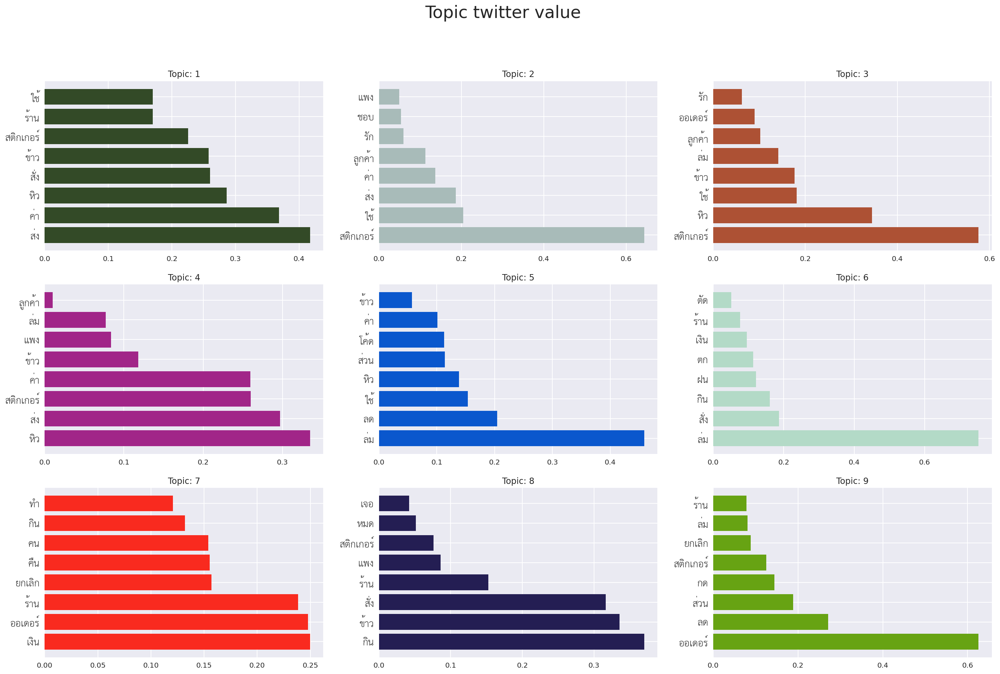

In [ ]:
# Plot values
# Define font family
axsTickFont = {'family': 'TH Sarabun New',
               'size': 20}

with plt.style.context('seaborn'):
  fig, axs = plt.subplots(int(nTopics / 3), 3, figsize = (24, 15))
  fig.suptitle('Topic twitter value')
  axs = axs.ravel()

  for i in range(nTopics):
    data = topicWords.query('Topic == @i + 1')
    value = data['Value']
    word = data['Word']
    position = np.arange(data.shape[0])
    axs[i].set_title(f'Topic: {i + 1}')
    axs[i].barh(position, value, color = np.random.rand(3))
    axs[i].set_yticks(position) #To set ticks based on number of labels
    axs[i].set_yticklabels(list(word), **axsTickFont) #**kwargs for Thai font option
plt.savefig('wordValues.png')
plt.show()

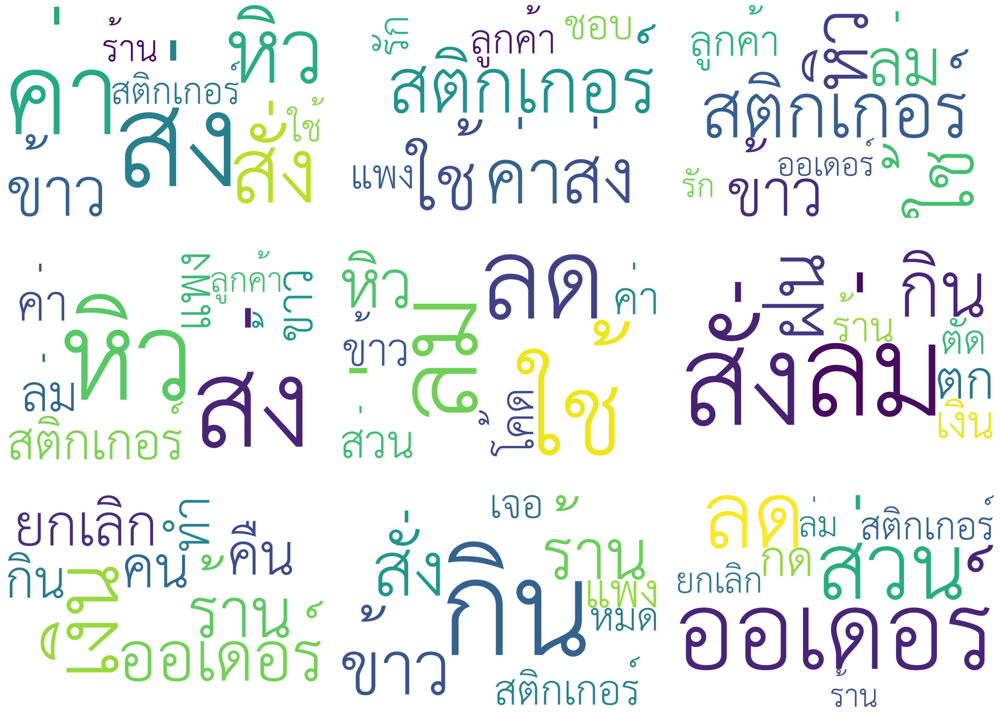

In [ ]:
# Define function word cloud
def plotWord(data):
  wordcloud = WordCloud(font_path = 'THSarabunNew.ttf',
                        width = 1200,
                        height = 800,
                        background_color = 'white',
                        regexp = r'[ก-๙]+').generate_from_text(' '.join(data))
  return wordcloud
  
# Plot word cloud
fig = plt.figure(figsize = (20, 15))

for i in range(nTopics):
  data = topicWords.query('Topic == @i + 1')['Word'] #Extract only word
  ax = fig.add_subplot(int(nTopics / 3), 3, i + 1)
  wordcloud = plotWord(data)
  ax.imshow(wordcloud)
  ax.axis('off')
fig.tight_layout()
fig.savefig('wordPlot.png')